In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import scipy as sp
from scipy import stats
import glob
import os
import math
from matplotlib.lines import Line2D
import matplotlib.patches as mpatches

import scanpy as sc
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import anndata as ad
import numpy as np
import scipy as sp
import umap
import umap.umap_ 
from scipy import stats
#import pegasus as pg
import glob
import os
from pvalannot import pvalannot

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/Library/Frameworks/Python.framework/V

In [3]:
pg.__version__

'1.8.1'

In [5]:
sc.__version__

'1.9.3'

In [18]:
## Process meta data

In [3]:
metaInfo = pd.read_excel("merged_metadata.xlsx")
metaInfo["patient"] = metaInfo["patient"].astype(str)

tmpDf = pd.read_excel("../data/Ran_MCL patient list_5.14.2024.xlsx")
tmpDf["MRN"] = tmpDf["MRN"].astype(str)
tmpDf = tmpDf[["Ran Patient ID", "MRN"]].rename({"Ran Patient ID":"MCL"}, axis=1)
tmpDf2 = pd.DataFrame({"MCL":["HD1", "HD2", "HD3"],
                      "MRN":["PBMC13", "PBMC16", "PBMC17"]})
tmpDf = pd.concat([tmpDf, tmpDf2])
metaInfo = metaInfo.merge(right=tmpDf, left_on="patient", right_on="MRN").drop("MRN", axis=1) 

In [4]:
mrnToMcl = {}
for i, r in tmpDf.iterrows():
    mrnToMcl[r["MRN"]] = r["MCL"]

In [348]:
colors = sns.color_palette("colorblind", 10)
reducedTimeColors = [colors[3], colors[0], colors[1], colors[2]] # pre, M1-3,M4-, normal

In [349]:
reducedTimeColorMap = {}
for i,name in enumerate(["pre", "M1-3", "M4-", "normal"]):
    reducedTimeColorMap[name] = reducedTimeColors[i]

In [272]:
reducedColorMap

{'pre': (0.8352941176470589, 0.3686274509803922, 0.0),
 'M1-3': (0.00392156862745098, 0.45098039215686275, 0.6980392156862745),
 'M4-': (0.9882352941176471, 0.9019607843137255, 0.12941176470588237),
 'normal': (0.00784313725490196, 0.6196078431372549, 0.45098039215686275)}

## Pilot study: Pickseq vs sortseq

In [2]:
pilotDf = pd.read_csv("../Pickseq_202204_with Siobhan/data/pickseq_sortseq_202204/tximport-counts.csv")
pilotDf = pilotDf.set_index("gene")

In [3]:
# Get the gene id->name conversion table
geneIdConversionDf = pd.read_csv("../data/cellranger_genes.tsv", sep="\t")
geneIdConversion = {}
for i, r in geneIdConversionDf.iterrows():
    geneIdConversion[r[0]] = r[1]
pilotDf.index = pilotDf.index.map(geneIdConversion)
pilotDf = pilotDf[ pd.notnull(pilotDf.index) ]

In [4]:
# Generate the anndata
pilotAdata = sc.AnnData(pilotDf.transpose())
pilotAdata.var_names_make_unique()
pilotAdata.obs["platform"] = pilotAdata.obs.index.str.split('_').str[3]
# Add metadata
#adata.obs = adata.obs.merge(metaInfo[["sample", "batch", "patient", "timepoint",
#                                     "picking", "cd19 expression"]], 
#                left_index=True, right_on="sample").set_index("sample")
#adata.obs.index.name = None

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/anndata/_core/anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


### QC measures

In [12]:
# Inspect mitochondria gene
pilotAdata.var['mt'] = pilotAdata.var_names.str.startswith('MT-')  
sc.pp.calculate_qc_metrics(pilotAdata, qc_vars=['mt'], 
                               percent_top=None, log1p=False, inplace=True)

In [12]:
pvalannot.AddPvalAnnot

<function pvalannot.pvalannot.AddPvalAnnot(x, y, data, pairs=None, ax=None, hue=None, func=None, order=None, hue_order=None, font_scale=1, fmt=None, fig=None, padjust_func=None, pair_test_key=None, significant_p=0.05, margin=None, styles=None, change_ylim=True, func_args=None)>

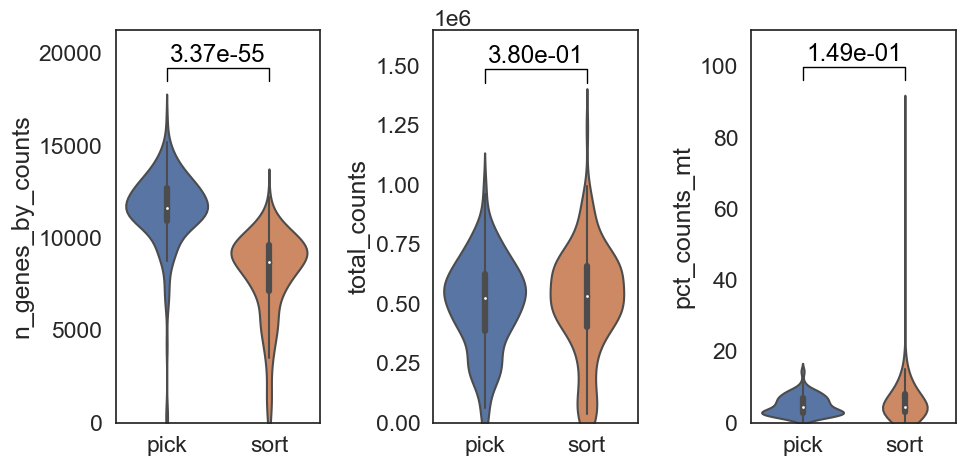

In [97]:
sns.set(style="white", font_scale=1.5)
fig, axes = plt.subplots(1, 3, figsize=(10, 5))
for i, feature in enumerate(["n_genes_by_counts", "total_counts", "pct_counts_mt"]):
    ax=sns.violinplot(y=feature, data=pilotAdata.obs, x="platform",
                     order=["pick", "sort"],
                     saturation=0.75, ax=axes[i])
    pvalannot.AddPvalAnnot(y=feature, data=pilotAdata.obs, x="platform",
                     order=["pick", "sort"], ax=ax,
                     margin=(ax.get_ylim()[1] - ax.get_ylim()[0])/10)
    ax.set(ylim=(0, ax.get_ylim()[1]), xlabel="")
    #plt.show()
    #plt.tight_layout()
plt.tight_layout()
plt.savefig("pilot/pilot_qc.pdf", format="pdf")
plt.show()


In [108]:
np.quantile(pilotAdata.obs[ pilotAdata.obs["platform"] == "pick" ]["n_genes_by_counts"], q=0.5)

11636.0

In [107]:
np.min(pilotAdata.obs[ pilotAdata.obs["platform"] == "pick" ]["n_genes_by_counts"])

64

### Unique genes identified in pickseq

In [5]:
pilotAdata.obs["platform"].value_counts()

platform
sort    288
pick    192
Name: count, dtype: int64

In [6]:
pickDf = pilotDf.filter(like="pick")
sortseqDf = pilotDf.filter(like="sort")

In [7]:
pickDf["pick_sum"] = pickDf.sum(axis=1)
sortseqDf["sort_sum"] = sortseqDf.sum(axis=1)

/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_2024/3164462087.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pickDf["pick_sum"] = pickDf.sum(axis=1)
/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_2024/3164462087.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sortseqDf["sort_sum"] = sortseqDf.sum(axis=1)


In [8]:
sumDf = pickDf[["pick_sum"]]
sumDf["sort_sum"] = sortseqDf["sort_sum"]

/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_2024/2698347488.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sumDf["sort_sum"] = sortseqDf["sort_sum"]


In [9]:
pickOnlyGenes = set(sumDf.loc[ (sumDf["pick_sum"] > 0) & (sumDf["sort_sum"]==0)].index)
sortOnlyGenes =  set(sumDf.loc[ (sumDf["pick_sum"] == 0) & (sumDf["sort_sum"]>0)].index)
bothGenes =  set(sumDf.loc[ (sumDf["pick_sum"] > 0) & (sumDf["sort_sum"]>0)].index)

In [51]:
from matplotlib_venn import venn2

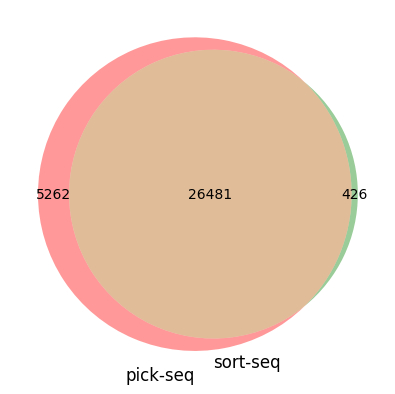

In [54]:
ax=venn2(subsets = (len(pickOnlyGenes), len(sortOnlyGenes), len(bothGenes)),
     set_labels= ("pick-seq", "sort-seq"))
plt.savefig("pilot/pilot_picksort_gene_venn.pdf", format="pdf")

In [10]:
cases = [pilotAdata.var.index.isin(pickOnlyGenes),
    pilotAdata.var.index.isin(sortOnlyGenes),
    pilotAdata.var.index.isin(bothGenes)]
pilotAdata.var["picksort"] = np.select(cases, ["pick-seq-only", "sort-seq-only", "both"], default=-1)

In [65]:
def hollowboxplot(data, x=None, y=None, hue=None, palette=None, ax=None, color=None, 
                  order=None, hue_order=None, jitter=True):
    snsFig = sns.boxplot(x=x, y=y, hue=hue, data=data, hue_order=hue_order, order=order,
                         showfliers = False, palette=palette, ax=ax)
    for i,box in enumerate([p for p in snsFig.patches if not p.get_label()]): 
        color = box.get_facecolor()
        box.set_edgecolor(color)
        box.set_facecolor('white')
        # iterate over whiskers and median lines
        for j in range(5*i,5*(i+1)):
             snsFig.lines[j].set_color(color)
    if (hue):
        snsFig = sns.stripplot(x=x, y=y, hue=hue, data=data, hue_order=hue_order, order=order,
                             jitter=jitter, dodge=True, palette=palette, ax=snsFig)
    else:
        snsFig = sns.stripplot(x=x, y=y, hue=x, data=data, hue_order=hue_order, order=order,
                             jitter=jitter, dodge=False, palette=palette, ax=snsFig)
    return snsFig

In [22]:
pilotAdata.var["effective_mean_counts"] = pilotAdata.var["total_counts"] / pilotAdata.var["n_cells_by_counts"]

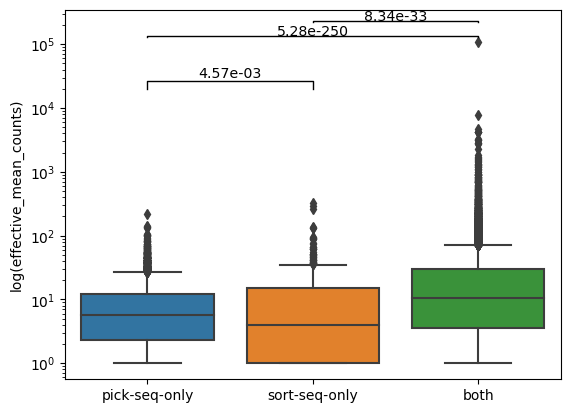

In [26]:
ax=sns.boxplot(y="effective_mean_counts", data=pilotAdata.var, x="picksort",
            order=["pick-seq-only", "sort-seq-only", "both"])
ax.set(yscale="log", xlabel="", ylabel="log(effective_mean_counts)")

pvalannot.AddPvalAnnot(y="effective_mean_counts", data=pilotAdata.var, x="picksort",
                 order=["pick-seq-only", "sort-seq-only", "both"], ax=ax,
                 margin=(ax.get_ylim()[1] - ax.get_ylim()[0])/10)
plt.savefig("pilot/pilot_picksort_gene_expr_effective_mean_count.pdf", format="pdf")

#pvalannot.AddPvalAnnot(y=feature, data=pilotAdata.obs, x="platform",
#                 order=["pick", "sort"],
#                 margin=(ax.get_ylim()[1] - ax.get_ylim()[0])/10)
#ax.set(ylim=(0, ax.get_ylim()[1]), xlabel="")

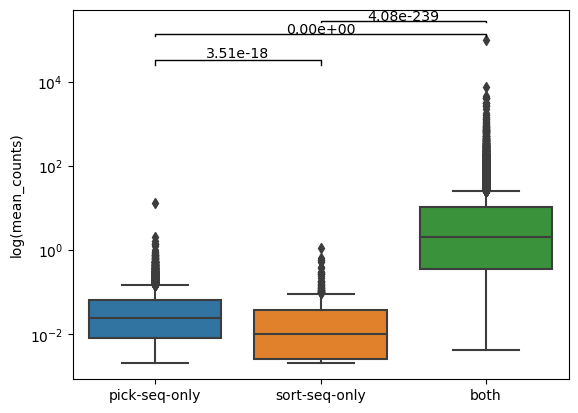

In [25]:
ax=sns.boxplot(y="mean_counts", data=pilotAdata.var, x="picksort",
            order=["pick-seq-only", "sort-seq-only", "both"])
ax.set(yscale="log", xlabel="", ylabel="log(mean_counts)")

pvalannot.AddPvalAnnot(y="mean_counts", data=pilotAdata.var, x="picksort",
                 order=["pick-seq-only", "sort-seq-only", "both"], ax=ax,
                 margin=(ax.get_ylim()[1] - ax.get_ylim()[0])/10)
plt.savefig("pilot/pilot_picksort_gene_expr_mean_count.pdf", format="pdf")

#pvalannot.AddPvalAnnot(y=feature, data=pilotAdata.obs, x="platform",
#                 order=["pick", "sort"],
#                 margin=(ax.get_ylim()[1] - ax.get_ylim()[0])/10)
#ax.set(ylim=(0, ax.get_ylim()[1]), xlabel="")

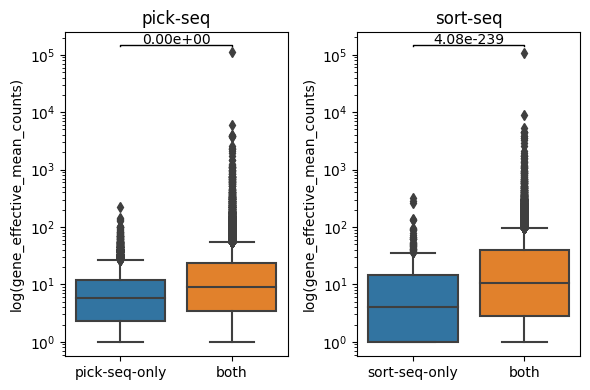

In [92]:
fig, axes = plt.subplots(1,2, figsize=(6,4))
for i,platform in enumerate(["pick", "sort"]):
    subAdata = pilotAdata[ pilotAdata.obs["platform"] == platform, :]
    dropColumns = list(subAdata.var.columns)
    dropColumns.remove("picksort")
    subAdata.var = subAdata.var.drop(dropColumns, axis=1)
    sc.pp.calculate_qc_metrics(subAdata, 
                        percent_top=None, log1p=False, inplace=True)
    subAdata.var["effective_mean_counts"] = subAdata.var["total_counts"] / subAdata.var["n_cells_by_counts"]
    ax=sns.boxplot(y="effective_mean_counts", data=subAdata.var, x="picksort",
            order=[f"{platform}-seq-only", "both"], ax=axes[i])
    ax.set(title=f"{platform}-seq", yscale="log", xlabel="", ylabel="log(gene_effective_mean_counts)") 
    pvalannot.AddPvalAnnot(y="mean_counts", data=pilotAdata.var, x="picksort",
            order=[f"{platform}-seq-only", "both"], ax=ax,
            margin=(ax.get_ylim()[1] - ax.get_ylim()[0])/5)
    
plt.tight_layout()
plt.savefig("pilot/pilot_picksort_gene_expr_effective_mean_count.pdf", format="pdf")

In [46]:
sc.pp.calculate_qc_metrics(subAdata, 
                        percent_top=None, log1p=False, inplace=True)

In [71]:
subAdata.var.groupby("picksort")["effective_mean_counts"].median()

picksort
-1               2.940494
both             4.652929
pick-seq-only    0.000000
sort-seq-only    4.000000
Name: effective_mean_counts, dtype: float64

In [112]:
pickAdata = pilotAdata[ pilotAdata.obs["platform"] == "pick"]
sortAdata = pilotAdata[ pilotAdata.obs["platform"] == "sort"]

In [118]:
sc.pp.calculate_qc_metrics(pickAdata, 
                               percent_top=None, log1p=False, inplace=True)
sc.pp.calculate_qc_metrics(sortAdata, 
                               percent_top=None, log1p=False, inplace=True)

In [126]:
avgDf = pd.concat([pickAdata.var[["mean_counts"]], sortAdata.var[["mean_counts"]]],
                  axis=1)
avgDf.columns = ["pick_mean_counts", "sort_mean_counts"]

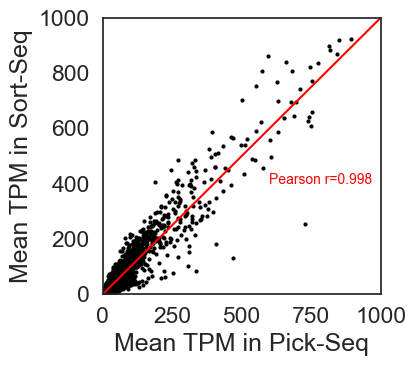

In [183]:
#ax = sns.scatterplot(data=avgDf, x="pick_mean_counts", y="sort_mean_counts")
plt.figure(figsize=(4.5,4))
ax = plt.gca()
ax.scatter(x=avgDf["pick_mean_counts"], y=avgDf["sort_mean_counts"],
          color="black", s=4, rasterized=True)
ax.plot([0, 1000], [0, 1000], color="red")
r = sp.stats.pearsonr(x=avgDf["pick_mean_counts"],
                y=avgDf["sort_mean_counts"])[0]
ax.text(x=600, y=400, s="Pearson r=%.3lf"%r, color="red",
       size=10)
ax.set(xlim=[0,1000], ylim=[0,1000], xlabel="Mean TPM in Pick-Seq", ylabel="Mean TPM in Sort-Seq")
plt.tight_layout()
plt.savefig("pilot/pilot_picksort_gene_expr_correlation.pdf", format="pdf",
           bbox_inches="tight", dpi=300)

In [139]:
np.quantile(pilotAdata.var["mean_counts"],q=0.99)

137.20000000000007

In [133]:
avgDf[ avgDf["pick_mean_counts"]>=10000]

,pick_mean_counts,sort_mean_counts
gene,,
C11orf58,108273.8125,99333.291667


## Patient survival display

In [139]:
survivalDf = pd.read_excel("../data/Ran_MCL patient list_9.17.2024.xlsx").dropna(how="all")

In [259]:
survivalDf["forsort"] = survivalDf[["Days of ongoing remission", "Day of Death"]].max(axis=1)
survivalDf = survivalDf.sort_values(by="forsort", ascending=False)

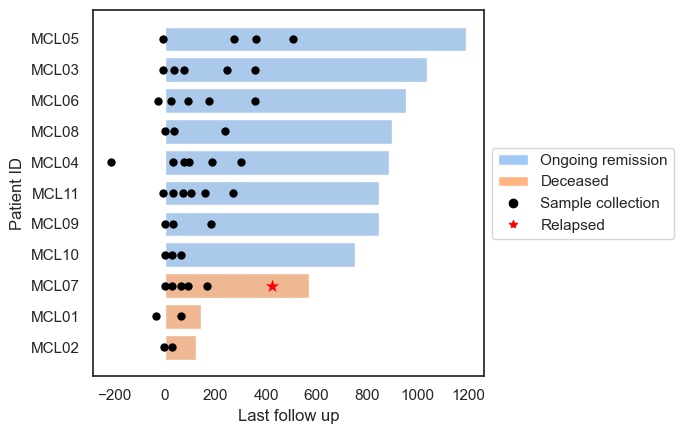

In [261]:
fig = plt.figure(figsize=(7, 4.5) )
sns.set(font_scale=1, style="white")
labels = ["Ongoing remission", "Deceased"]
#colors = [sns.color_palette("Paired")[0],sns.color_palette("Paired")[4]]
colors = sns.color_palette("pastel")
orders = []
ax = sns.barplot(x="Days of ongoing remission", y="Ran Patient ID", data=survivalDf, color=colors[0])
ax = sns.barplot(x="Day of Death", y="Ran Patient ID", data=survivalDf, color=colors[1])
for i in range(1, 7):
    ax = sns.scatterplot(x="Day of sample%d collection"%i, y = "Ran Patient ID", data = survivalDf, color="black",
                        linewidth=0)
ax = sns.scatterplot(x = "Days of relapse", y = "Ran Patient ID", data = survivalDf, color="red", 
                     markers="*", style="Days of relapse", size="Days of relapse", sizes=[100],
                    linewidth=0)

legend_elements = []
for i in range(len(labels)):
    legend_elements.append(mpatches.Patch(facecolor=colors[i], label=labels[i]))
legend_elements.append(Line2D([0], [0], marker='o', linestyle='',
                       color = "black", label="Sample collection"))
legend_elements.append(Line2D([0], [0], marker='*', linestyle='',
                       color = "red", label="Relapsed"))
ax.legend(handles = legend_elements, loc="center left", 
                 bbox_to_anchor = (1, 0.5))

ax.set(xlabel="Last follow up", ylabel="Patient ID")

plt.tight_layout()
plt.savefig("sample_collection.pdf", format="pdf")


In [98]:
sc.__version__

'1.9.3'

In [29]:
metaInfo["patient"]

0       PBMC13
1       PBMC13
2       PBMC13
3       PBMC13
4       PBMC13
         ...  
1829    895557
1830    895557
1831    895557
1832    895557
1833    895557
Name: patient, Length: 1834, dtype: object

In [20]:
tmpDf2

,MCL,MRN
0,PBMC13,PBMC13
1,PBMC16,PBMC16
2,PBMC17,PBMC17


In [129]:
metaInfo.to_csv("merged_metadata.csv")

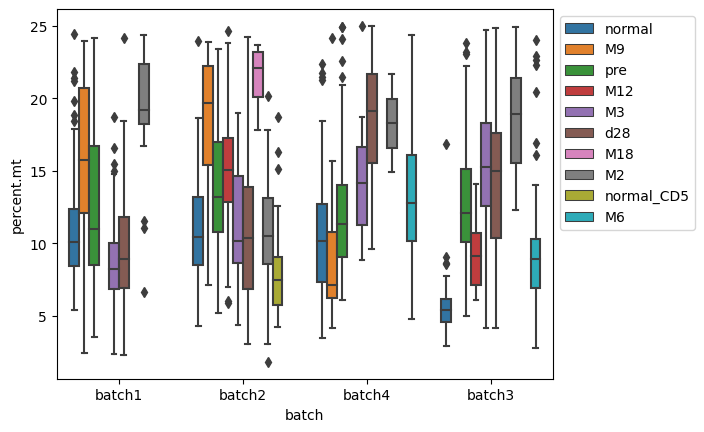

In [27]:
y="percent.mt" 
ax = sns.boxplot(x="batch", y=y, hue="timepoint", data=metaInfo)
ax.legend(loc="upper left", bbox_to_anchor=(1, 1, 0 , 0))

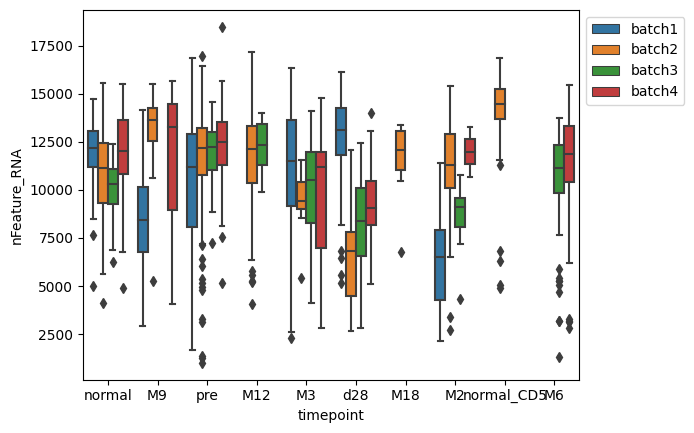

In [35]:
y="nFeature_RNA" 
ax = sns.boxplot(x="timepoint", y=y, hue="batch", data=metaInfo, 
                 hue_order=["batch1", "batch2","batch3", "batch4"])
ax.legend(loc="upper left", bbox_to_anchor=(1, 1, 0 , 0))

## MultiQC (FastQC on FASTQ files)

In [3]:
multiQcSummary = pd.read_csv("multiqc_out/general_stats_table.tsv", sep="\t")

In [8]:
multiQcSummary["batch"] = multiQcSummary["Sample"].str.split("_").str[0]
multiQcSummary["read"] = multiQcSummary["Sample"].str.split("_").str[-2]

In [16]:
multiQcSummary

,Sample,% Duplicate Reads,Average % GC Content,Average Sequence Length (bp),Percentage of modules failed in FastQC report (includes those not plotted here),Total Sequences (millions),batch,read
0,20230410_1039747_d28_A02_RX11003_S290_R1_001,56.335993,42,35,18.181818,0.765445,20230410,R1
1,20230531_Normal_B_PBMC17_C11_RX11153_S419_R2_001,20.276158,46,35,9.090909,0.818931,20230531,R2
2,20220421_DFBL_13045_pick_A06_RX9836_S198_R1_001,31.233087,46,35,9.090909,0.871100,20220421,R1
3,20221026_NormalB_PBMC16_E12_RX10465_S60_R1_001,33.401065,46,35,9.090909,1.040278,20221026,R1
4,20230531_895557_pre_F06_RX11153_S258_R1_001,40.750958,47,35,9.090909,1.347959,20230531,R1
...,...,...,...,...,...,...,...,...
4597,20230227_S344_RX10846_S344_R1_001,3.420222,46,35,27.272727,0.043389,20230227,R1
4598,20230531_895557_M9_G07_RX11153_S463_R2_001,15.212705,43,35,9.090909,0.792577,20230531,R2
4599,20230227_S201_RX10846_S201_R2_001,47.716058,52,35,9.090909,1.286066,20230227,R2
4600,20221026_NormalB_PBMC16_F04_RX10465_S64_R1_001,21.024963,43,35,9.090909,0.775261,20221026,R1


<AxesSubplot: xlabel='batch', ylabel='Percentage of modules failed in FastQC report (includes those not plotted here)'>

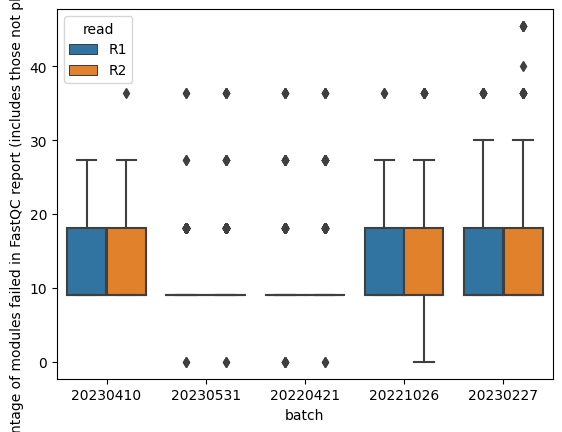

In [9]:
y="Percentage of modules failed in FastQC report (includes those not plotted here)" 
sns.boxplot(x="batch", y=y, hue="read", data=multiQcSummary)

<AxesSubplot: xlabel='batch', ylabel='% Duplicate Reads'>

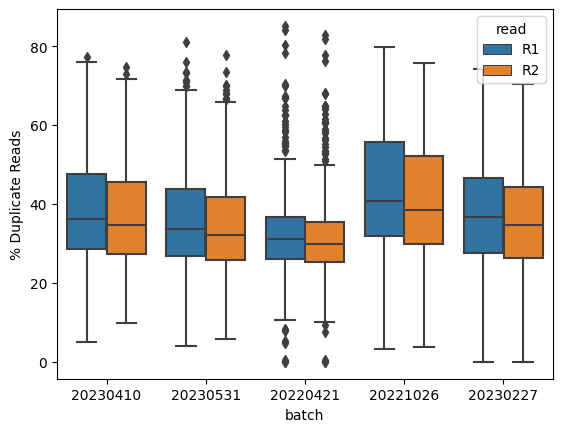

In [10]:
y="% Duplicate Reads" 
sns.boxplot(x="batch", y=y, hue="read", data=multiQcSummary)

<AxesSubplot: xlabel='batch', ylabel='Total Sequences (millions)'>

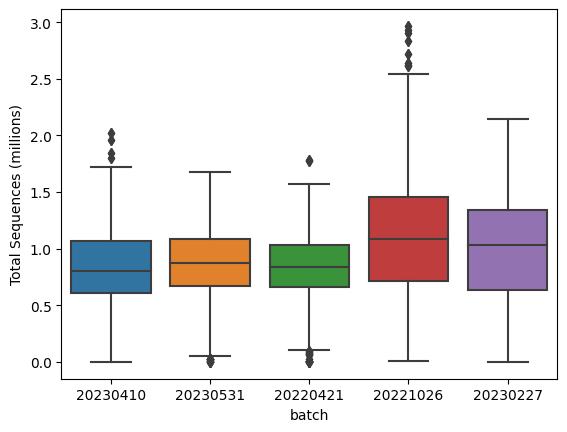

In [12]:
y="Total Sequences (millions)" 
sns.boxplot(x="batch", y=y, data=multiQcSummary)

<AxesSubplot: xlabel='batch', ylabel='Average % GC Content'>

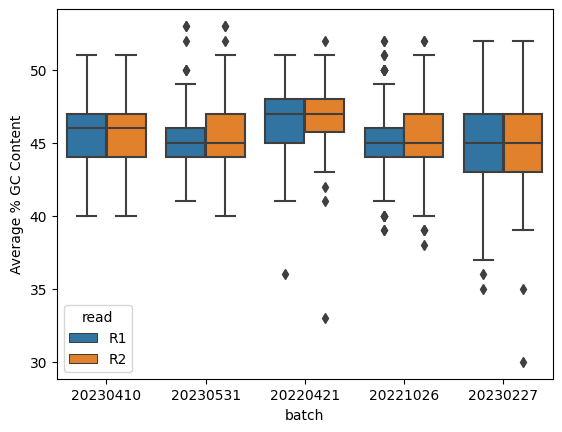

In [14]:
y="Average % GC Content" 
sns.boxplot(x="batch", y=y, hue="read", data=multiQcSummary)

## TRUST4_smart-seq analysis

In [156]:
trust4Airr = pd.read_csv("pickseq_smartseq_airr_wmeta.tsv", sep="\t", keep_default_na=False)
#metaInfo = pd.read_csv("merged_metadata.csv")

In [4]:
trust4Airr

,sequence_id,sequence,rev_comp,productive,v_call,d_call,j_call,c_call,sequence_alignment,germline_alignment,...,v_cigar,d_cigar,j_cigar,v_identity,j_identity,cell_id,complete_vdj,consensus_count,cell,meta
0,batch1_753528_M3_E06_RX10465_S246_R1_001_assem...,GGTGGAGGCAGTGGTGAGCCAGGAAATGTTTAGGACGTAGAATCCT...,F,T,IGLV4-60*01,,,,,,...,67S249N7M6D11M217S30N,,,80.95,,,F,51,batch1_S246,753528_M3
1,batch1_753528_pre_A02_RX10465_S98_R1_001_assem...,AGCAACCACCAAGTGGAGAATTGGTTTTCCTTATTCGTCGGAACTC...,F,T,TRAV19*01,,TRAJ4*01,TRAC,AGCAACCACCAAGTGGAGAATTGGTTTTCCTTATTCGTCGGAACTC...,AGCAACCACCAAGTGGAGAATTGGTTTTCCTTATTCGTCGGAACTC...,...,112N178M293S,,179S5N58M234S,100.00,100.00,,F,84,batch1_S98,753528_pre
2,batch1_753528_pre_A02_RX10465_S98_R1_001_assem...,CCCCAAAGCACCTGATCACAGCAACTGGACAGCGAGTGACGCTGAG...,F,T,TRBV9*01,,TRBJ2-1*01,,CCCCAAAGCACCTGATCACAGCAACTGGACAGCGAGTGACGCTGAG...,CCCCAAAGCACCTGATCACAGCAACTGGACAGCGAGTGACGCTGAG...,...,19N267M40S,,280S27M23N,100.00,100.00,,F,53,batch1_S98,753528_pre
3,batch1_753528_pre_A03_RX10465_S99_R1_001_assem...,TTGTAATGGAGAAGAGAGAGCAAAAGGAAACATTCTTGAACGATTC...,F,T,TRBV9*01,TRBD1*01,TRBJ2-7*01,TRBC2,TTGTAATGGAGAAGAGAGAGCAAAAGGAAACATTCTTGAACGATTC...,TTATAATGGAGAAGAGAGAGCAAAAGGAAACATTCTTGAACGATTC...,...,146N136M295S4N,140S7M284S5N,154S1N46M231S,99.26,100.00,,F,208,batch1_S99,753528_pre
4,batch1_753528_pre_A03_RX10465_S99_R1_001_assem...,GGAGCAGAGTCCTCAGAACCTGACTGCCCAGGAAGAAGCATGGAAG...,F,T,TRAV41*01,,TRAJ42*01,TRAC,G---GAAGAAGCATGGAAGATTAATTGCCACAATAAACATACAGGA...,GGAAGAAGAAGCATGGAAGATTAATTGCCACAATAAACATACAGGA...,...,30S154N1M3I110M283S2N,,151S4N62M211S,98.67,100.00,,F,75,batch1_S99,753528_pre
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1507,batch4_Normal_B_PBMC17_D09_RX11153_S429_R1_001...,AGCTACTGGATGCACTGGGTCCGCCAAGCTCCAGGGAAGGGGCTGG...,F,T,IGHV3-74*01,IGHD1-26*01,IGHJ5*02,IGHM,AGCTACTGGATGCACTGGGTCCGCCAAGCTCCAGGGAAGGGGCTGG...,AGCTACTGGATGCACTGGGTCCGCCAAGCTCCAGGGAAGGGGCTGG...,...,90N203M102S3N,212S5N11M82S4N,226S3N48M31S,100.00,100.00,,F,52,batch4_S429,PBMC17_normal
1508,batch4_Normal_B_PBMC17_D10_RX11153_S430_R1_001...,GATCAGCACTGAACACAGAGGACTCACCATGGAGTCTGGGGGAGGC...,F,T,IGHV3-30*18,IGHD6-13*01,IGHJ4*02,IGHM,TGGAGTCTGGGGGAGGCGTGGTCCAGCCTGGGAGGTCCCTGAGACT...,TGGAGTCTGGGGGAGGCGTGGTCCAGCCTGGGAGGTCCCTGAGACT...,...,29S13N282M102S1N,317S6N15M81S,334S5N43M36S,100.00,100.00,,F,201,batch4_S430,PBMC17_normal
1509,batch4_Normal_B_PBMC17_D10_RX11153_S430_R1_001...,TTTGTGCAGGAGTCAGACCCAGTCAGGACACAGCATGGACATGAGG...,F,T,IGKV1-12*01,,IGKJ4*01,IGKC,GACATCCAGATGACCCAGTCTCCATCTTCCGTGTCTGCATCTGTAG...,GACATCCAGATGACCCAGTCTCCATCTTCCGTGTCTGCATCTGTAG...,...,100S284M272S3N,,385S1N37M234S,100.00,100.00,,T,65,batch4_S430,PBMC17_normal
1510,batch4_Normal_B_PBMC17_D11_RX11153_S431_R1_001...,AAGAACCTGCCCAGCCTGGGCCTCAGGAAGCAGCATCGGAGGTGCC...,F,T,IGLV3-1*01,,IGLJ2*01,IGLC2,TCCTATGAGCTGACTCAGCCACCCTCAGTGTCCGTGTCCCCAGGAC...,TCCTATGAGCTGACTCAGCCACCCTCAGTGTCCGTGTCCCCAGGAC...,...,109S280M69S5N,,390S38M30S,100.00,100.00,,T,123,batch4_S431,PBMC17_normal


In [158]:
sampleCellCount = {}
for i, row in metaInfo.iterrows():
    sample = row["patient"] + "_" + row["timepoint"]
    if (sample not in sampleCellCount):
        sampleCellCount[sample] = 0 
    sampleCellCount[sample] += 1

In [149]:
sampleCellCount["966723_pre"]

43

## Calculate the clonality for each sample (sampleid+timepoint)

In [153]:
def GetChainType( v, j, c ):
    s = ""
    if ( v != "*" and v != "" ):
        s = v 
    elif ( j != "*" and v != ""):
        s = j
    elif ( c != "*" and v != ""):
        s = c
    else:
        return -1

    if ( s[0:3] == "IGH" ):
        return 0
    elif ( s[0:3] == "IGK" ):
        return 1
    elif ( s[0:3] == "IGL" ):
        return 1 
    elif ( s[0:3] == "TRA" ):
        return 3
    elif ( s[0:3] == "TRB" ):
        return 4
    elif ( s[0:3] == "TRG" ):
        return 5
    elif ( s[0:3] == "TRD" ):
        return 6
    
    return -1 

def GetGeneType( s ):
    if ( s[3] == "V" ):
        return 0 
    elif ( s[3] == "J" ):
        return 2
    elif (s[3] == "D"):
        if (len(s) == 4):
            return 3
        else:
            return 1
    elif ( s[3] == "-" ):
        return -1
    else:
        return 3
    
chainTypeToName = ("IGH", "IGK", "IGL", "TRA", "TRB", "TRG", "TRD" )
geneTypeToName = ("V", "J", "C" )

def GetMainGeneName( g ): # remove the allele type from the gene name
    fields = g.split( "*", 1 )
    return fields[0]

In [154]:
# Check the diversity change between filtered and not filtered samples
def ComputeEntropy(rep):
    if (len(rep) == 0):
        return 0
    total = sum(list(rep.values()))
    return sum([-x/total*math.log(x/total) for x in rep.values()])

def ComputeClonality(rep):
    if (len(rep) < 1):
        return 0
    if (len(rep) == 1):
        if (sum(list(rep.values())) >= 10):
            return 1
        else:
            return 0
    ret = 1 - ComputeEntropy(rep) / math.log(len(rep))
    if (ret < 1e-8):
        ret = 0
    return ret

def ComputeRichness(rep):
    return len(rep)

def ConvertToClonotypeFrequency(barcodeList):
    barcodeFreq = {}
    for barcode in barcodeList:
        if (barcode not in barcodeFreq):
            barcodeFreq[barcode] = 0
        barcodeFreq[barcode] += 1
    return barcodeFreq

def ParseCigar(cigar):
    cigarFields = re.findall("\d+\w", cigar)
    ret = []
    for f in cigarFields:
        ret.append( (int(f[0:-1]), f[-1]) )
    return ret

In [159]:
sampleCDR3 = {}
patientInfo = {}
cellType = {}
sampleToCells = {}
for i, row in trust4Airr.loc[trust4Airr.productive == 'T'].iterrows():
    sample = row["meta"]
    if (sample not in sampleCDR3):
        sampleCDR3[sample] = [[], [], [], [], [], [], []]
        sampleToCells[sample] = []
    chainType = GetChainType(row["v_call"], row["j_call"], row["c_call"])
    if (chainType <= 2):
        cellType[ row["cell"] ] = "B"
    else:
        cellType[ row["cell"] ] = "T"
    sampleCDR3[sample][chainType].append(row["junction"])
    sampleToCells[sample].append( row["cell"])
    patient = row["meta"].split("_")[0]
    if (patient not in patientInfo):
        patientInfo[patient] = {}
    patientInfo[patient][ row["meta"].split("_")[1] ] = 1 
    
for sample in sampleCellCount:
    if (sample not in sampleCDR3):
        sampleCDR3[sample] = [[], [], [], [], [], [], []]
        sampleToCells[sample] = []
        patient = sample.split("_")[0]
        if (patient not in patientInfo):
            patientInfo[patient] = {}
        patientInfo[patient][ sample.split("_")[1] ] = 1 

In [160]:
patientInfo

{'753528': {'M3': 1, 'pre': 1, 'M12': 1, 'd28': 1, 'M9': 1},
 '923252': {'d28': 1, 'pre': 1},
 'PBMC13': {'normal': 1},
 'PBMC16': {'normal': 1},
 '687648': {'pre': 1, 'd28': 1, 'M2': 1, 'M3': 1},
 '767639': {'pre': 1, 'M12': 1, 'M18': 1, 'M9': 1},
 '1039747': {'d28': 1, 'M6': 1, 'pre': 1, 'M2': 1, 'M3': 1},
 '670730': {'d28': 1, 'M12': 1, 'M6': 1, 'pre': 1, 'M3': 1},
 'PBMC17': {'normal': 1},
 '1046105': {'M6': 1, 'd28': 1, 'pre': 1},
 '693381': {'pre': 1, 'd28': 1, 'M6': 1},
 '895557': {'d28': 1, 'M3': 1, 'M6': 1, 'M9': 1, 'pre': 1, 'M2': 1},
 '957884': {'pre': 1, 'd28': 1, 'M2': 1},
 '966723': {'pre': 1, 'M2': 1}}

In [161]:
chain = 0
sampleDiversity = {}
for sample in sampleCDR3:
    #if (len(sampleCDR3[sample][chain]) < 5):
    #    continue 
    rep = ConvertToClonotypeFrequency(sampleCDR3[sample][chain])
    tcrAbund = 0
    for c in sampleToCells[sample]:
        if (cellType[c] != 'B'):
            tcrAbund += 1
    sampleDiversity[sample] = {
        "entropy": ComputeEntropy(rep),
        "clonality": ComputeClonality(rep),
        "abundance": sum(list(rep.values())),
        "richness": ComputeRichness(rep),
        "igh_recall" if (chain == 0) else "iglk_recall": sum(list(rep.values())) / sampleCellCount[sample], 
        "tcr_abund": tcrAbund,
        "tcr_recall": tcrAbund / sampleCellCount[sample],
        "cell_count": sampleCellCount[sample]
        }
       

In [162]:
diversityList = ["entropy", "clonality", "abundance", "richness", 
                 "igh_recall" if (chain == 0) else "iglk_recall", "tcr_abund", "tcr_recall", "cell_count"]
samplev = []
mclv = []
timev = []
patientv = []
for sample in sampleDiversity:
    samplev.append(sample)
    subCols = sample.split("_")
    patient = mrnToMcl[subCols[0]]
    if (len(subCols) > 2):
        patient = patient + "_" + subCols[-1]
    #patientv.append(mrnToMcl[sample.split("_")[0]])
    patientv.append(patient)
    if ("PBMC" in sample):
        if ("CD5" in sample):
            timev.append("M3")
        else:
            timev.append("pre")        
    else:
        timev.append(sample.split("_")[1])
diversityDf = pd.DataFrame({"sample":samplev, "time":timev, "donor":patientv})
for diversity in diversityList:
    v = []
    for sample in sampleDiversity:
        v.append(sampleDiversity[sample][diversity])
    diversityDf[diversity] = v

In [163]:
diversityDf = diversityDf.replace('d28', 'M1')

In [164]:
# Add a column for reduced time point
reduceTimeMap = {}
for t in ["pre"]:
    reduceTimeMap[t] = "pre"
for t in ["M1", "M2", "M3"]:
    reduceTimeMap[t] = "M1-3"
for t in ["M6", "M9", "M12"]:
    reduceTimeMap[t] = "M4-"   
diversityDf["reduced_time"] = diversityDf["time"].map(reduceTimeMap)

In [165]:
diversityDf.to_csv("sample_diveresity.csv")

In [211]:
reduceTimeMap[diversityDf["time"].str.strip()[0]]

KeyError: 'M3'

In [166]:
diversityDf

,sample,time,donor,entropy,clonality,abundance,richness,igh_recall,tcr_abund,tcr_recall,cell_count,reduced_time
0,753528_M3,M3,MCL03,0.000000,0.000000,0,0,0.000000,0,0.000000,57,M1-3
1,753528_pre,pre,MCL03,0.000000,0.000000,0,0,0.000000,26,0.541667,48,pre
2,923252_d28,M1,MCL02,0.000000,0.000000,0,0,0.000000,3,0.130435,23,M1-3
3,PBMC13_normal,pre,HD1,3.784190,0.000000,44,44,0.586667,0,0.000000,75,pre
4,PBMC16_normal,pre,HD2,4.611382,0.000810,102,101,0.829268,0,0.000000,123,pre
5,687648_pre,pre,MCL04,0.099623,0.856274,49,2,0.844828,2,0.034483,58,pre
6,687648_d28,M1,MCL04,0.000000,0.000000,0,0,0.000000,2,0.047619,42,M1-3
7,767639_pre,pre,MCL05,2.944439,0.000000,19,19,0.395833,0,0.000000,48,pre
8,767639_M12,M12,MCL05,3.806662,0.000000,45,45,0.900000,0,0.000000,50,M4-
9,767639_M18,M18,MCL05,0.000000,0.000000,0,0,0.000000,1,0.045455,22,NaN


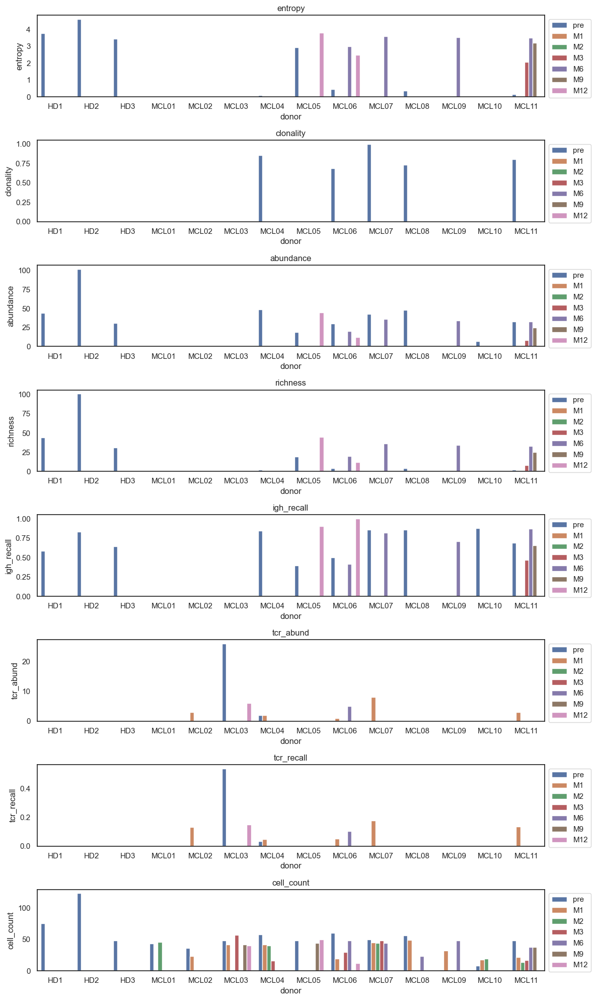

In [189]:
hueOrder = ["pre", "M1", "M2", "M3", "M6", "M9", "M12"]
xorder = [x for x in sorted(diversityDf["donor"].unique()) if '_' not in x]

fig, axes = plt.subplots(len(diversityList), 1, figsize=(12, 20) )
for i, diversity in enumerate(diversityList):
    ax = sns.barplot(x="donor", y=diversity, data=diversityDf, hue="time",
                    order = xorder, hue_order = hueOrder, ax=axes[i])
    ax.set(title=diversity)
    ax.legend(bbox_to_anchor=(1,1))
fig.tight_layout()
#plt.savefig("sample_diversity_chain"+str(chain)+".pdf", format="pdf")

In [329]:
diversityDf[ diversityDf["donor"] == "MCL06"]

,sample,time,donor,entropy,clonality,abundance,richness,igh_recall,tcr_abund,tcr_recall,cell_count,reduced_time
16,670730_d28,M1,MCL06,0.000000,0.000000,0,0,0.000000,1,0.052632,19,M1-3
17,670730_M12,M12,MCL06,2.484907,0.000000,12,12,1.000000,0,0.000000,12,M4-
18,670730_M6,M6,MCL06,2.995732,0.000000,20,20,0.416667,5,0.104167,48,M4-
19,670730_pre,pre,MCL06,0.434944,0.686254,30,4,0.500000,0,0.000000,60,pre
40,670730_M3,M3,MCL06,0.000000,0.000000,0,0,0.000000,0,0.000000,30,M1-3


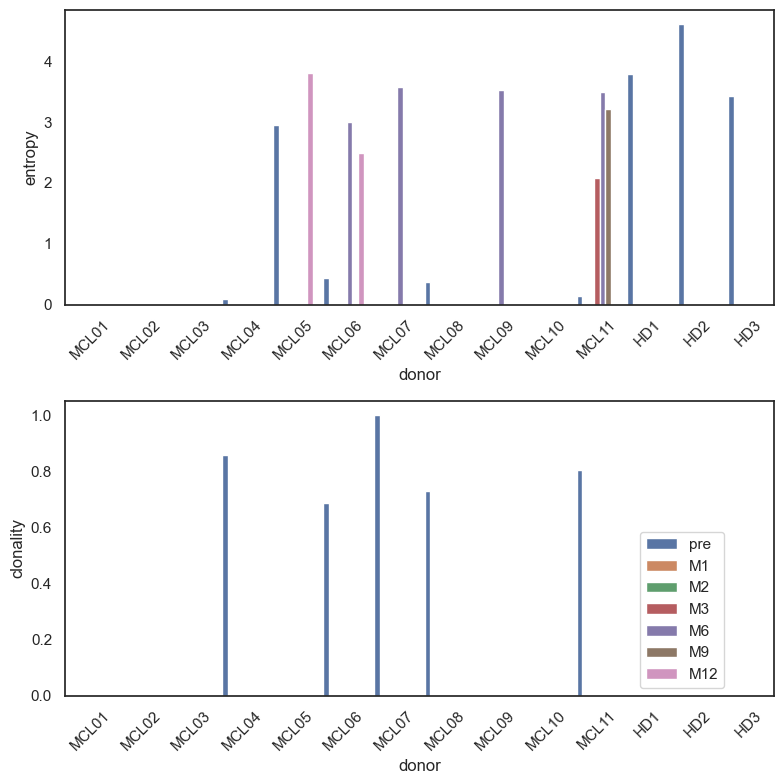

In [188]:
sns.set(style="white", font_scale=1)
hueOrder = ["pre", "M1", "M2", "M3", "M6", "M9", "M12"]
xorder = [x for x in sorted(diversityDf["donor"].unique()) if '_' not in x]
xorder = sorted(xorder, key = lambda x: 'Z' + x if (x.startswith('H')) else x)
fig, axes = plt.subplots(2, 1, figsize=(8, 8))
for i, diversity in enumerate(["entropy", "clonality"]):
    ax = sns.barplot(x="donor", y=diversity, data=diversityDf, hue="time",
                    order = xorder, hue_order = hueOrder, ax=axes[i])
    #ax.set(title=diversity)
    for label in ax.get_xticklabels():
        label.set_rotation(45)
    if (i != 1):
        ax.get_legend().remove()
    else:
        ax.legend(loc="lower left", bbox_to_anchor=[0.8,0])
fig.tight_layout()
#plt.savefig("sample_focused_diversity_chain"+str(chain)+".pdf", format="pdf")

In [232]:
diversityDf.groupby(["donor","reduced_time"])["clonality"].median().reset_index()

,donor,reduced_time,clonality
0,HD1,pre,0.000000
1,HD1_CD5,M1-3,0.000000
2,HD2,pre,0.000810
3,HD2_CD5,M1-3,0.000000
4,HD3,pre,0.000000
5,MCL01,M1-3,0.000000
6,MCL01,pre,0.000000
7,MCL02,M1-3,0.000000
8,MCL02,pre,0.000000
9,MCL02_normalB,pre,0.000000


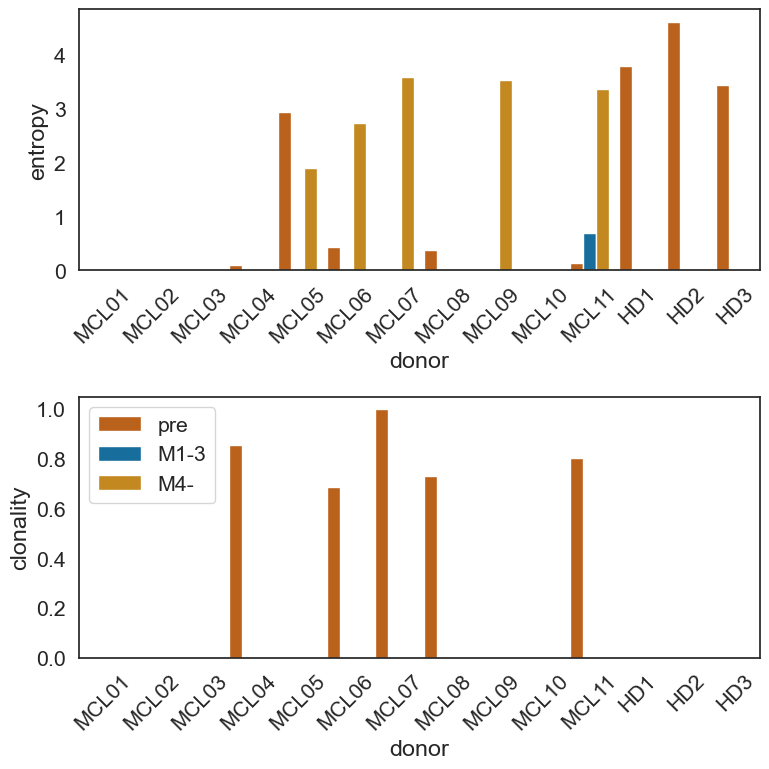

In [332]:
sns.set(style="white", font_scale=1.4)
hueOrder = ["pre", "M1-3", "M4-"]
xorder = [x for x in sorted(diversityDf["donor"].unique()) if '_' not in x]
xorder = sorted(xorder, key = lambda x: 'Z' + x if (x.startswith('H')) else x)
fig, axes = plt.subplots(2, 1, figsize=(8, 8))
colors = sns.color_palette("colorblind")[0:10]
colors = [colors[3], colors[0], [252/255,230/255,33/255], colors[2]]
for i, diversity in enumerate(["entropy", "clonality"]):
    groupDf = diversityDf.groupby(["donor","reduced_time"])[diversity].mean().reset_index()
    ax = sns.barplot(x="donor", y=diversity, data=groupDf, hue="reduced_time",
                    order = xorder, hue_order = hueOrder, ax=axes[i],
                    palette = reducedTimeColors)
    #ax.set(title=diversity)
    for label in ax.get_xticklabels():
        label.set_rotation(45)
    if (i != 1):
        ax.get_legend().remove()
    else:
        ax.legend()
        #ax.legend(loc="lower left", bbox_to_anchor=[0.8,0])
fig.tight_layout()
plt.savefig("sample_focused_diversity_chain"+str(chain)+"_reducedTime.pdf", format="pdf")

In [67]:
diversityDf[ diversityDf["donor"] == "MCL05"]

,sample,time,donor,entropy,clonality,abundance,richness,igh_recall,tcr_abund,tcr_recall,cell_count
7,767639_pre,pre,MCL05,2.944439,0.0,19,19,0.395833,0,0.000000,48
8,767639_M12,M12,MCL05,3.806662,0.0,45,45,0.900000,0,0.000000,50
9,767639_M18,M18,MCL05,0.000000,0.0,0,0,0.000000,1,0.045455,22
38,767639_M9,M9,MCL05,0.000000,0.0,0,0,0.000000,0,0.000000,44


### Shared BCR with pre

In [93]:
def SharedClonotypeDict(a, b):
    seta = set(a.keys()) 
    setb = set(b.keys())
    totalCnt = sum(a.values())
    if (totalCnt == 0):
        return 0
    ret = 0
    for c in seta.intersection(setb):
        ret += a[c] / totalCnt 
    return ret    

In [136]:
for patient in patientInfo:
    if ("PBMC" in patient):
        continue

    for i in range(len(hueOrder)):
        if (patient + "_" + hueOrder[i] not in sampleCDR3):
            continue
        preRep = ConvertToClonotypeFrequency(sampleCDR3[patient+"_"+hueOrder[i]][0])
        for j in range(i + 1, len(hueOrder)):
            #if (time == "pre"):
            #    continue
            key = patient+"_"+hueOrder[j]
            share = 0 
            if (key in sampleCDR3):
                postRep = ConvertToClonotypeFrequency(sampleCDR3[key][0])
                share = SharedClonotypeDict(postRep, preRep)
            print(patient, hueOrder[i], hueOrder[j], share)

753528 pre d28 0
753528 pre M3 0
753528 pre M6 0
753528 pre M9 0
753528 pre M12 0
753528 d28 M3 0
753528 d28 M6 0
753528 d28 M9 0
753528 d28 M12 0
753528 M3 M6 0
753528 M3 M9 0
753528 M3 M12 0
753528 M9 M12 0
923252 pre d28 0
923252 pre M3 0
923252 pre M6 0
923252 pre M9 0
923252 pre M12 0
923252 d28 M3 0
923252 d28 M6 0
923252 d28 M9 0
923252 d28 M12 0
687648 pre d28 0
687648 pre M3 0
687648 pre M6 0
687648 pre M9 0
687648 pre M12 0
687648 d28 M3 0
687648 d28 M6 0
687648 d28 M9 0
687648 d28 M12 0
687648 M3 M6 0
687648 M3 M9 0
687648 M3 M12 0
767639 pre d28 0
767639 pre M3 0
767639 pre M6 0
767639 pre M9 0
767639 pre M12 0
767639 M9 M12 0
1039747 pre d28 0
1039747 pre M3 0
1039747 pre M6 0
1039747 pre M9 0
1039747 pre M12 0
1039747 d28 M3 0
1039747 d28 M6 0
1039747 d28 M9 0
1039747 d28 M12 0
1039747 M3 M6 0
1039747 M3 M9 0
1039747 M3 M12 0
1039747 M6 M9 0
1039747 M6 M12 0
670730 pre d28 0
670730 pre M3 0
670730 pre M6 0
670730 pre M9 0
670730 pre M12 0
670730 d28 M3 0
670730 d28 M6 0
6

In [111]:
sampleCDR3["753528_pre"]

[[],
 [],
 [],
 ['TGTGCTCTGAGTGAGGCGTCTGGTGGCTACAATAAGCTGATTTTT',
  'TGTGCTGTCAACCCCAGGAGTTATGGAGGAAGCCAAGGAAATCTCATCTTT',
  'TGTGCTCTGAGTGAGGCGTCTGGTGGCTACAATAAGCTGATTTTT',
  'TGTGCAGCAAGCACTGTGAGGTACAGCAGTGCTTCCAAGATAATCTTT',
  'TGTGCAGGAGTAACCTCCTACGACAAGGTGATATTT',
  'TGTGCTCTGAGTGAGGCGTCTGGTGGCTACAATAAGCTGATTTTT',
  'TGCCTCGTGGGTGACTTCGGGTACAGCAGTGCTTCCAAGATAATCTTT',
  'TGTGCTTATAGGAGCCCTCAGGGCGGATCTGAAAAGCTGGTCTTT',
  'TGTGCTCTGAGTGAGGAGGGCGGATCTGAAAAGCTGGTCTTT',
  'TGTGCAGAGACTGAGGCAGGAACTGCTCTGATCTTT',
  'TGTGCTCTGAGTGAGGCGTCTGGTGGCTACAATAAGCTGATTTTT',
  'TGTGCAGGGGTTCAGGGAACCCAGAAGCTGGTATTT',
  'TGTGCTGTCAACCCCAGGAGTTATGGAGGAAGCCAAGGAAATCTCATCTTT'],
 ['TGTGCCAGCAGCGTAGAGGCCGGGCGGAGCTCCTACAATGAGCAGTTCTTC',
  'TGTGCCAGCAGCCCAAGGGACAGAACTGAATCCTACGAGCAGTACTTC',
  'TGTGCCAGCAGCGTAGAGGCCGGGCGGAGCTCCTACAATGAGCAGTTCTTC',
  'TGCGCCAGCAGCTCGGGCCCAGGGTTCGGGACTAGCGGGAAGATCAATGAGCAGTTCTTC',
  'TGTGCCAGTAGTATAGACCAGGTGGAGACCCAGTACTTC',
  'TGTGCCAGTAGTATATTAGAAAGCGGGGAAAAACTGTTTTTT',
  'TGT

In [103]:
sampleCDR3["895557_M3"][0]

['TGTGCTATCCGAGGGGTGGATACAGCTATGGAAATTGACTACTGG',
 'TGTGCGAGAGGCCTTATGGACGTCTGG',
 'TGTGCGAAAGATGACGGTGGTGGCTGGTCCCCTTTTGACTACTGG',
 'TGTGCGAGCGGGCCGGCCGAGGATGCTTTTGATATCTGG',
 'TGTGCGAGAGGGCGGGTGCACGGATACAGCTATGGTGACTACTGG',
 'TGTGCGAGAGATTCAACCCGATATTGTAGTGGTGGTAGCTGCTACCAGGGGGACTACTGG',
 'TGTGCGAGAGGGGGGGCCATTGTAGTAGTACCAGCTGCTATGATGGGGAACTGGTTCGACCCCTGG',
 'TGTGCGAGCAATACTATGGTTCGGGGAGTTATAGGAAGTGATCCATACTACTTTGACTACTGG']

## Single-cell RNA-seq analysis

In [5]:
import scanpy as sc
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import anndata as ad
import numpy as np
import scipy as sp
import umap
import umap.umap_ 
from scipy import stats
#import pegasus as pg
import glob
import os

In [6]:
pg.__version__

'1.8.0'

In [335]:
# Read the Adata
adata = sc.read_h5ad("SMART-seq/adata.h5ad")

In [455]:
clusterCnt = 7
clusterList = []
for i in range(clusterCnt):
    clusterList.append(str(i))

In [339]:
adata.obs

,batch,patient,timepoint,picking,cd19 expression,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden_1.0,raw_pateint,reduced_time
batch1_S1,batch1,HD1,normal,D,pos,9753,828690.973979,57756.243776,6.969576,0,PBMC13,normal
batch1_S10,batch1,HD1,normal,D,pos,10188,854050.840136,38392.017611,4.495285,0,PBMC13,normal
batch1_S100,batch1,MCL03,pre,S,pos,11248,827730.086682,53239.283250,6.431962,3,753528,pre
batch1_S101,batch1,MCL03,pre,D,pos,9026,908373.480852,41163.609974,4.531573,3,753528,pre
batch1_S102,batch1,MCL03,pre,D,pos,4738,889274.342253,34622.911165,3.893389,3,753528,pre
...,...,...,...,...,...,...,...,...,...,...,...,...
batch4_S95,batch4,MCL08,M1,D,pos,5706,828051.723576,153651.310291,18.555762,4,693381,M1-3
batch4_S96,batch4,MCL08,M1,S,pos,6341,755590.221229,143769.890304,19.027495,2,693381,M1-3
batch4_S97,batch4,MCL08,M1,D,pos,9039,796180.808463,60950.068853,7.655305,2,693381,M1-3
batch4_S98,batch4,MCL08,M1,D,neg,7781,791343.784788,122691.448853,15.504191,2,693381,M1-3


In [62]:
# Use MCL for patient id. Already in the saved adata
adata.obs["raw_pateint"] = adata.obs["patient"]
patientv = []
for i, row in adata.obs.iterrows():
    subCols = row["patient"].split("_")
    patient = mrnToMcl[subCols[0]]
    if (len(subCols) > 2):
        patient = patient + "_" + subCols[-1]
    #patientv.append(mrnToMcl[sample.split("_")[0]])
    patientv.append(patient)
adata.obs["patient"] = patientv

In [63]:
adata.obs["timepoint"] = adata.obs["timepoint"].replace("d28", "M1")

In [64]:
# Add a column for reduced time point
reduceTimeMap = {}
for t in ["pre"]:
    reduceTimeMap[t] = "pre"
for t in ["M1", "M2", "M3"]:
    reduceTimeMap[t] = "M1-3"
for t in ["M6", "M9", "M12"]:
    reduceTimeMap[t] = "M4-"   
for t in ["normal"]:
    reduceTimeMap[t] = "normal"
adata.obs["reduced_time"] = adata.obs["timepoint"].map(reduceTimeMap)

In [65]:
adata.obs["leiden_1.0"].value_counts()

leiden_1.0
0     308
1     245
2     242
3     218
4     194
5     193
6     151
7      76
8      16
9      15
10     14
11     11
Name: count, dtype: int64

In [66]:
adata.write_h5ad("SMART-seq/adata.h5ad")

In [37]:
# Replace the metadata if necessary
metas = ["batch", "patient", "timepoint",
        "picking", "cd19 expression"]

adata.obs = adata.obs.drop(metas, axis=1)
adata.obs = adata.obs.merge(metaInfo[["sample"]+metas], 
                left_index=True, right_on="sample").set_index("sample")
adata.write_h5ad("SMART-seq/adata.h5ad")

In [9]:
sum(adata.obs["patient"]=="PBMC13")

85

In [480]:
adata.obs["timepoint"] = adata.obs["timepoint"].replace("d28", "M1")

In [67]:
adata.obs

,batch,patient,timepoint,picking,cd19 expression,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden_1.0,raw_pateint,reduced_time
batch1_S1,batch1,HD1,normal,D,pos,9753,828690.973979,57756.243776,6.969576,0,PBMC13,normal
batch1_S10,batch1,HD1,normal,D,pos,10188,854050.840136,38392.017611,4.495285,0,PBMC13,normal
batch1_S100,batch1,MCL03,pre,S,pos,11248,827730.086682,53239.283250,6.431962,3,753528,pre
batch1_S101,batch1,MCL03,pre,D,pos,9026,908373.480852,41163.609974,4.531573,3,753528,pre
batch1_S102,batch1,MCL03,pre,D,pos,4738,889274.342253,34622.911165,3.893389,3,753528,pre
...,...,...,...,...,...,...,...,...,...,...,...,...
batch4_S95,batch4,MCL08,M1,D,pos,5706,828051.723576,153651.310291,18.555762,4,693381,M1-3
batch4_S96,batch4,MCL08,M1,S,pos,6341,755590.221229,143769.890304,19.027495,2,693381,M1-3
batch4_S97,batch4,MCL08,M1,D,pos,9039,796180.808463,60950.068853,7.655305,2,693381,M1-3
batch4_S98,batch4,MCL08,M1,D,neg,7781,791343.784788,122691.448853,15.504191,2,693381,M1-3


In [28]:
adata.obs.drop(["batch", "patient", "timepoint",
        "picking", "cd19 expression"], axis=1)

,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden_1.0
batch1_S1,11273,995373.382029,159933.930748,16.067732,0
batch1_S10,11762,989752.107420,91362.027842,9.230799,0
batch1_S100,12943,986857.034991,111321.696096,11.280428,3
batch1_S101,10142,995689.115797,72172.774327,7.248525,3
batch1_S102,5096,994763.424797,75908.554398,7.630815,3
...,...,...,...,...,...
batch4_S95,6442,980703.263620,211381.908178,21.554115,6
batch4_S96,7142,983715.808278,231629.795931,23.546414,5
batch4_S97,10214,990689.295454,115019.627698,11.610061,5
batch4_S98,8801,990391.767907,204685.377703,20.667112,6


In [6]:
# Get the gene id->name conversion table
# NOT USED
geneIdConversionDf = pd.read_csv("../data/ensembl_conversion.csv")
geneIdConversion = {}
for i, r in geneIdConversionDf.iterrows():
    geneIdConversion[r["ensembl"]] = r["gene"]

In [211]:
# Get the gene id->name conversion table
geneIdConversionDf = pd.read_csv("../data/cellranger_genes.tsv", sep="\t")
geneIdConversion = {}
for i, r in geneIdConversionDf.iterrows():
    geneIdConversion[r[0]] = r[1]

In [212]:
combinedTPM = pd.DataFrame()
for batch in range(1, 5):
    batchTPM = pd.read_csv("TPM/batch%d_tximport-tpm.csv"%batch) 
    batchTPM = batchTPM.set_index("gene")
    print(batch, len(batchTPM))
    # rename the header to cell id
    batchTPM = batchTPM.add_prefix("batch%d_"%batch)
    if (batch == 1):
        combinedTPM = batchTPM
    else:
        combinedTPM = combinedTPM.merge(batchTPM, left_index=True, right_index=True)
combinedTPM.index = batchTPM.index.map(geneIdConversion) # rename the gene id
combinedTPM = combinedTPM[ pd.notnull(combinedTPM.index) ]
#combinedTPM = combinedTPM.groupby("gene").sum()

1 58735
2 58735
3 58735
4 58735


In [502]:
combinedTPM

,batch1_S1,batch1_S10,batch1_S100,batch1_S101,batch1_S102,batch1_S103,batch1_S104,batch1_S105,batch1_S106,batch1_S107,...,batch4_S90,batch4_S91,batch4_S92,batch4_S93,batch4_S94,batch4_S95,batch4_S96,batch4_S97,batch4_S98,batch4_S99
gene,,,,,,,,,,,,,,,,,,,,,
TSPAN6,0.828102,2.802737,1.766439,9.703141,0.0,10.477653,0.000000,5.923089,23.43137,3.013182,...,0.000000,0.000000,0.000000,1.985961,5.439507,0.000000,0.000000,0.725794,3.767119,17.150827
TNMD,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.00000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
DPM1,0.000000,0.000000,0.000000,0.000000,0.0,21.079713,0.000000,0.000000,0.00000,38.847879,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,10.084764
SCYL3,0.097399,0.000000,0.000000,0.590452,0.0,0.000000,29.414576,0.000000,0.00000,0.591312,...,0.275189,0.828127,84.729524,1.479491,0.479917,0.512009,1.344621,0.599332,1.716884,1.670664
C1orf112,0.000000,1.444643,0.971335,0.000000,0.0,0.000000,0.000000,3.826684,0.00000,0.000000,...,0.487119,0.000000,1.227482,0.000000,0.000000,2.155230,0.000000,0.987948,0.000000,3.930034
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
LINC02689,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.00000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
AL157886.1,0.869886,1.272694,1.893685,0.000000,0.0,14.101319,15.286463,0.000000,0.00000,0.000000,...,3.972616,0.990815,1.479872,0.882237,0.000000,3.492360,1.185024,2.573746,5.511454,5.314754
AC120036.5,0.000000,1.437740,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.00000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.660439,2.160443,0.000000,0.000000


In [18]:
combinedTPM.index[4637]

'OSCP1'

In [213]:
# cutoff: <1, quantile of pct_counts_mt. 
#         >=1, keep cells value of <= pct_counts_mt
# @return: new adata
def RemoveMTCell(adata, cutoff):
    # annotate the group of mitochondrial genes as 'mt'
    origLen = len(adata)
    adata.var['mt'] = adata.var_names.str.startswith('MT-')  
    sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], 
                               percent_top=None, log1p=False, inplace=True)
    if (cutoff >= 1):
        return adata[adata.obs.pct_counts_mt <= cutoff, :]
    else:
        pctCutoff = np.quantile(adata.obs.pct_counts_mt, cutoff)
        return adata[adata.obs.pct_counts_mt < pctCutoff, :]

In [214]:
# Load in meta data
adata = sc.AnnData(combinedTPM.transpose())
adata.var_names_make_unique()

# Add metadata
adata.obs = adata.obs.merge(metaInfo[["sample", "batch", "patient", "timepoint",
                                     "picking", "cd19 expression"]], 
                left_index=True, right_on="sample").set_index("sample")
adata.obs.index.name = None
#adata = adata[~adata.obs.batch.isna()]

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/anndata/_core/anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [215]:
adata.obs[adata.obs.isna().any(axis=1)]

,batch,patient,timepoint,picking,cd19 expression


In [216]:
# Inspect mitochondria gene
adata.var['mt'] = adata.var_names.str.startswith('MT-')  
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], 
                               percent_top=None, log1p=False, inplace=True)

In [ ]:
adata

In [10]:
adata.var.iloc[4637]

mt                             False
n_cells_by_counts                 37
mean_counts                 4.323242
pct_dropout_by_counts      97.954671
total_counts             7820.744215
Name: OSCP1, dtype: object

38160

In [146]:
obsqc, varqc = sc.pp.calculate_qc_metrics(adata, log1p=False)

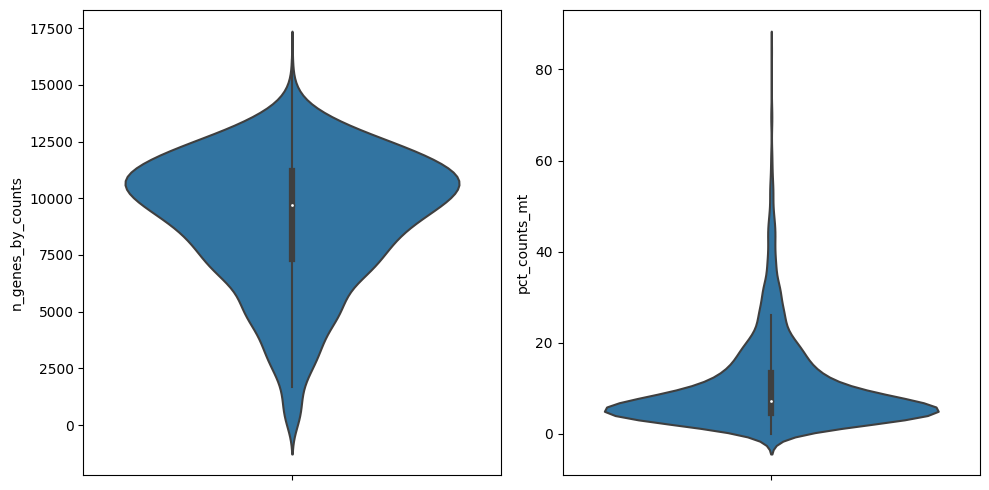

In [10]:
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(10,5))
sns.violinplot( y="n_genes_by_counts", data=obsqc, ax = ax[0])
sns.violinplot(y="pct_counts_mt", data=adata.obs, ax=ax[1])
plt.tight_layout()
#plt.savefig("SMART-seq/qcplot.pdf", format="pdf")

In [217]:
# QC plot for final figure
reduceTimeMap = {}
for t in ["pre"]:
    reduceTimeMap[t] = "pre"
for t in ["M1", "M2", "M3"]:
    reduceTimeMap[t] = "M1-3"
for t in ["M6", "M9", "M12"]:
    reduceTimeMap[t] = "M4-"   
for t in ["normal"]:
    reduceTimeMap[t] = "normal"
adata.obs["reduced_time"] = adata.obs["timepoint"].map(reduceTimeMap)

In [311]:
sns.color_palette(reducedTimeColors, desat=0.75)[0]

(0.7308823529411765, 0.3808823529411765, 0.10441176470588232)

In [309]:
reducedTimeColors

[(0.8352941176470589, 0.3686274509803922, 0.0),
 (0.00392156862745098, 0.45098039215686275, 0.6980392156862745),
 (1, 1, 0),
 (0.00784313725490196, 0.6196078431372549, 0.45098039215686275)]

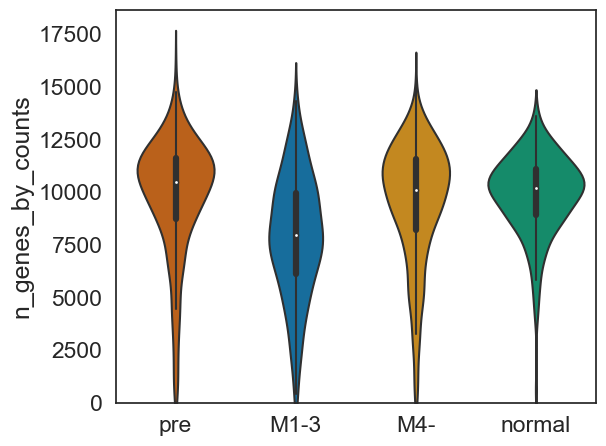

In [333]:
sns.set(style="white", font_scale=1.5, palette="bright")
ax=sns.violinplot(y="n_genes_by_counts", data=adata.obs, x="reduced_time",
                 order=["pre", "M1-3", "M4-", "normal"],
                 palette=reducedTimeColors, saturation=0.75)
ax.set(ylim=(0, ax.get_ylim()[1]), xlabel="")
plt.tight_layout()
plt.savefig("SMART-seq/qc_genesbycounts.pdf")


In [308]:
for i,box in enumerate([p for p in ax.patches if not p.get_label()]):
    print(box.get_facecolor())

(0.7308823529411765, 0.3808823529411765, 0.10441176470588232, 1)
(0.09068627450980393, 0.42598039215686273, 0.6112745098039215, 1)
(0.8749999999999998, 0.875, 0.125, 1)
(0.084313725490196, 0.5431372549019609, 0.41666666666666674, 1)


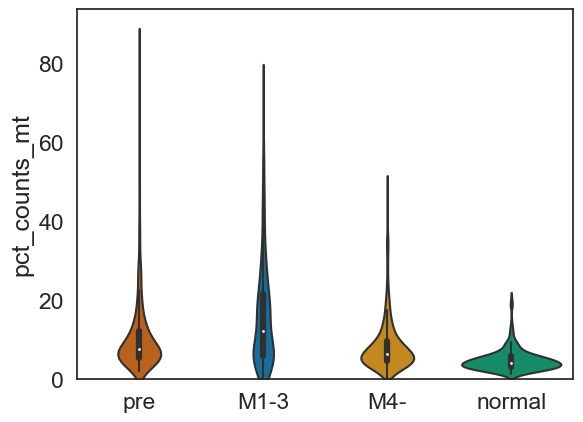

In [334]:
ax=sns.violinplot(y="pct_counts_mt", data=adata.obs, x="reduced_time",
                 order=["pre", "M1-3", "M4-", "normal"],
                 palette=reducedTimeColors)
ax.set(ylim=(0, ax.get_ylim()[1]), xlabel="")
plt.savefig("SMART-seq/qc_mtpct.pdf")

In [ ]:
sns.violinplot( y="n_genes_by_counts", data=obsqc, ax = ax[0])

In [18]:
# 
adata.var_names.isin({"HBAP1", "HBA1", "HBA2", "HBB", "HBBP1",
                     "HBBP1", "HBD", "HBE1", "HBG1", "HBG2", 
                     "HBM", "HBQ1", "HBZ", "HBZP1"}).sum()

1

In [47]:
print(len(adata.var), len(adata))
sc.pp.filter_genes(adata, min_cells=10)
print(len(adata.var))

# Filter by MT number
adata = RemoveMTCell(adata, 30) 
print(len(adata))

# Filter immune repertoire genes
adata.var['imrep'] = (adata.var_names.str.startswith('IGH') | adata.var_names.str.startswith('IGK') | \
    adata.var_names.str.startswith('IGL') | adata.var_names.str.startswith('TRB') | \
    adata.var_names.str.startswith('TRA') | adata.var_names.str.startswith('TRG') | \
    adata.var_names.str.startswith('TRD'))
adata = adata[:, ~adata.var['imrep']]
print(len(adata.var))

# Filter hemogloblin genes: https://www.genenames.org/data/genegroup/#!/group/940
adata.var['HB'] = adata.var_names.isin({"HBAP1", "HBA1", "HBA2", "HBB", "HBBP1",
                     "HBBP1", "HBD", "HBE1", "HBG1", "HBG2", 
                     "HBM", "HBQ1", "HBZ", "HBZP1"})
adata = adata[:, ~adata.var['HB']]
print(len(adata.var))

# Filter by the cells express too few or too much genes
geneCntRange = (2000, 25000)
adata = adata[(adata.obs.n_genes_by_counts >= geneCntRange[0])
             & (adata.obs.n_genes_by_counts <= geneCntRange[1]), :]
print(len(adata))

34615 1809
28143
1708


/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_66954/2296494350.py:10: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['imrep'] = (adata.var_names.str.startswith('IGH') | adata.var_names.str.startswith('IGK') | \
/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_66954/2296494350.py:18: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['HB'] = adata.var_names.isin({"HBAP1", "HBA1", "HBA2", "HBB", "HBBP1",


27770
27761
1683


In [25]:
np.array(adata.X).sum(axis=0)

array([ 6221.283223, 18647.128641,  5216.8494  , ...,  7897.050408,
        2335.540128,  5952.481306])

In [48]:
sc.pp.normalize_total(adata, target_sum=1e6)
sc.pp.highly_variable_genes(adata, flavor="seurat_v3", n_top_genes=2000)
sc.pp.log1p(adata)
#sc.pp.highly_variable_genes(adata, n_top_genes=2000)

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/preprocessing/_highly_variable_genes.py:62: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


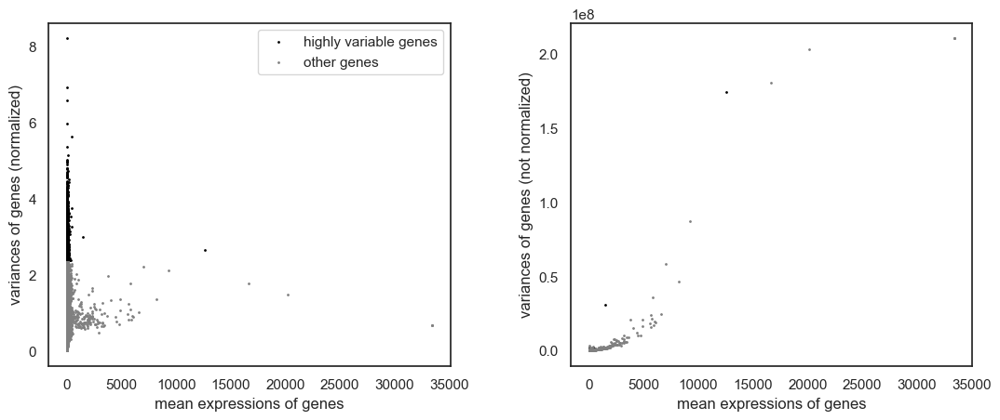

In [49]:
sc.pl.highly_variable_genes(adata)

In [50]:
adata.raw = adata

In [51]:
adata = adata[:, adata.var.highly_variable]

In [52]:
#sc.pp.regress_out(adata, ["total_counts", "pct_counts_mt"])
sc.pp.scale(adata)

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [88]:
adata.obs

,batch,patient,timepoint,picking,cd19 expression,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden_1.0,raw_pateint,reduced_time
batch1_S1,batch1,HD1,normal,D,pos,9753,828690.973979,57756.243776,6.969576,3,PBMC13,normal
batch1_S10,batch1,HD1,normal,D,pos,10188,854050.840136,38392.017611,4.495285,2,PBMC13,normal
batch1_S100,batch1,MCL03,pre,S,pos,11248,827730.086682,53239.283250,6.431962,4,753528,pre
batch1_S101,batch1,MCL03,pre,D,pos,9026,908373.480852,41163.609974,4.531573,4,753528,pre
batch1_S102,batch1,MCL03,pre,D,pos,4738,889274.342253,34622.911165,3.893389,4,753528,pre
...,...,...,...,...,...,...,...,...,...,...,...,...
batch4_S95,batch4,MCL08,M1,D,pos,5706,828051.723576,153651.310291,18.555762,0,693381,M1-3
batch4_S96,batch4,MCL08,M1,S,pos,6341,755590.221229,143769.890304,19.027495,0,693381,M1-3
batch4_S97,batch4,MCL08,M1,D,pos,9039,796180.808463,60950.068853,7.655305,0,693381,M1-3
batch4_S98,batch4,MCL08,M1,D,neg,7781,791343.784788,122691.448853,15.504191,0,693381,M1-3


In [53]:
sc.tl.pca(adata, svd_solver='arpack', n_comps=50, use_highly_variable=True)

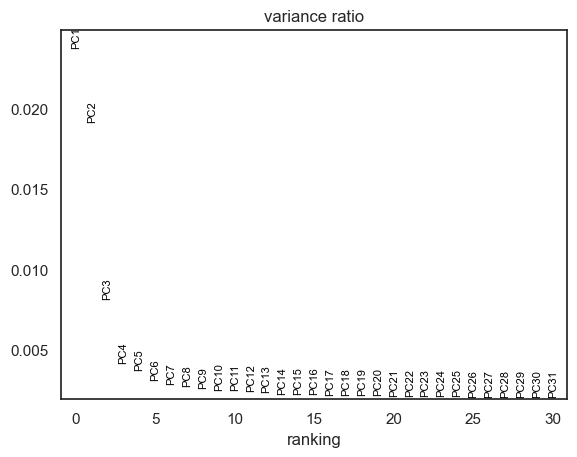

In [54]:
sc.pl.pca_variance_ratio(adata, log=False)

In [55]:
sc.external.pp.harmony_integrate(adata, key = "batch", plot_convergence=True,
                                max_iter_harmony=20)

2024-09-03 12:55:28,626 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-09-03 12:55:29,176 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-09-03 12:55:29,205 - harmonypy - INFO - Iteration 1 of 20
2024-09-03 12:55:29,556 - harmonypy - INFO - Iteration 2 of 20
2024-09-03 12:55:29,767 - harmonypy - INFO - Iteration 3 of 20
2024-09-03 12:55:29,949 - harmonypy - INFO - Iteration 4 of 20
2024-09-03 12:55:30,142 - harmonypy - INFO - Iteration 5 of 20
2024-09-03 12:55:30,296 - harmonypy - INFO - Iteration 6 of 20
2024-09-03 12:55:30,436 - harmonypy - INFO - Iteration 7 of 20
2024-09-03 12:55:30,587 - harmonypy - INFO - Iteration 8 of 20
2024-09-03 12:55:30,720 - harmonypy - INFO - Converged after 8 iterations


In [25]:
adata.obsm["X_pca_harmony"]

array([[-1.7660210e+00, -7.3338699e+00,  3.3854303e+00, ...,
        -7.6154657e-02,  3.8613775e-01, -8.3149815e-01],
       [-6.3429987e-01, -3.5488803e+00, -3.4187850e-01, ...,
        -2.9291415e+00,  5.8581525e-01, -3.3839099e+00],
       [ 1.5430422e+00,  1.7588103e-01,  6.0058379e+00, ...,
        -7.8249639e-01, -9.2589891e-01, -2.9016483e-01],
       ...,
       [-5.8559055e+00,  2.8687685e+00,  1.1603284e+00, ...,
         1.3489540e-01,  1.1973121e+00, -2.5488302e-01],
       [-8.9169970e+00, -1.4575560e+00,  3.5292566e-01, ...,
         3.2444981e-01, -1.2519459e+00, -8.2360566e-01],
       [-2.9897809e+00,  5.1446524e+00,  8.6778784e-03, ...,
        -3.9035132e+00,  1.2868737e+00, -5.5303484e-01]], dtype=float32)

In [38]:
import sklearn
sklearn.__version__

'1.0.2'

In [43]:
import harmonypy
harmonypy.__file__

'/Users/lsong/opt/anaconda3/lib/python3.9/site-packages/harmonypy/__init__.py'

In [56]:
reducer = umap.umap_.UMAP(random_state=17)
embedding = reducer.fit_transform( adata.obsm["X_pca_harmony"])

In [57]:
adata.obsm["X_umap"] = embedding

In [22]:
adata.obs["leiden_1.0"].value_counts()

KeyError: 'leiden_1.0'

/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_16067/564240221.py:8: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


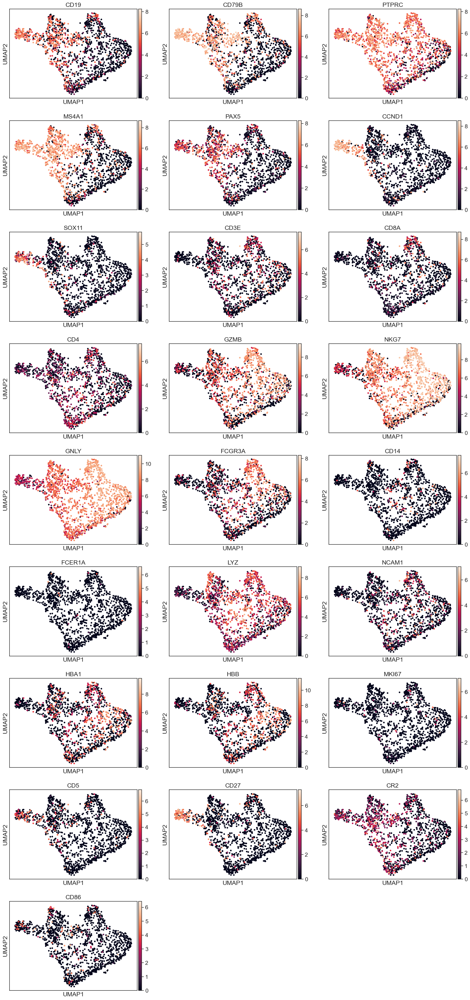

In [589]:
sc.pl.umap(adata[ adata.obs["leiden_1.0"].isin(clusterList)], color=["CD19", "CD79B", "PTPRC", "MS4A1", "PAX5", 
                         "CCND1", "SOX11", 
                         "CD3E", "CD8A", "CD4", "GZMB", "NKG7", "GNLY", 
                         "FCGR3A", "CD14", "FCER1A", "LYZ", "NCAM1", "HBA1", "HBB",
                        "MKI67", "CD5", 
                        "CD27", "CR2", "CD86"], ncols=3,
          show=False)
plt.tight_layout()
plt.savefig("SMART-seq/umap_marker_genes.pdf", format="pdf")

In [268]:
adata

AnnData object with n_obs × n_vars = 1683 × 2000
    obs: 'batch', 'patient', 'timepoint', 'picking', 'cd19 expression', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden_1.0', 'raw_pateint', 'scSnpMarker_category', 'reduced_time', 't4type'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'imrep', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'cd19 expression_colors'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_66954/1169254095.py:8: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


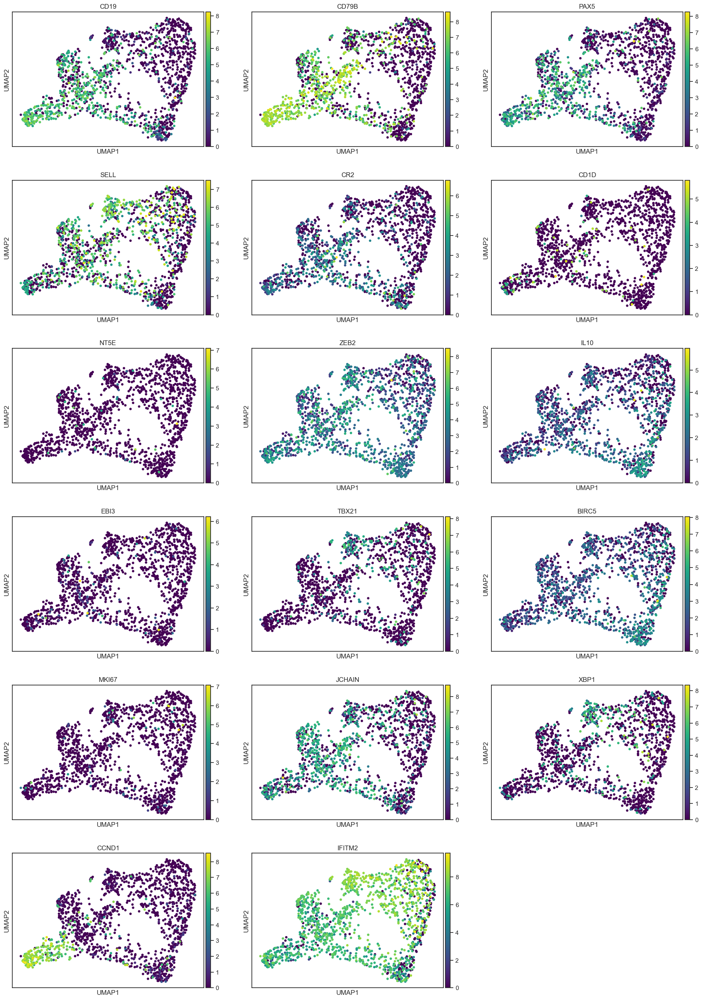

In [71]:
import matplotlib as mpl
sc.pl.umap(adata[ adata.obs["leiden_1.0"].isin(clusterList)], color=["CD19", "CD79B", "PAX5", 
                         "SELL", "CR2", "CD1D", "NT5E", "ZEB2",
                         "IL10", "EBI3",  "TBX21",
                         "BIRC5", "MKI67", "JCHAIN", "XBP1", "CCND1",
                        "IFITM2"]
                        , ncols=3, show=False, color_map=mpl.cm.viridis)
plt.tight_layout()

plt.savefig("SMART-seq/umap_marker_genes.pdf", format="pdf")

#"CD179A", "FCER2A", "CD11C",

/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_66954/2141717142.py:5: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


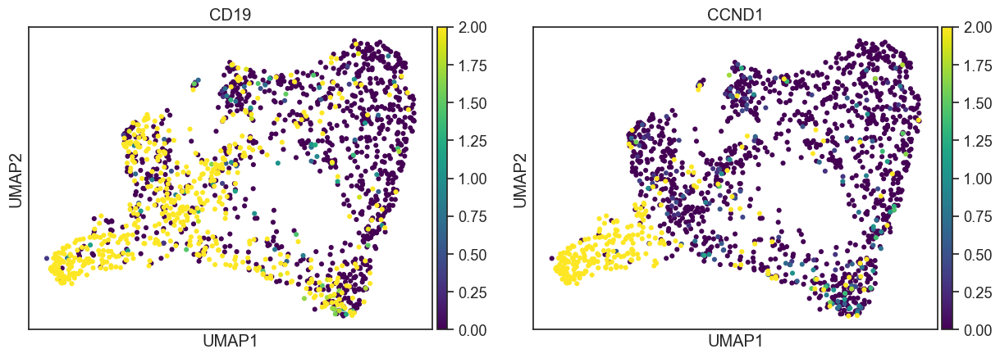

In [139]:
import matplotlib as mpl
sc.pl.umap(adata[ adata.obs["leiden_1.0"].isin(clusterList)], color=["CD19", "CCND1"],
                           vmin=0, vmax=2,
                        ncols=2, show=False, color_map=mpl.cm.viridis)
plt.tight_layout()

In [136]:
adata.obsm["X_umap"]

array([[ 9.186961 ,  6.954808 ],
       [ 8.627806 ,  6.4105067],
       [11.565695 ,  7.1839304],
       ...,
       [14.294841 ,  5.4097953],
       [14.312956 ,  6.8992662],
       [14.265991 ,  4.5695877]], dtype=float32)

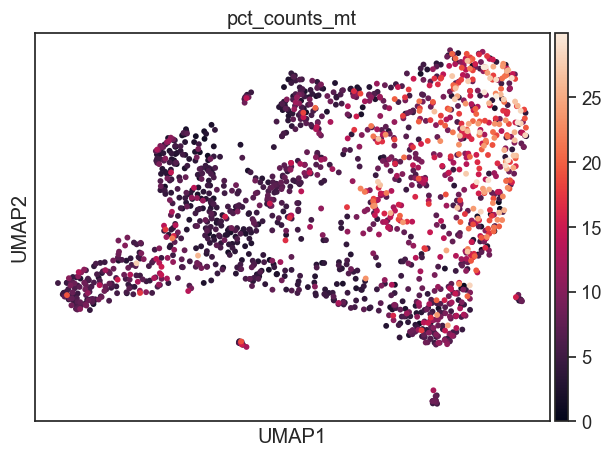

In [140]:
sc.pl.umap(adata, color=["pct_counts_mt"],
          show=False)
plt.tight_layout()
#plt.savefig("SMART-seq/umap_marker_genes.pdf", format="pdf")

<AxesSubplot:xlabel='leiden_1.0', ylabel='pct_counts_mt'>

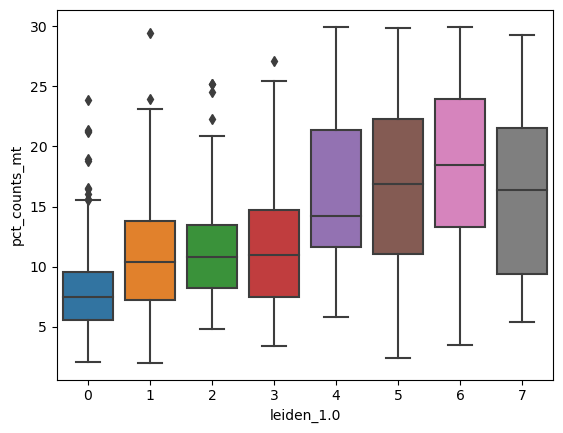

In [52]:
sns.boxplot(x="leiden_1.0", y="pct_counts_mt", data=adata.obs,
           order=[str(x) for x in [0,1,2,3,4,5,6,7]])


In [58]:
sc.pp.neighbors(adata, n_neighbors=15, use_rep="X_pca_harmony")

In [59]:
#sc.tl.leiden(adata, key_added = "leiden_0.5", resolution = 0.5)
sc.tl.leiden(adata, key_added = "leiden_1.0", resolution = 1.0)
#sc.tl.leiden(adata, key_added = "leiden_1.5", resolution = 1.5)

In [60]:
adata.obs["leiden_1.0"].value_counts()

leiden_1.0
0     308
1     245
2     242
3     218
4     194
5     193
6     151
7      76
8      16
9      15
10     14
11     11
Name: count, dtype: int64

In [45]:
# Save the Adata!!
adata.write_h5ad("SMART-seq/adata.h5ad")

In [66]:
# Read the Adata!!
adata = sc.read_h5ad("SMART-seq/adata.h5ad")

In [70]:
adata

AnnData object with n_obs × n_vars = 1683 × 2000
    obs: 'batch', 'patient', 'timepoint', 'picking', 'cd19 expression', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden_1.0', 'raw_pateint'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'imrep', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'log1p', 'neighbors', 'pca'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_87960/1203530876.py:5: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


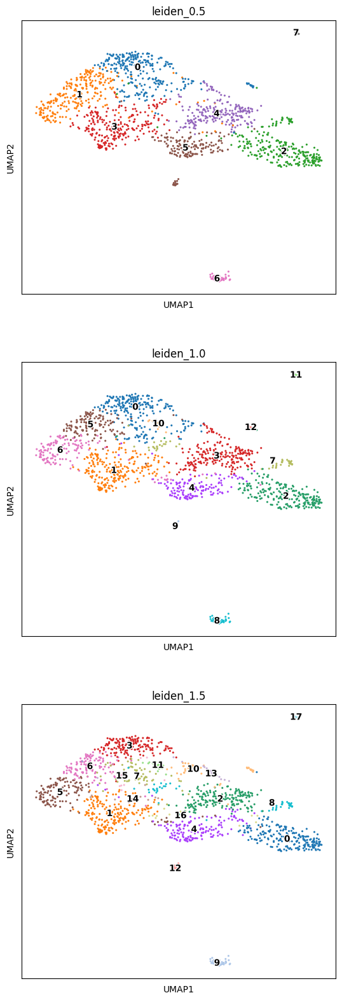

In [451]:
# Not used
with plt.rc_context({"figure.figsize": (6, 6)}):
    ax = sc.pl.umap(adata, color=['leiden_0.5', 'leiden_1.0','leiden_1.5'],
              legend_loc='on data', legend_fontoutline=2, show=False, ncols=1,
                   size=20)
    plt.tight_layout()
    plt.savefig("./SMART-seq/umap_clusterId_explore.pdf", format="pdf")

In [10]:
adata.obs["leiden_1.0"].value_counts()

leiden_1.0
0     324
1     270
2     261
3     170
4     150
5     149
6     129
7     112
8      63
9      16
10     16
11     15
12      8
Name: count, dtype: int64

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


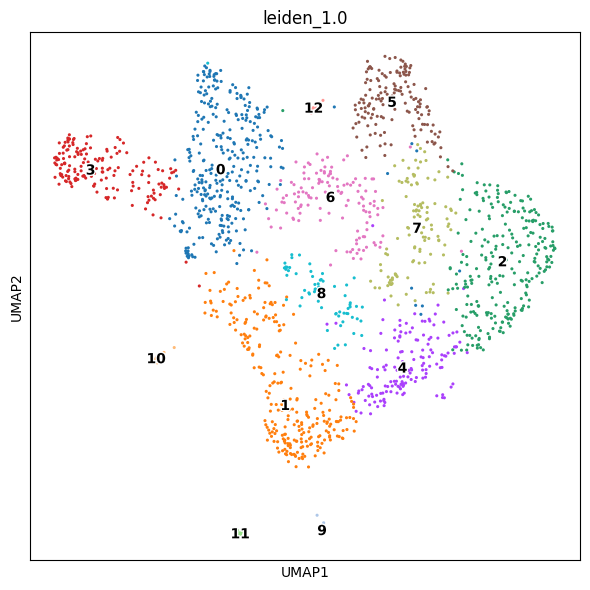

In [ ]:
# Include all clusters
with plt.rc_context({"figure.figsize": (6, 6)}):
    ax = sc.pl.umap(adata, color=['leiden_1.0'],
          legend_loc='on data', legend_fontoutline=2, show=False, ncols=1,
           size=20)
    plt.tight_layout()
    plt.savefig("./SMART-seq/umap_clusterId.pdf", format="pdf")

In [11]:
# FOR FINAL FIGURE
clusterCnt = 9
inclusion = []
clusterList = []
for i in range(clusterCnt):
    inclusion.append(str(i))
    clusterList.append(str(i))

#### Main UMAP

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


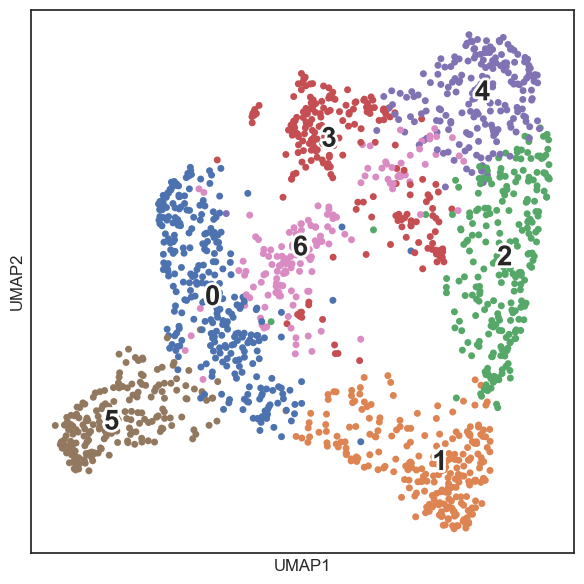

In [342]:
# FOR FINAL FIGURE
# A selected subset of clusters
sns.set(style="white", font_scale=1)
with plt.rc_context({"figure.figsize": (6, 6)}):
    ax = sc.pl.umap(adata[ adata.obs["leiden_1.0"].isin(clusterList) ], color=['leiden_1.0'],
          legend_loc='on data', legend_fontoutline=4, legend_fontsize=20, show=False, ncols=1,
           size=100)
    ax.set(title="")
    plt.tight_layout()
    plt.savefig("./SMART-seq/umap_included_clusterId.pdf", format="pdf")

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


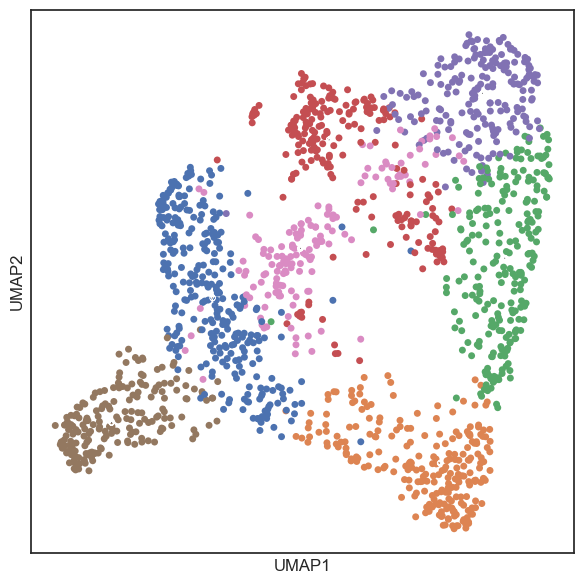

In [344]:
# FOR FINAL FIGURE
# A selected subset of clusters
sns.set(style="white", font_scale=1)
with plt.rc_context({"figure.figsize": (6, 6)}):
    ax = sc.pl.umap(adata[ adata.obs["leiden_1.0"].isin(clusterList) ], color=['leiden_1.0'],
          legend_loc='on data', legend_fontoutline=4, legend_fontsize=0, show=False, ncols=1,
           size=100)
    ax.set(title="")
    plt.tight_layout()
    plt.savefig("./SMART-seq/umap_included_woclusterId.pdf", format="pdf")

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


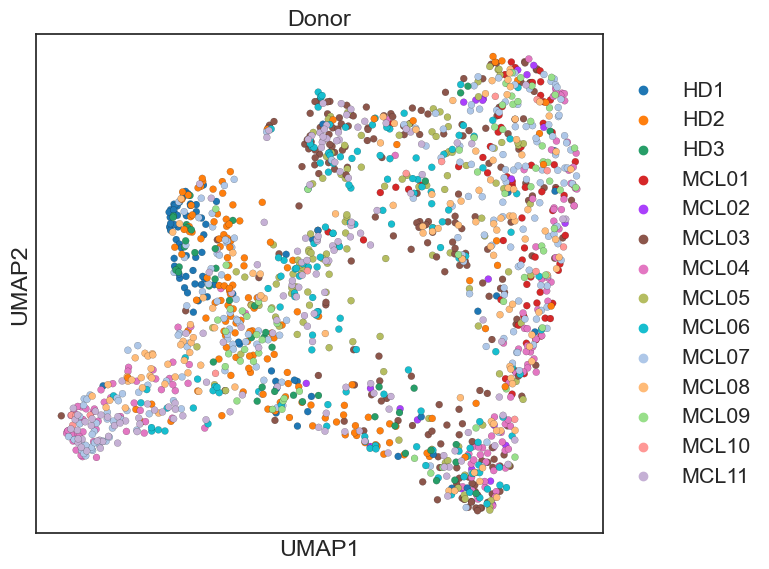

In [181]:
# FOR FINAL FIGURE
# Umap for paitent
with plt.rc_context({"figure.figsize": (8, 6)}):
    ax = sc.pl.umap(adata[ adata.obs["leiden_1.0"].isin(clusterList) ], color=['patient'],
         show=False, ncols=1, linewidth=0.1, edgecolor=[0,0,0],
           size=100)
    ax.set( title="Donor")
    plt.tight_layout()
    plt.savefig("./SMART-seq/umap_included_patient.pdf", format="pdf")

/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_66954/3085291769.py:7: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  subAdata.obs["timepoint"] = subAdata.obs["timepoint"].astype("category")
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


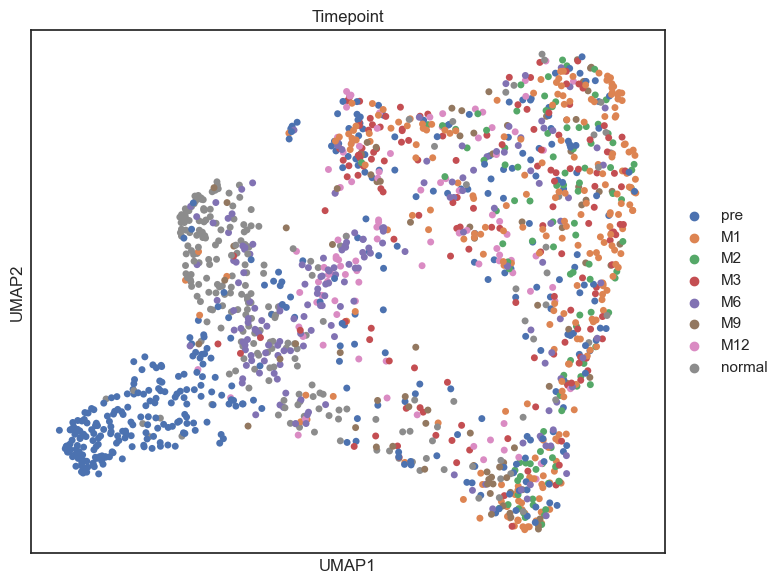

In [75]:
# FOR FINAL FIGURE
# Umap for timepoint
selectedTime = ["pre", "M1", "M2", "M3", "M6", "M9", "M12", "normal"]

subAdata = adata[ (adata.obs["leiden_1.0"].isin(clusterList))
                    & (adata.obs["timepoint"].isin(selectedTime))]
subAdata.obs["timepoint"] = subAdata.obs["timepoint"].astype("category")
subAdata.obs["timepoint"] = subAdata.obs["timepoint"].cat.reorder_categories(selectedTime)
with plt.rc_context({"figure.figsize": (8, 6)}):
    ax = sc.pl.umap(subAdata, color=['timepoint'],
         show=False, ncols=1, na_in_legend=False, 
           size=100)
    ax.set(title="Timepoint")
    plt.tight_layout()
    plt.savefig("./SMART-seq/umap_included_timepoint.pdf", format="pdf")

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


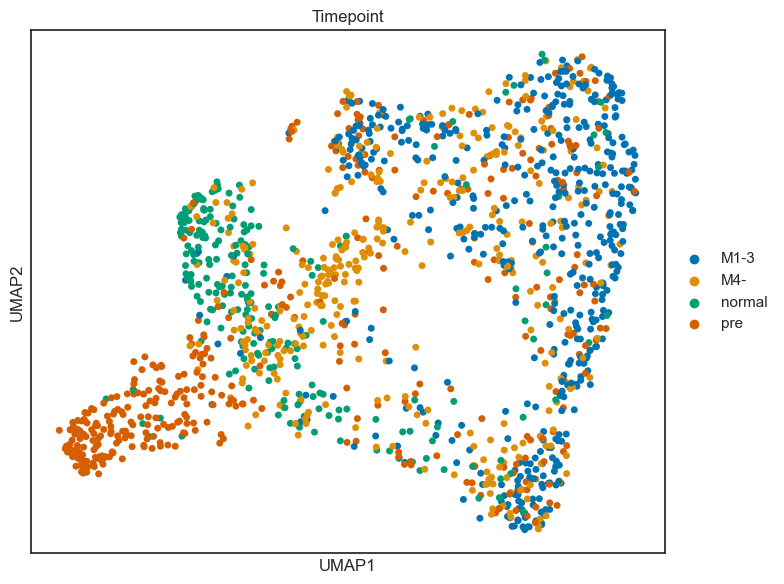

In [351]:
# FOR FINAL FIGURE
# Umap for reduced timepoint
selectedTime = ["pre", "M1-3", "M4-", "normal"]

subAdata = adata[ (adata.obs["leiden_1.0"].isin(clusterList))
                    & (adata.obs["reduced_time"].isin(selectedTime))]
#subAdata.obs["reduced_time"] = subAdata.obs["reduced_time"].astype("category")
#subAdata.obs["reduced_time"] = subAdata.obs["reduced_time"].cat.reorder_categories(selectedTime)
with plt.rc_context({"figure.figsize": (8, 6)}):
    ax = sc.pl.umap(subAdata, color=['reduced_time'],
         show=False, ncols=1, na_in_legend=False, 
           size=100, 
           palette=reducedTimeColorMap)
    ax.set(title="Timepoint")
    plt.tight_layout()
    plt.savefig("./SMART-seq/umap_included_reduced_timepoint.pdf", format="pdf")

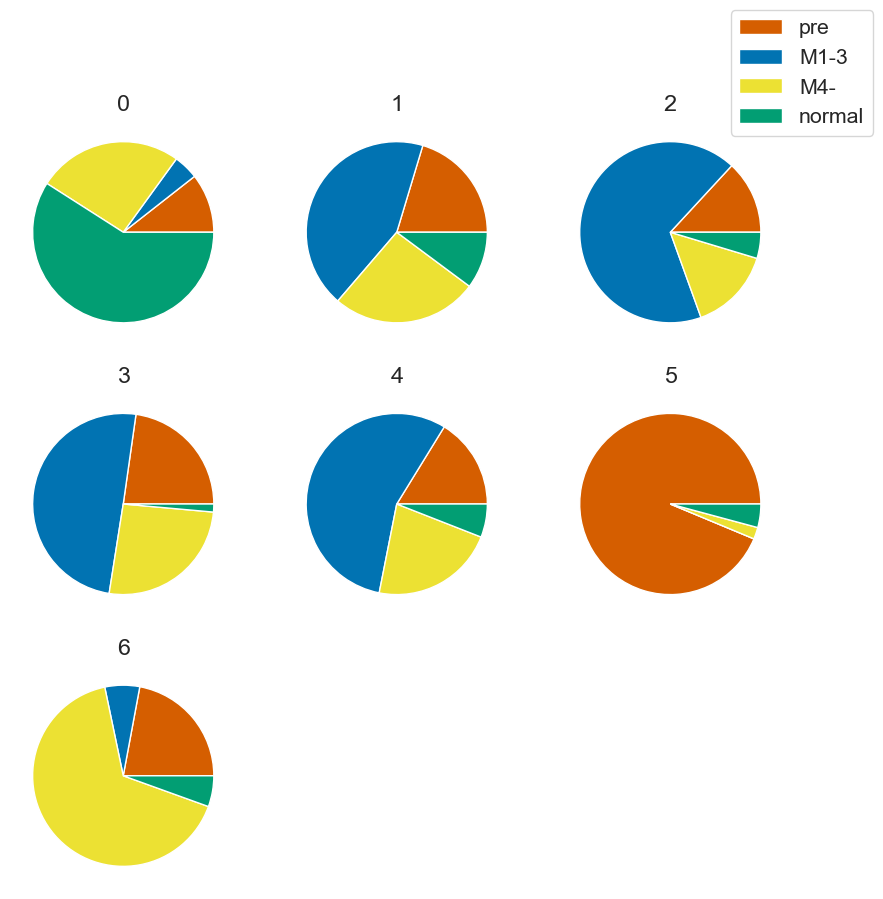

In [174]:
# FOR FINAL FIGURE
# Cluster's timepoint pie chart
selectedTime = {"pre":0, "M1-3":1, "M4-":2, "normal":3}
colors = sns.color_palette("colorblind")[0:9]
colors = [colors[3], colors[0], colors[8], colors[2]]
labels = [key for key in sorted(selectedTime.keys(), key=lambda x:selectedTime[x])]

subAdata = adata[ (adata.obs["leiden_1.0"].isin(clusterList))]
                    #& (adata.obs["reduced_time"].isin(selectedTime))]
fig, axes = plt.subplots(nrows=int(np.ceil(len(clusterList)/3)), ncols=3, figsize=(10, 10))
for i, ax in enumerate(fig.axes):
    if (i >= clusterCnt):
        ax.axis('off')
        continue
    subdf = subAdata.obs.loc[ subAdata.obs["leiden_1.0"] == str(i)]
    s=subdf["reduced_time"].value_counts()
    pie=[0,0,0,0]
    total=0
    for t,c in s.items():
        if (t in selectedTime):
            pie[selectedTime[t]] = c
        total += c
    pie = np.array(pie) / total
    ax.set(title=str(i))
    ax.pie(pie, colors=colors)#, labels = selectedTime.keys())
fig.legend(labels=labels)
plt.savefig("SMART-seq/composition_cluster_pie_timepoint.pdf", format="pdf")

In [15]:
s=adata[adata.obs["leiden_1.0"]=='1'].obs["reduced_time"].value_counts()

In [53]:
sns.color_palette()

[(0.12156862745098039, 0.4666666666666667, 0.7058823529411765),
 (1.0, 0.4980392156862745, 0.054901960784313725),
 (0.17254901960784313, 0.6274509803921569, 0.17254901960784313),
 (0.8392156862745098, 0.15294117647058825, 0.1568627450980392),
 (0.5803921568627451, 0.403921568627451, 0.7411764705882353),
 (0.5490196078431373, 0.33725490196078434, 0.29411764705882354),
 (0.8901960784313725, 0.4666666666666667, 0.7607843137254902),
 (0.4980392156862745, 0.4980392156862745, 0.4980392156862745),
 (0.7372549019607844, 0.7411764705882353, 0.13333333333333333),
 (0.09019607843137255, 0.7450980392156863, 0.8117647058823529)]

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


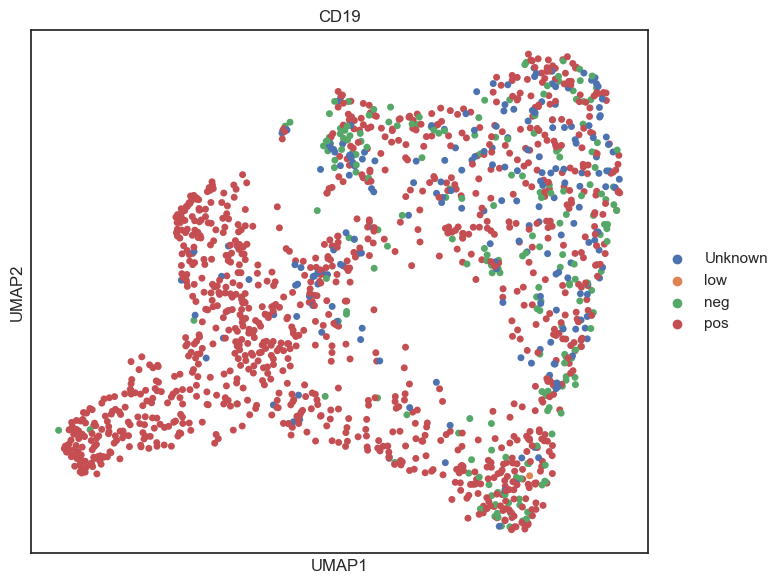

In [352]:
# FOR FINAL FIGURE
# Umap for CD19 expression
with plt.rc_context({"figure.figsize": (8, 6)}):
    ax = sc.pl.umap(adata[ adata.obs["leiden_1.0"].isin(clusterList) ], 
                    color=['cd19 expression'],
         show=False, ncols=1,
           size=100)
    ax.set( title="CD19")
    plt.tight_layout()
    plt.savefig("./SMART-seq/umap_included_cd19.pdf", format="pdf")

In [ ]:
# Umap for cells with BCR information
with plt.rc_context({"figure.figsize": (8, 6)}):
    ax = sc.pl.umap(adata[ adata.obs["leiden_1.0"].isin(inclusion) ], color=['patient'],
         show=False, ncols=1,
           size=100)
    ax.set( title="Donor")
    plt.tight_layout()
    plt.savefig("./SMART-seq/umap_included_patient.pdf", format="pdf")

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Libra

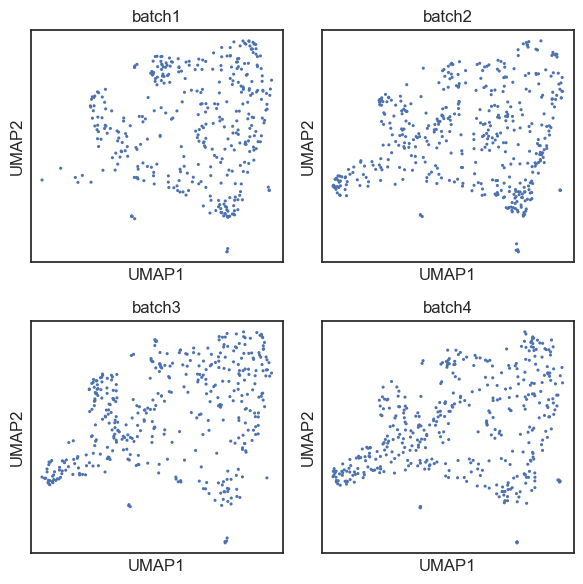

In [80]:
fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(6,6))
for i, c in enumerate(["batch1", "batch2", "batch3", "batch4"]):
    sc.pl.umap(adata[ adata.obs["batch"]==c, :], color=["batch"],
              legend_loc='', legend_fontoutline=1, show=False, size=20,
                    ax=ax[i//2][i%2], title=c)
plt.tight_layout()
plt.savefig("SMART-seq/umap_batch_separate.pdf", format="pdf")

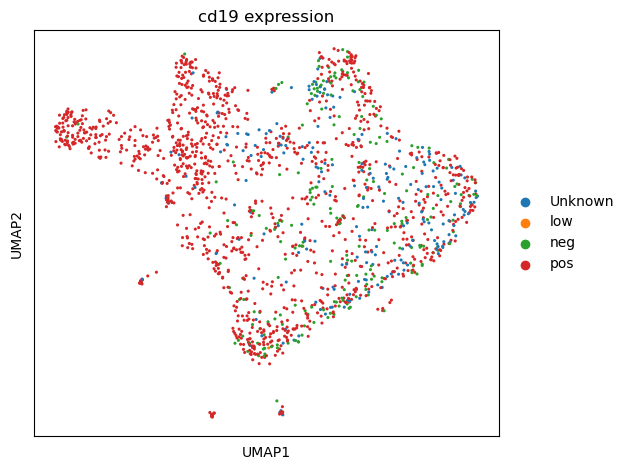

In [37]:
ax = sc.pl.umap(adata, color=['cd19 expression'],
          legend_fontoutline=2, show=False, ncols=1,
           size=20)
plt.tight_layout()
plt.savefig("SMART-seq/umap_cd19.pdf", format="pdf")

In [131]:
adata.obs

,batch,patient,timepoint,picking,cd19 expression,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden_1.0,t4type
batch1_S1,batch1,PBMC13,normal,D,pos,11273,995373.382029,159933.930748,16.067732,2,B
batch1_S10,batch1,PBMC13,normal,D,pos,11762,989752.107420,91362.027842,9.230799,2,B
batch1_S100,batch1,753528,pre,S,pos,12943,986857.034991,111321.696096,11.280428,4,NA
batch1_S101,batch1,753528,pre,D,pos,10142,995689.115797,72172.774327,7.248525,4,NA
batch1_S102,batch1,753528,pre,D,pos,5096,994763.424797,75908.554398,7.630815,4,NA
...,...,...,...,...,...,...,...,...,...,...,...
batch4_S95,batch4,693381,d28,D,pos,6442,980703.263620,211381.908178,21.554115,3,NA
batch4_S96,batch4,693381,d28,S,pos,7142,983715.808278,231629.795931,23.546414,3,NA
batch4_S97,batch4,693381,d28,D,pos,10214,990689.295454,115019.627698,11.610061,0,NA
batch4_S98,batch4,693381,d28,D,neg,8801,990391.767907,204685.377703,20.667112,3,NA


In [283]:
clusterCnt = 9
inclusion = []
clusterList = []
for i in range(clusterCnt):
    inclusion.append(str(i))
    clusterList.append(str(i))

0 normal
1 normal_CD5
2 pre
3 M1
4 M2
5 M3
6 M6
7 M9
8 M12
9 M18


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Libra

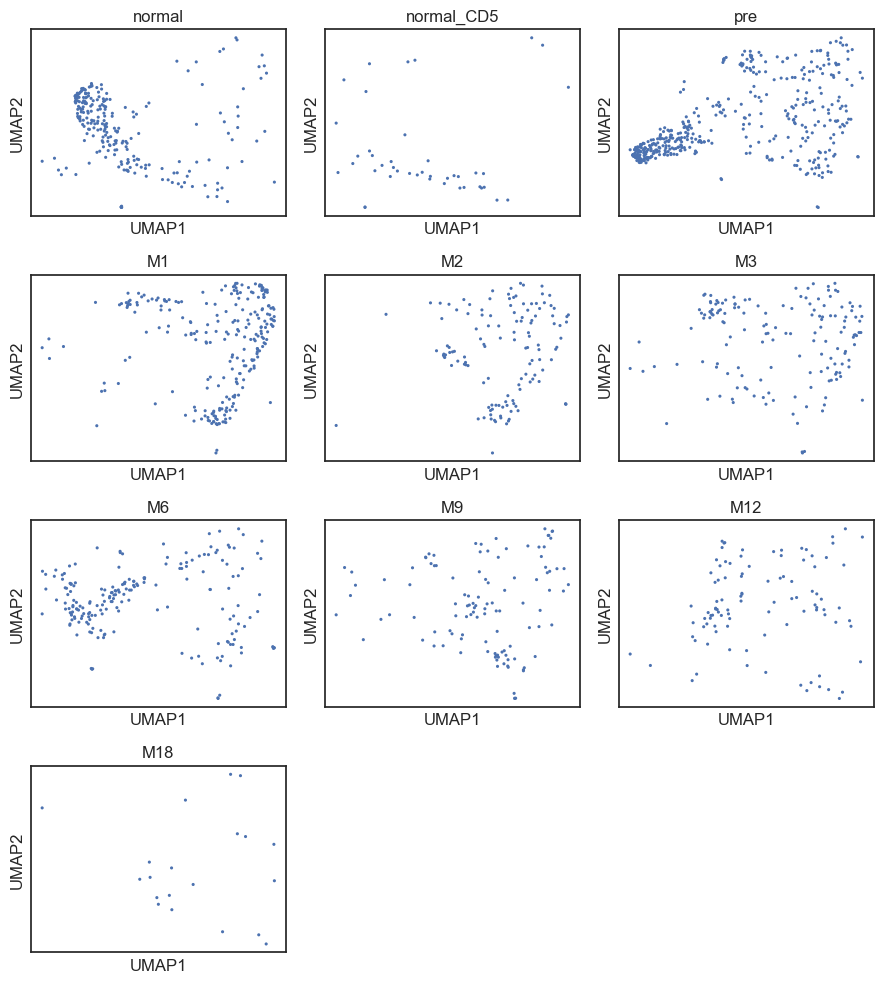

In [81]:
timepoints = ["normal", "normal_CD5", "pre", "M1",
             "M2", "M3", "M6", "M9", "M12", "M18"]
fig, ax = plt.subplots(nrows=int(np.ceil(len(timepoints)/3)), ncols=3, figsize=(9, 10))
for i, t in enumerate(timepoints):
    print(i, t)
    sc.pl.umap(adata[ adata.obs["timepoint"]==t, :], color=["timepoint"],
              legend_loc='', legend_fontoutline=1, show=False, size=20,
                    ax=ax[i//3][i%3], title=t)
for i in range(len(timepoints)%3, 3):
    j = i + len(timepoints) - 1
    ax[j//3][j%3].axis('off')
    
plt.tight_layout()
plt.savefig("SMART-seq/umap_timepoint_separate.pdf", format="pdf")

In [5]:
# count how many cells in each cluster
adata.obs["leiden_1.0"].value_counts()

leiden_1.0
0     324
1     270
2     261
3     170
4     150
5     149
6     129
7     112
8      63
9      16
10     16
11     15
12      8
Name: count, dtype: int64

0 0
1 1
2 2
3 3
4 4
5 5
6 6


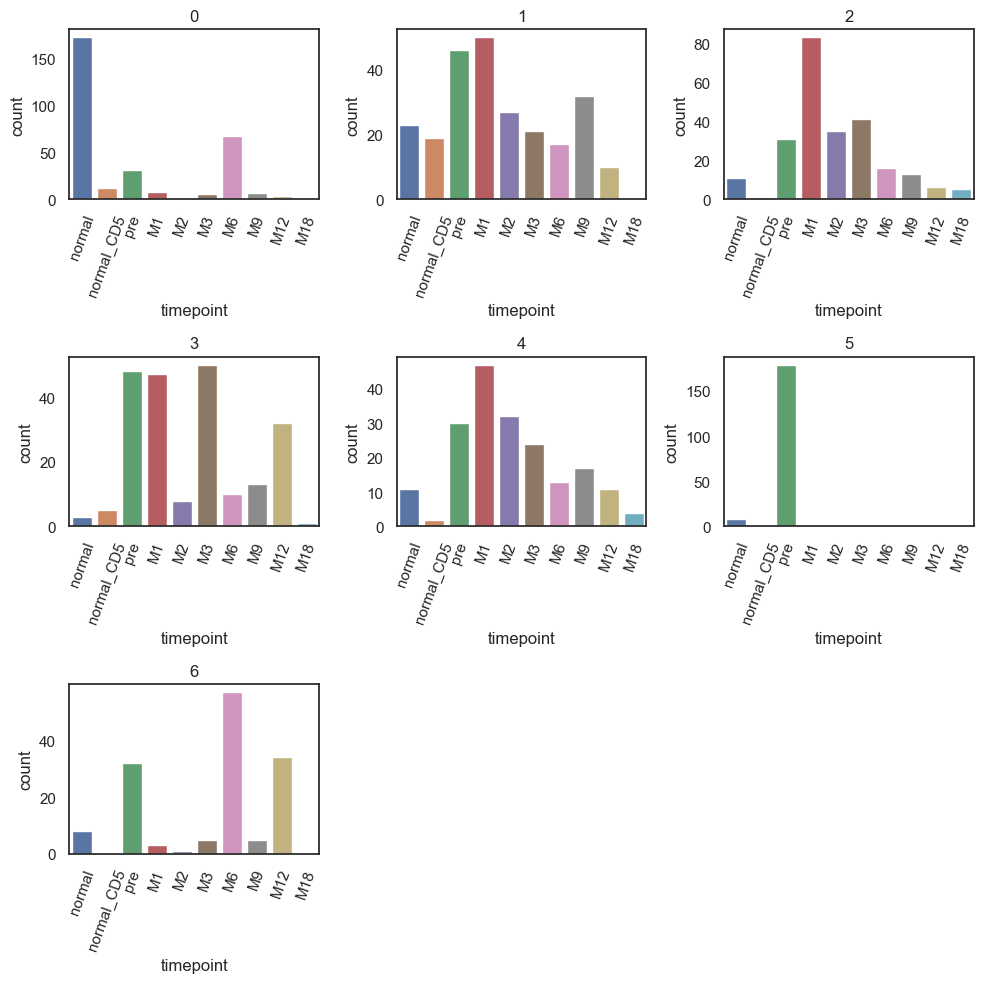

In [82]:
fig, ax = plt.subplots(nrows=int(np.ceil(len(clusterList)/3)), ncols=3, figsize=(10, 10))
for i, c in enumerate(clusterList):
    print(i, c)
    subdf = adata.obs.loc[ adata.obs["leiden_1.0"] == c]
    snsFig = sns.countplot(x='timepoint', data=subdf, order=timepoints,
                           ax=ax[i//3][i%3])
    snsFig.set(title=c)
    #snsFig.set_xticklabels(snsFig.get_xticks(), rotation = 45)
    for tick in snsFig.get_xticklabels():
        tick.set_rotation(70)
    
if (len(clusterList) % 3 != 0):
    for i in range(len(clusterList)%3, 3):
        j = i + (len(clusterList)//3) * 3
        ax[j//3][j%3].axis('off')
    
plt.tight_layout()
plt.savefig("SMART-seq/composition_cluster_timepoint.pdf", format="pdf")

In [ ]:
#timepoints = ["normal", "normal_CD5", "pre", "d28",
#             "M2", "M3", "M6", "M9", "M12", "M18"]

0 0
1 1
2 2
3 3
4 4
5 5
6 6


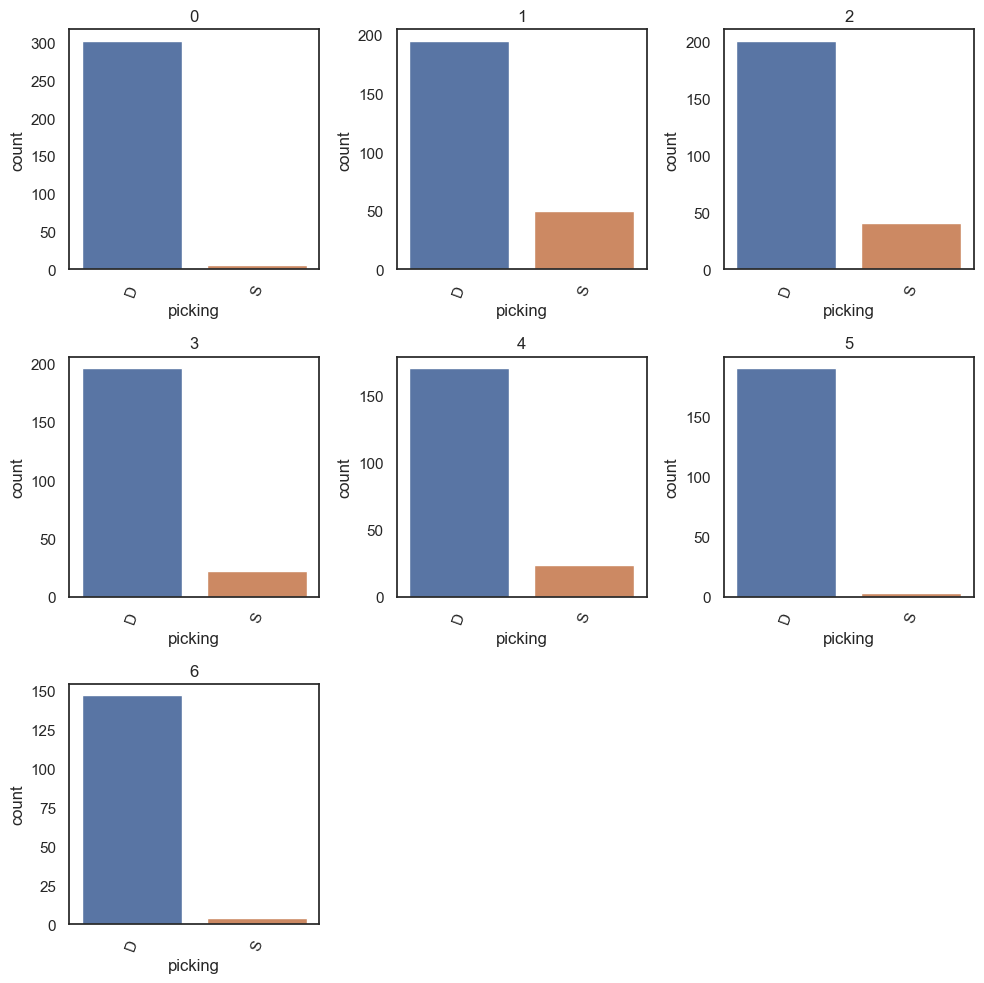

In [79]:
fig, ax = plt.subplots(nrows=int(np.ceil(len(clusterList)/3)), ncols=3, figsize=(10, 10))
for i, c in enumerate(clusterList):
    print(i, c)
    subdf = adata.obs.loc[ adata.obs["leiden_1.0"] == c]
    snsFig = sns.countplot(x='picking', data=subdf,
                           ax=ax[i//3][i%3])
    snsFig.set(title=c)
    #snsFig.set_xticklabels(snsFig.get_xticks(), rotation = 45)
    for tick in snsFig.get_xticklabels():
        tick.set_rotation(70)
    
if (len(clusterList) % 3 != 0):
    for i in range(len(clusterList)%3, 3):
        j = i + (len(clusterList)//3) * 3
        ax[j//3][j%3].axis('off')
    
plt.tight_layout()
plt.savefig("SMART-seq/composition_cluster_picking.pdf", format="pdf")

0 0
1 1
2 2
3 3
4 4
5 5
6 6
7 7
8 8


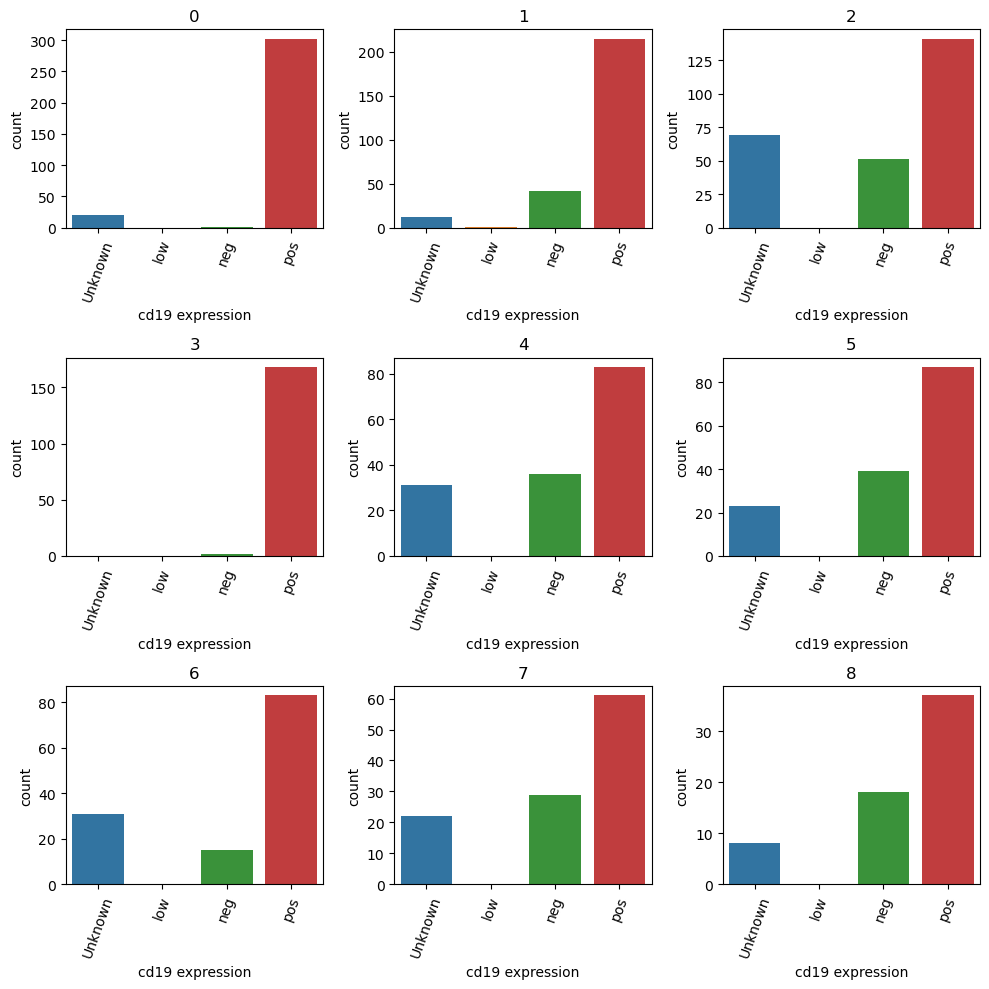

In [43]:
fig, ax = plt.subplots(nrows=int(np.ceil(len(inclusion)/3)), ncols=3, figsize=(10, 10))
for i, c in enumerate(clusterList):
    print(i, c)
    subdf = adata.obs.loc[ adata.obs["leiden_1.0"] == c]
    snsFig = sns.countplot(x='cd19 expression', data=subdf,
                           ax=ax[i//3][i%3])
    snsFig.set(title=c)
    #snsFig.set_xticklabels(snsFig.get_xticks(), rotation = 45)
    for tick in snsFig.get_xticklabels():
        tick.set_rotation(70)
    
if (len(inclusion) % 3 != 0):
    for i in range(len(inclusion)%3, 3):
        j = i + (len(inclusion)//3) * 3
        ax[j//3][j%3].axis('off')
    
plt.tight_layout()
plt.savefig("SMART-seq/composition_cluster_cd19signal.pdf", format="pdf")

In [90]:
adata

,batch,patient,timepoint,picking,cd19 expression,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden_1.0,t4type


0 normal
1 normal_CD5
2 pre
3 M1
4 M2
5 M3
6 M6
7 M9
8 M12
9 M18


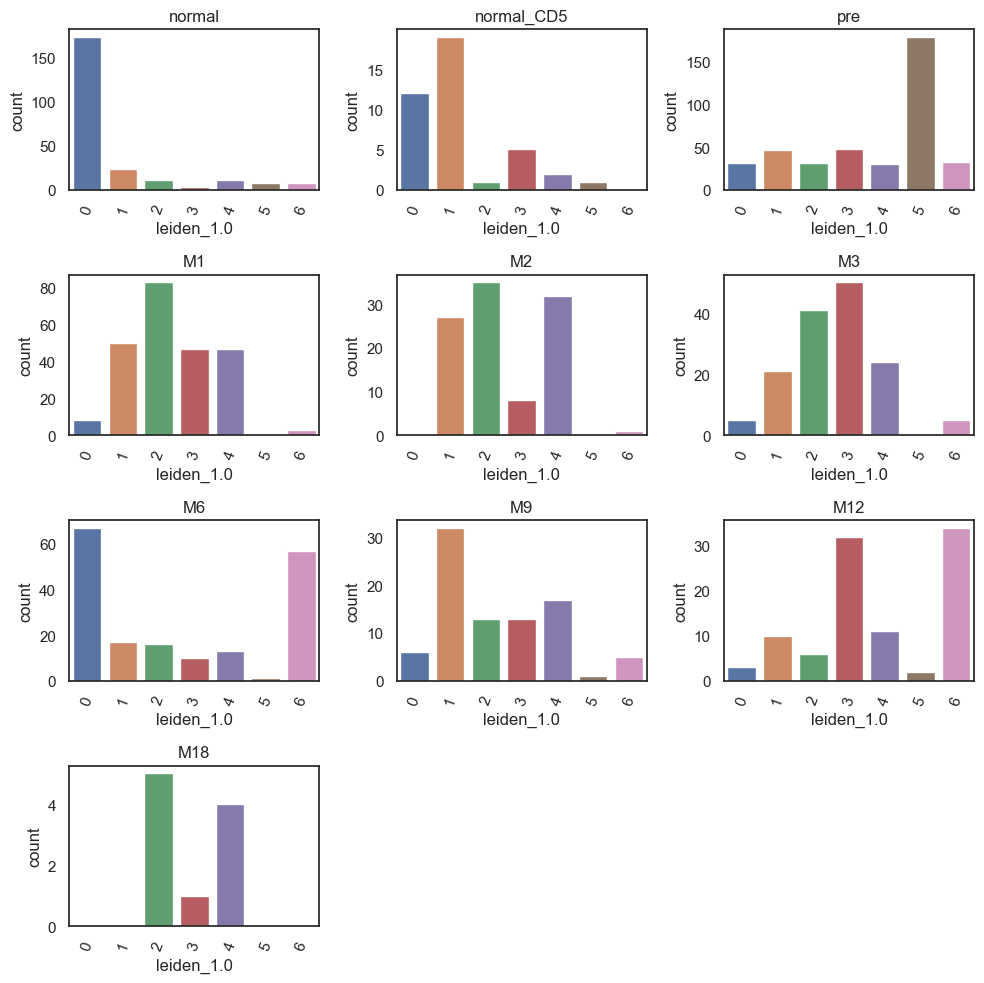

In [83]:
fig, ax = plt.subplots(nrows=int(np.ceil(len(timepoints)/3)), ncols=3, figsize=(10, 10))
for i, t in enumerate(timepoints):
    print(i, t)
    subdf = adata.obs.loc[ (adata.obs["timepoint"] == t) & 
                          (adata.obs["leiden_1.0"].isin(clusterList))]
    snsFig = sns.countplot(x='leiden_1.0', data=subdf, order=clusterList,
                           ax=ax[i//3][i%3])
    snsFig.set(title=t)
    #snsFig.set_xticklabels(snsFig.get_xticks(), rotation = 45)
    for tick in snsFig.get_xticklabels():
        tick.set_rotation(70)
    
if (len(timepoints) % 3 != 0):
    for i in range(len(timepoints)%3, 3):
        j = i + len(timepoints) - 1
        ax[j//3][j%3].axis('off')
    
plt.tight_layout()
plt.savefig("SMART-seq/composition_timepoint_cluster.pdf", format="pdf")

0 normal


NameError: name 'inclusion' is not defined

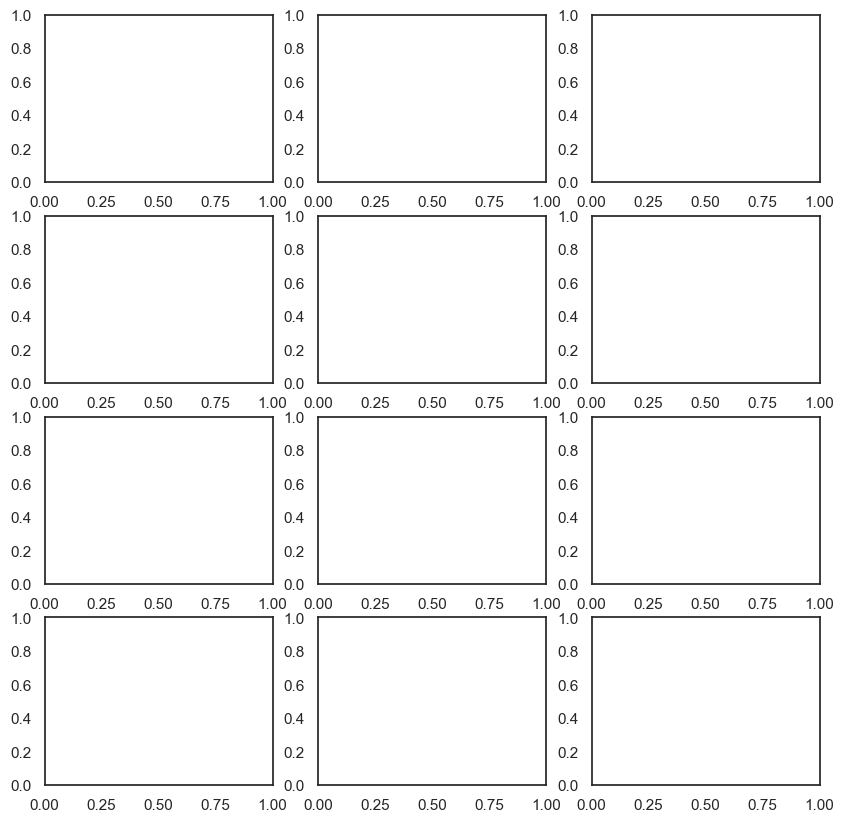

In [84]:
fulltimepoints = timepoints + ["M12_normalB", "pre_normalB"]
fig, ax = plt.subplots(nrows=int(np.ceil(len(fulltimepoints)/3)), ncols=3, figsize=(10, 10))
for i, t in enumerate(fulltimepoints):
    print(i, t)
    subdf = adata.obs.loc[ adata.obs["timepoint"] == t]
    snsFig = sns.countplot(x='leiden_1.0', data=subdf, order=inclusion,
                           ax=ax[i//3][i%3])
    snsFig.set(title=t)
    #snsFig.set_xticklabels(snsFig.get_xticks(), rotation = 45)
    for tick in snsFig.get_xticklabels():
        tick.set_rotation(70)
    
if (len(fulltimepoints) % 3 != 0):
    for i in range(len(fulltimepoints)%3, 3):
        j = i + len(fulltimepoints) - 1
        ax[j//3][j%3].axis('off')
    
plt.tight_layout()
plt.savefig("SMART-seq/composition_alltimepoint_cluster.pdf", format="pdf")

0 normal
1 normal_CD5
2 pre
3 d28
4 M2
5 M3
6 M6
7 M9
8 M12
9 M18
10 M12_normalB
11 pre_normalB


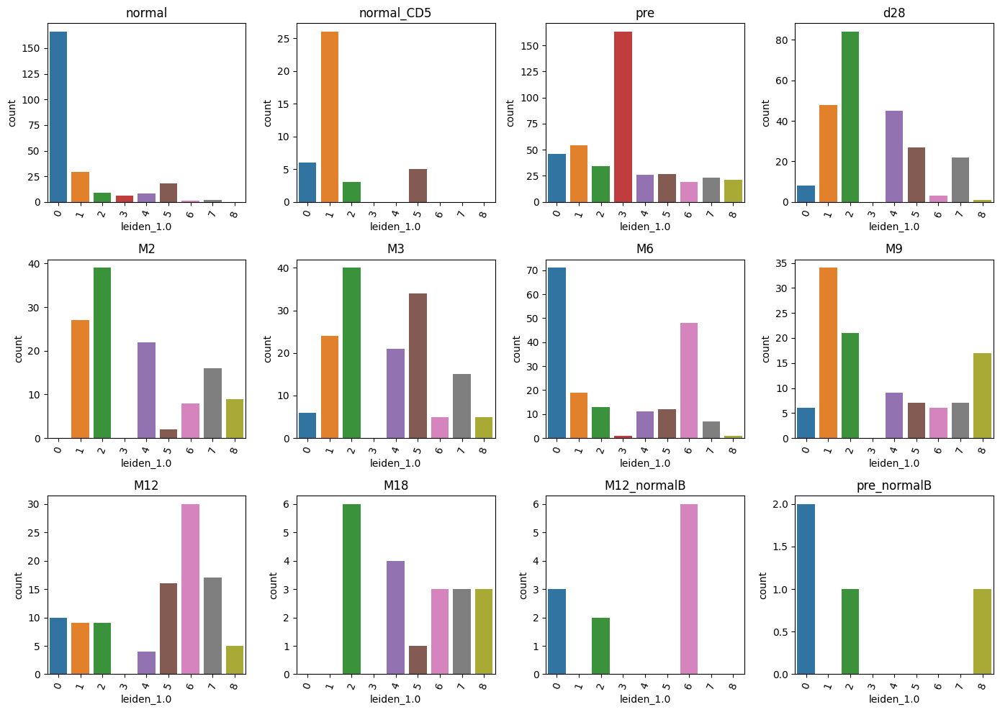

In [167]:
fulltimepoints = timepoints + ["M12_normalB", "pre_normalB"]
fig, ax = plt.subplots(nrows=int(np.ceil(len(fulltimepoints)/4)), ncols=4, figsize=(14, 10))
for i, t in enumerate(fulltimepoints):
    print(i, t)
    subdf = adata.obs.loc[ adata.obs["timepoint"] == t]
    snsFig = sns.countplot(x='leiden_1.0', data=subdf, order=inclusion,
                           ax=ax[i//4][i%4])
    snsFig.set(title=t)
    #snsFig.set_xticklabels(snsFig.get_xticks(), rotation = 45)
    for tick in snsFig.get_xticklabels():
        tick.set_rotation(70)
    
if (len(fulltimepoints) % 4 != 0):
    for i in range(len(fulltimepoints)%5, 5):
        j = i + len(fulltimepoints) - 2
        if (j//5 >= 3):
            break
        ax[j//5][j%5].axis('off')
    
plt.tight_layout()
#plt.savefig("SMART-seq/composition_alltimepoint_cluster.pdf", format="pdf")

0 normal
1 normal_CD5
2 pre
3 M1
4 M2
5 M3
6 M6
7 M9
8 M12
9 M18


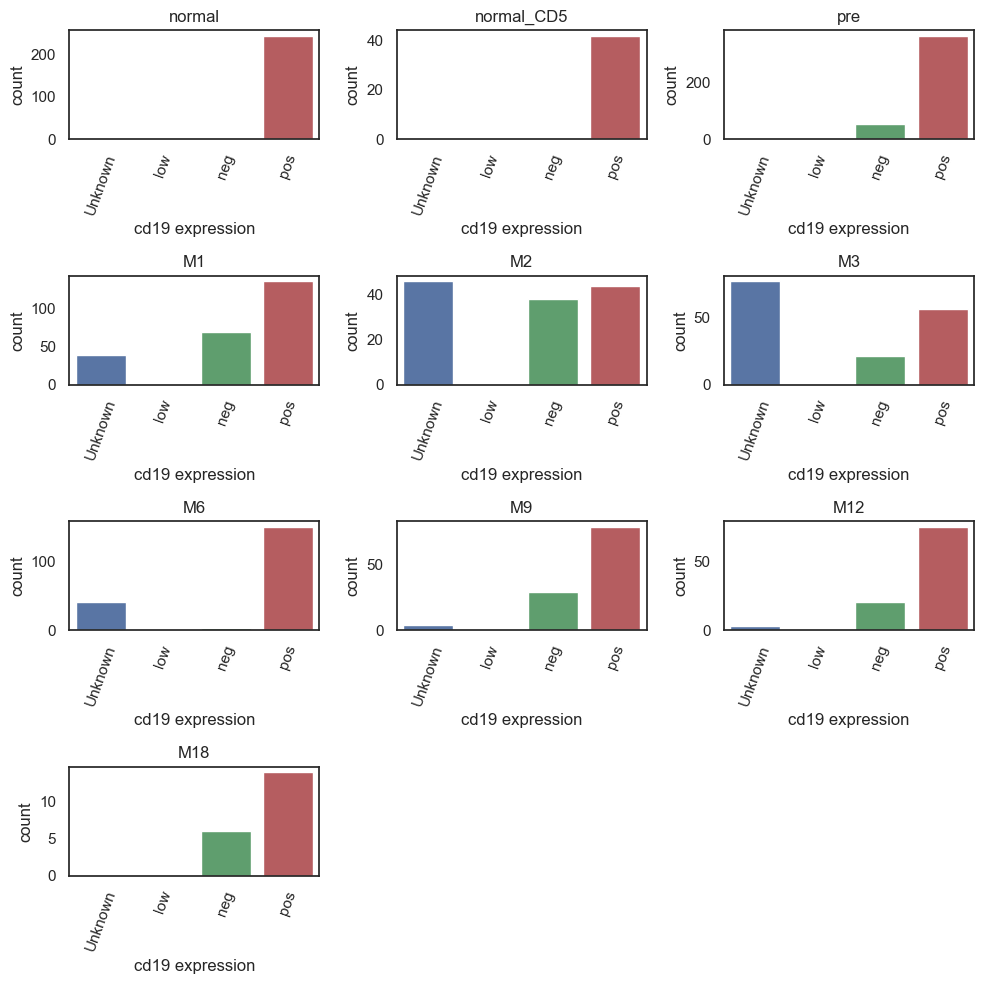

In [85]:
fig, ax = plt.subplots(nrows=int(np.ceil(len(timepoints)/3)), ncols=3, figsize=(10, 10))
for i, t in enumerate(timepoints):
    print(i, t)
    subdf = adata.obs.loc[ adata.obs["timepoint"] == t]
    snsFig = sns.countplot(x='cd19 expression', data=subdf,
                           ax=ax[i//3][i%3])
    snsFig.set(title=t)
    #snsFig.set_xticklabels(snsFig.get_xticks(), rotation = 45)
    for tick in snsFig.get_xticklabels():
        tick.set_rotation(70)
    
if (len(timepoints) % 3 != 0):
    for i in range(len(timepoints)%3, 3):
        j = i + len(timepoints) - 1
        ax[j//3][j%3].axis('off')
    
plt.tight_layout()
plt.savefig("SMART-seq/composition_timepoint_cd19.pdf", format="pdf")

0 0
1 1
2 2
3 3
4 4
5 5
6 6
7 7
8 8


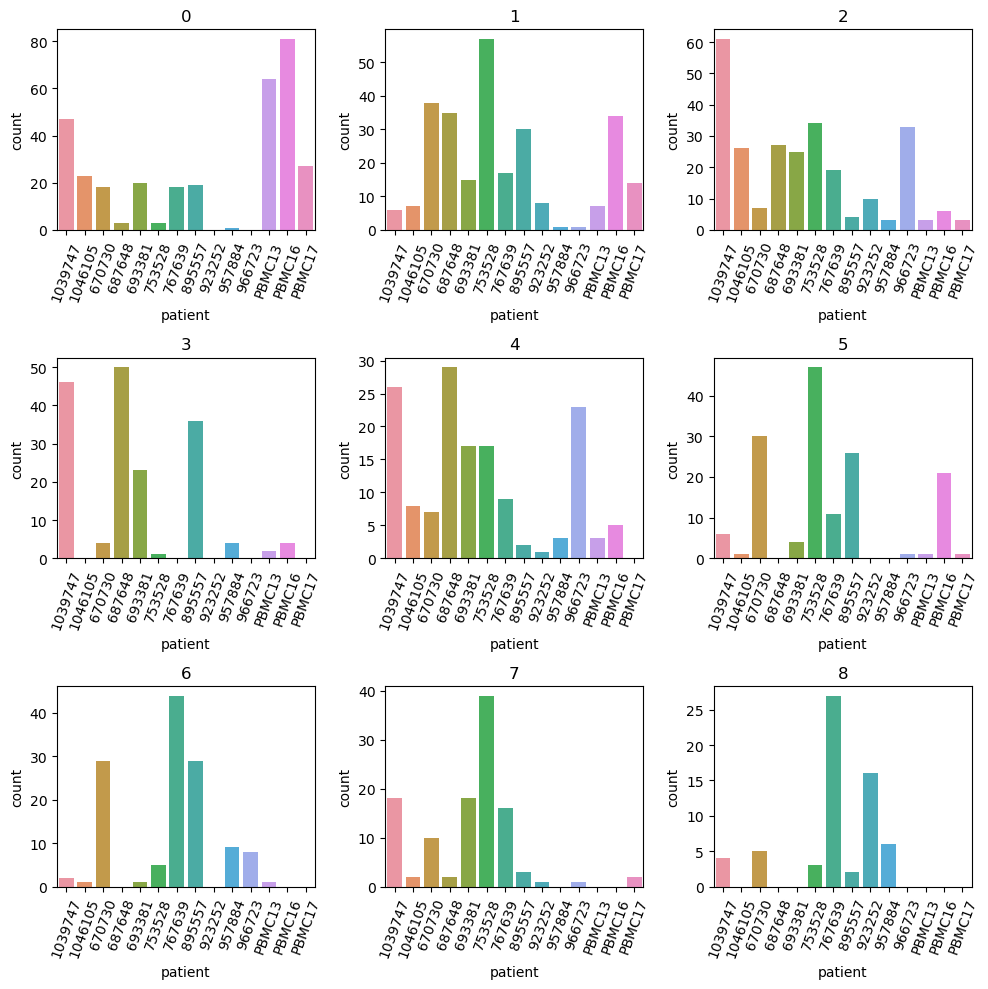

In [46]:
# composition by patients
fig, ax = plt.subplots(nrows=int(np.ceil(len(inclusion)/3)), ncols=3, figsize=(10, 10))
for i, c in enumerate(inclusion):
    print(i, c)
    subdf = adata.obs.loc[ adata.obs["leiden_1.0"] == c]
    snsFig = sns.countplot(x='patient', data=subdf, 
                           order=sorted(adata.obs["patient"].unique()),
                           ax=ax[i//3][i%3])
    snsFig.set(title=c)
    #snsFig.set_xticklabels(snsFig.get_xticks(), rotation = 45)
    for tick in snsFig.get_xticklabels():
        tick.set_rotation(70)
    
if (len(inclusion) % 3 != 0):
    for i in range(len(inclusion)%3, 3):
        j = i + (len(inclusion)//3) * 3
        ax[j//3][j%3].axis('off')
    
plt.tight_layout()
plt.savefig("SMART-seq/umap_cluster_patient_composition.pdf", format="pdf")

In [10]:
adata.obs.loc["batch4_S325"]

batch                       batch4
patient                     895557
timepoint                      d28
picking                          D
cd19 expression                neg
n_genes_by_counts            10916
total_counts         787519.138434
total_counts_mt       39085.972518
pct_counts_mt             4.963177
leiden_1.0                       5
Name: batch4_S325, dtype: object

In [569]:
subdf = adata.obs.loc[ adata.obs["leiden_1.0"] == '0']

### Cell cycle information

In [265]:
# based on https://nbviewer.org/github/theislab/scanpy_usage/blob/master/180209_cell_cycle/cell_cycle.ipynb
cell_cycle_genes = [x.strip() for x in open('../data/regev_lab_cell_cycle_genes.txt')]

s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
#cell_cycle_genes = [x for x in cell_cycle_genes if x in adata.var_names]

In [266]:
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


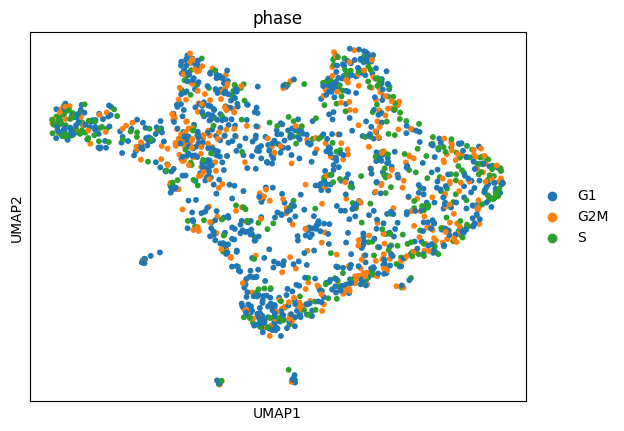

In [270]:
sc.pl.umap(adata, color="phase")

0 normal
1 normal_CD5
2 pre
3 d28
4 M2
5 M3
6 M6
7 M9
8 M12
9 M18


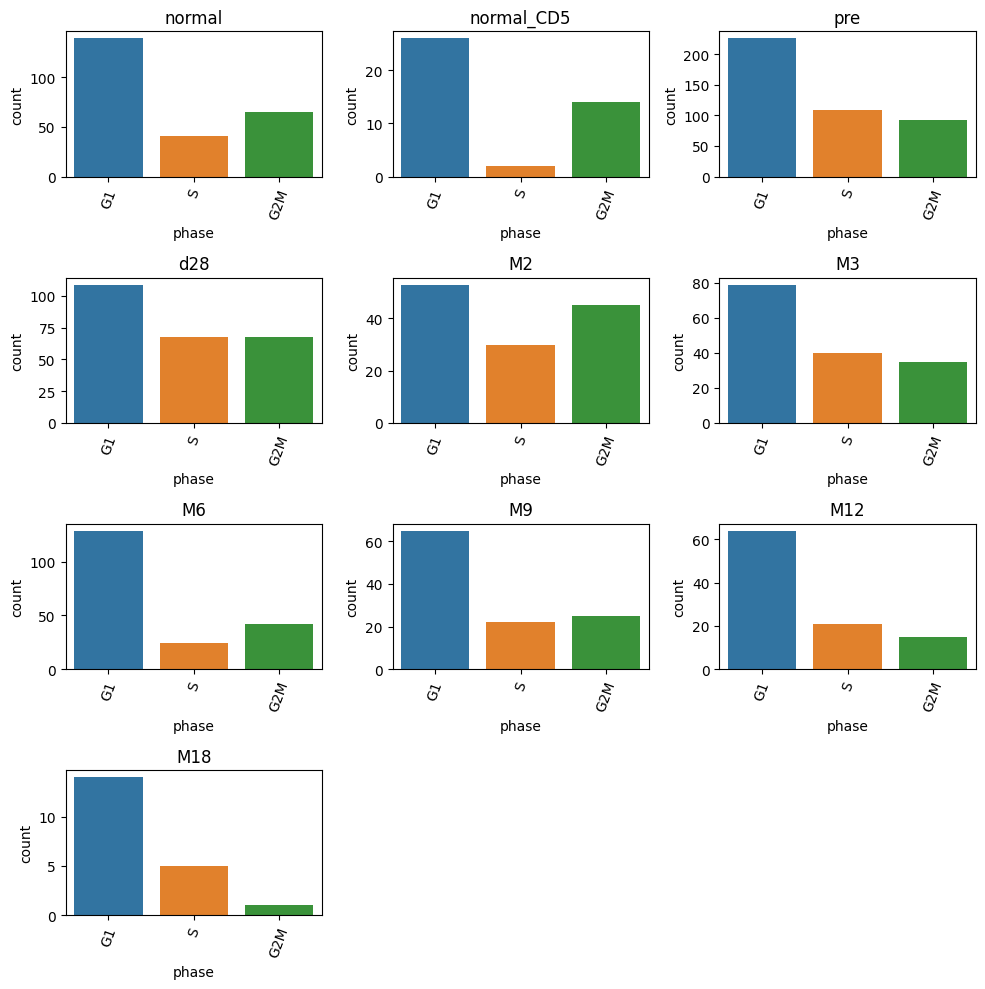

In [387]:
fig, ax = plt.subplots(nrows=int(np.ceil(len(timepoints)/3)), ncols=3, figsize=(10, 10))
phaseOrder = ["G1", "S", "G2M"]
for i, t in enumerate(timepoints):
    print(i, t)
    subdf = adata.obs.loc[ adata.obs["timepoint"] == t]
    #subdf = subdf[ subdf["patient"] == "895557"]
    snsFig = sns.countplot(x='phase', data=subdf, order=phaseOrder,
                           ax=ax[i//3][i%3])
    snsFig.set(title=t)
    #snsFig.set_xticklabels(snsFig.get_xticks(), rotation = 45)
    for tick in snsFig.get_xticklabels():
        tick.set_rotation(70)
    
if (len(timepoints) % 3 != 0):
    for i in range(len(timepoints)%3, 3):
        j = i + len(timepoints) - 1
        ax[j//3][j%3].axis('off')
    
plt.tight_layout()
plt.savefig("SMART-seq/composition_timepoint_phase.pdf", format="pdf")

In [375]:
adata.obs["phase"]

batch1_S1      G1
batch1_S10     G1
batch1_S100    G1
batch1_S101    G1
batch1_S102    G1
               ..
batch4_S95     G1
batch4_S96      S
batch4_S97     G1
batch4_S98      S
batch4_S99     G1
Name: phase, Length: 1683, dtype: category
Categories (3, object): ['G1', 'G2M', 'S']

0 0
1 1
2 2
3 3
4 4
5 5
6 6
7 7
8 8


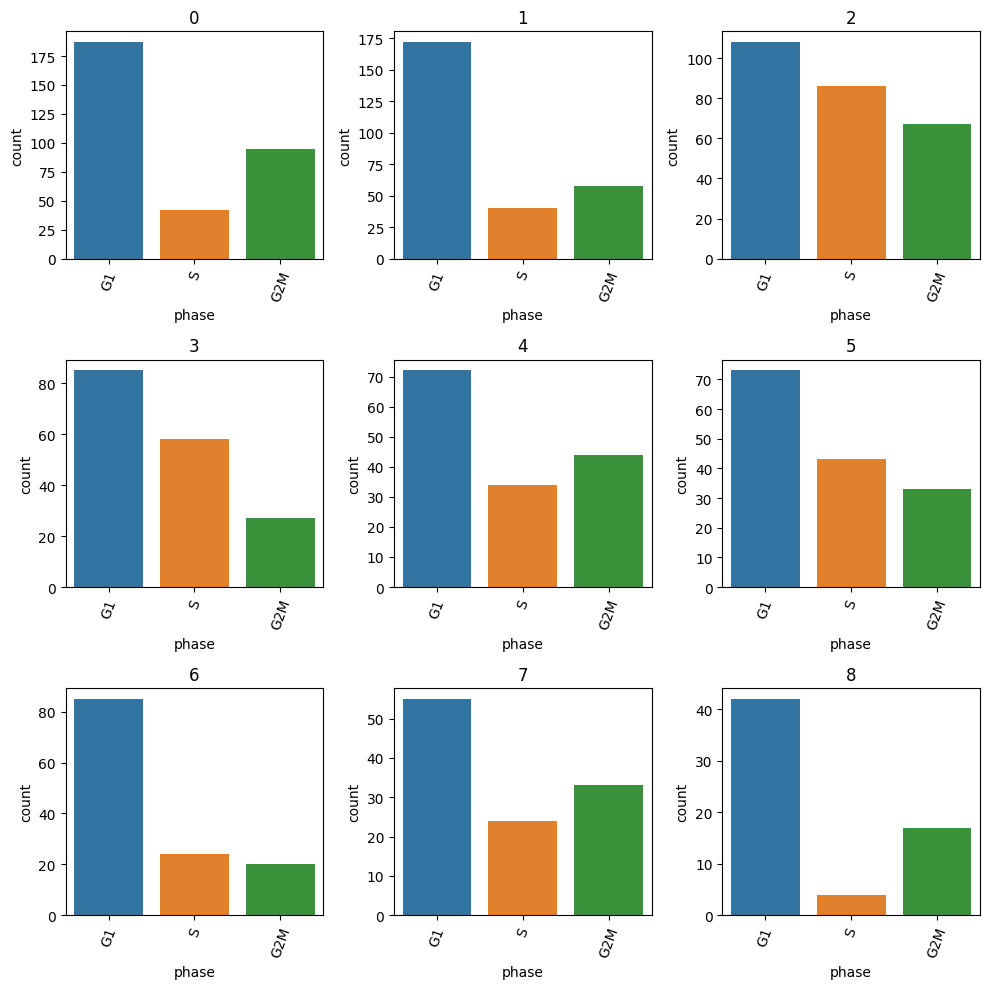

In [286]:
fig, ax = plt.subplots(nrows=int(np.ceil(len(inclusion)/3)), ncols=3, figsize=(10, 10))
for i, c in enumerate(inclusion):
    print(i, c)
    subdf = adata.obs.loc[ adata.obs["leiden_1.0"] == c]
    snsFig = sns.countplot(x='phase', data=subdf, order=phaseOrder,
                           ax=ax[i//3][i%3])
    snsFig.set(title=c)
    #snsFig.set_xticklabels(snsFig.get_xticks(), rotation = 45)
    for tick in snsFig.get_xticklabels():
        tick.set_rotation(70)
    
if (len(inclusion) % 3 != 0):
    for i in range(len(inclusion)%3, 3):
        j = i + (len(inclusion)//3) * 3
        ax[j//3][j%3].axis('off')
    
plt.tight_layout()
plt.savefig("SMART-seq/composition_cluster_phase.pdf", format="pdf")

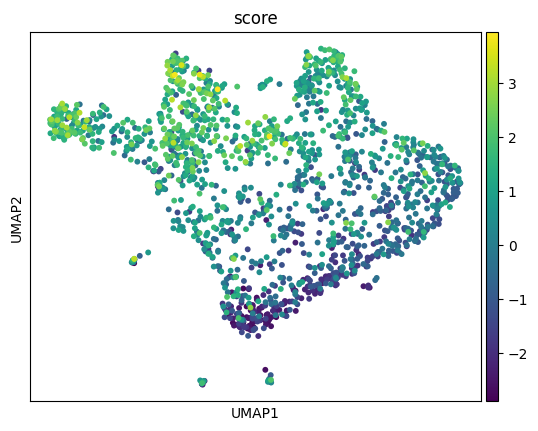

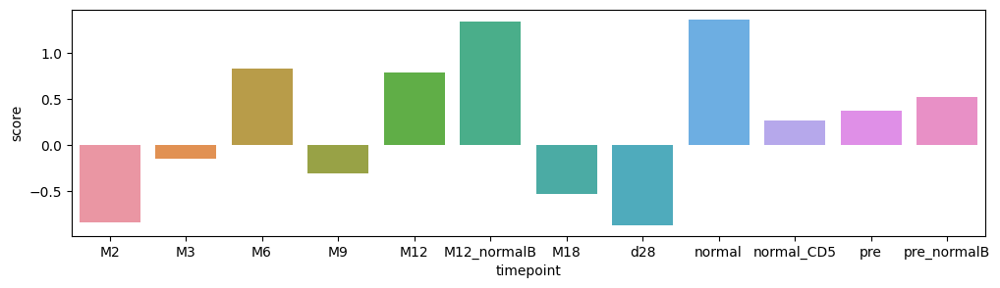

In [408]:
# Quiescent gene
genes = ["TXNIP", "TSC22D3", "BTG1", "GPR183", "KLF2", "BACH2"]
sc.tl.score_genes(adata, genes)
sc.pl.umap(adata, color="score")
plt.show()

tmpDf = adata.obs.groupby("timepoint")[["score"]].mean().reset_index()

fig = plt.figure(figsize=(12,3))
ax = sns.barplot(x="timepoint", y="score", data=tmpDf)
plt.show()

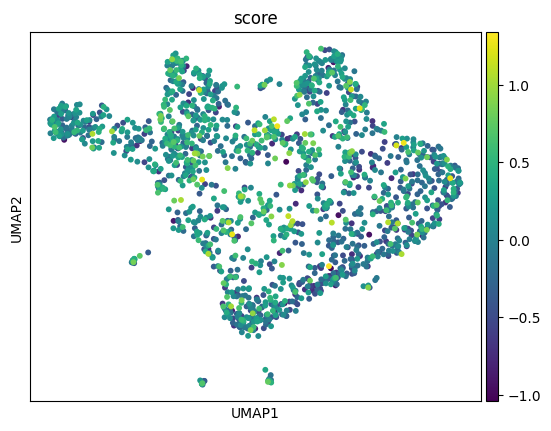

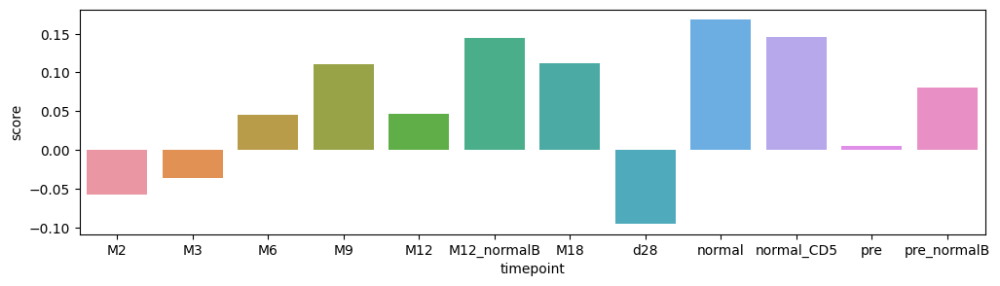

In [407]:
# Quiescent gene from https://www.ncbi.nlm.nih.gov/pmc/articles/PMC8186478/
genes = ["SCRG1", "PTPRZ1", "PLP1", "PRCP", "S100B", "PTN",
        "GPM6B", "SOX4", "BEX1", "SAT1"]
sc.tl.score_genes(adata, genes)
sc.pl.umap(adata, color="score")
plt.show()

tmpDf = adata.obs.groupby("timepoint")[["score"]].mean().reset_index()

fig = plt.figure(figsize=(12,3))
ax = sns.barplot(x="timepoint", y="score", data=tmpDf)
plt.show()

In [365]:
def hollowboxplot(data, x=None, y=None, hue=None, palette=None, ax=None, color=None, 
                  order=None, hue_order=None, jitter=True):
    snsFig = sns.boxplot(x=x, y=y, hue=hue, data=data, hue_order=hue_order, order=order,
                         showfliers = False, palette=palette, ax=ax)
    for i,box in enumerate([p for p in snsFig.patches if not p.get_label()]): 
        color = box.get_facecolor()
        box.set_edgecolor(color)
        box.set_facecolor('white')
        # iterate over whiskers and median lines
        for j in range(5*i,5*(i+1)):
             snsFig.lines[j].set_color(color)
    if (hue):
        snsFig = sns.stripplot(x=x, y=y, hue=hue, data=data, hue_order=hue_order, order=order,
                             jitter=jitter, dodge=True, palette=palette, ax=snsFig)
    else:
        snsFig = sns.stripplot(x=x, y=y, hue=x, data=data, hue_order=hue_order, order=order,
                             jitter=jitter, dodge=False, palette=palette, ax=snsFig)
    return snsFig

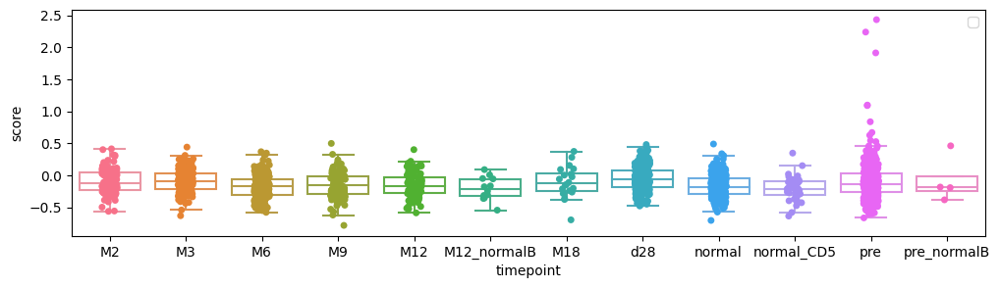

In [425]:
sc.tl.score_genes(adata, s_genes)
#tmpDf = adata.obs.groupby("timepoint")[["score"]].mean().reset_index()

fig = plt.figure(figsize=(12,3))
ax = hollowboxplot(x="timepoint", y="score", data=adata.obs)
ax.legend([])
plt.show()

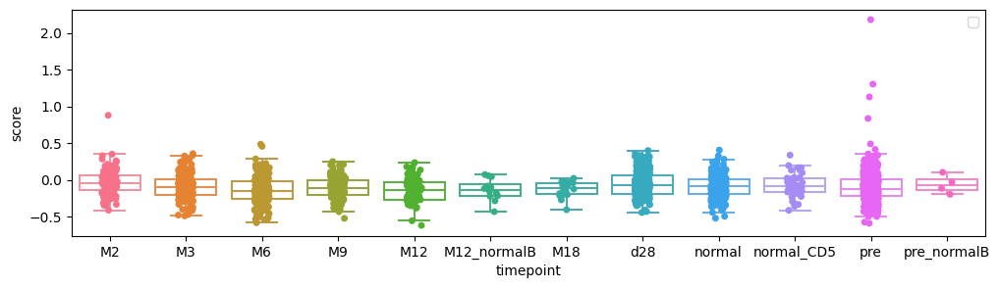

In [427]:
sc.tl.score_genes(adata, g2m_genes)
tmpDf = adata.obs.groupby("timepoint")[["score"]].mean().reset_index()

fig = plt.figure(figsize=(12,3))
#ax = sns.barplot(x="timepoint", y="score", data=tmpDf)
ax = hollowboxplot(x="timepoint", y="score", data=adata.obs)
ax.legend([])
plt.show()

In [418]:
tmpDf = adata.obs.groupby(["timepoint", "patient"])[["score"]].mean().reset_index()
tmpDf[ tmpDf.patient == "1039747"]

,timepoint,patient,score
9,M2,1039747,-0.019460
23,M3,1039747,-0.102323
37,M6,1039747,-0.144583
51,M9,1039747,NaN
65,M12,1039747,NaN
79,M12_normalB,1039747,NaN
93,M18,1039747,NaN
107,d28,1039747,-0.047100
121,normal,1039747,NaN
135,normal_CD5,1039747,NaN


### rank_gene_groups

In [88]:
inclusion = []
for i in range(clusterCnt):
    inclusion.append(i)

In [354]:
adata.uns["log1p"]["base"] = None
sc.tl.rank_genes_groups(adata, groupby="leiden_1.0", 
                        method='wilcoxon',
                        groups=clusterList)

In [364]:
for i,l in enumerate(adata.uns["rank_genes_groups"]['names']):
    if ('FRK' in l):
        print(i, l)
        break

17 ('CXCR4', 'AC107204.1', 'FRK', 'CALM1', 'MT-ND1', 'SPIB', 'NAP1L1')


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list


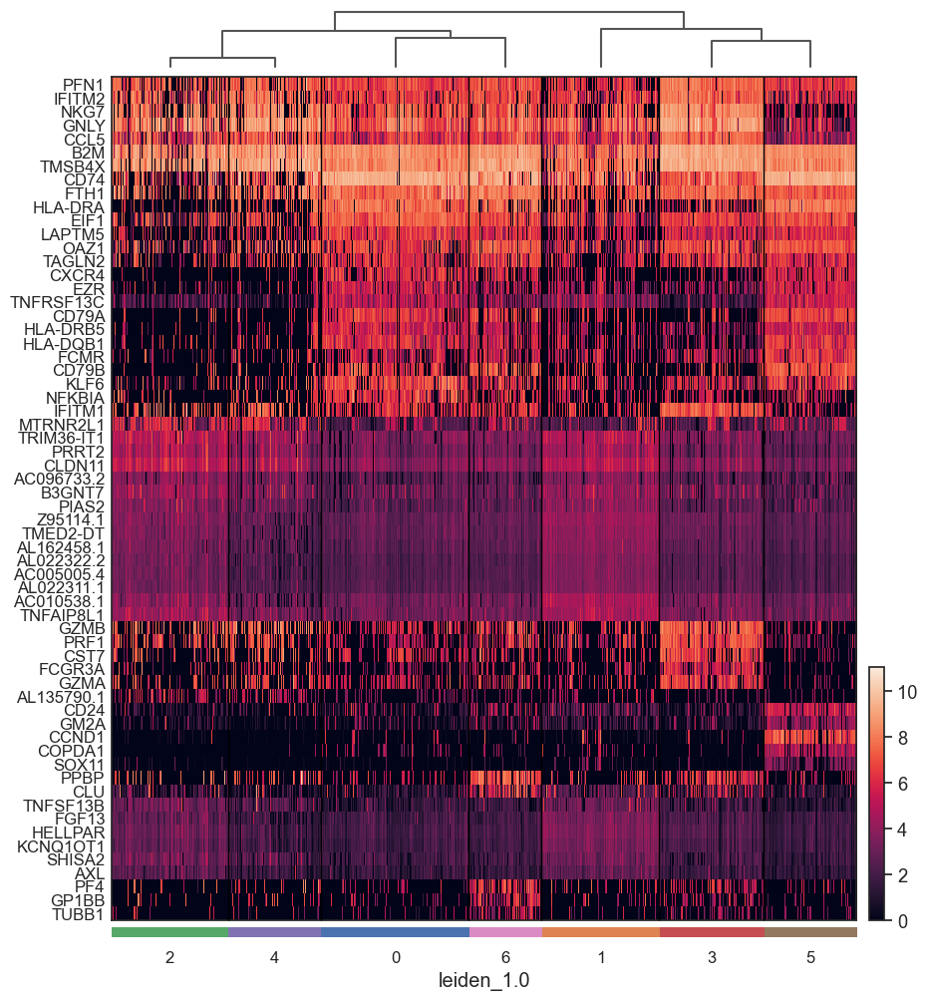

In [424]:
n = 10 # number of markers from each cluster
key = "rank_genes_groups"
clusterList = adata.uns[key]["pvals_adj"].dtype.names
markerSet = set({})
markers = []
logfoldchange = 1
for cluster in clusterList:
    cnt = 0
    for j, g in enumerate(adata.uns[key]["names"][cluster]):
        #print(i, j, g, data.uns["rank_genes_groups"]["pvals_adj"][i][j])
        if (adata.uns[key]["pvals_adj"][cluster][j] >= 0.05):
            continue
        if (g.startswith("RP") or g.startswith("MT-")):
            continue
        if (g not in markerSet):
            markers.append(g)
            markerSet.add(g)
        cnt += 1
        if (cnt >= n):
            break
            
markerAdata = adata.raw.to_adata()[:, markers]
markerX = markerAdata.X.toarray().T

Z = sp.cluster.hierarchy.linkage(markerX, 'complete')
markersReorder = [markers[int(i)] for i in sp.cluster.hierarchy.leaves_list(Z)]

sc.pl.rank_genes_groups_heatmap(adata[adata.obs["leiden_1.0"].isin(clusterList)], 
                       show_gene_labels=True, 
                       key=key, var_names=markersReorder,
                       swap_axes=True, show=False)

plt.savefig("SMART-seq/rank_genes_group_heatmap.pdf", 
                format="pdf")

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


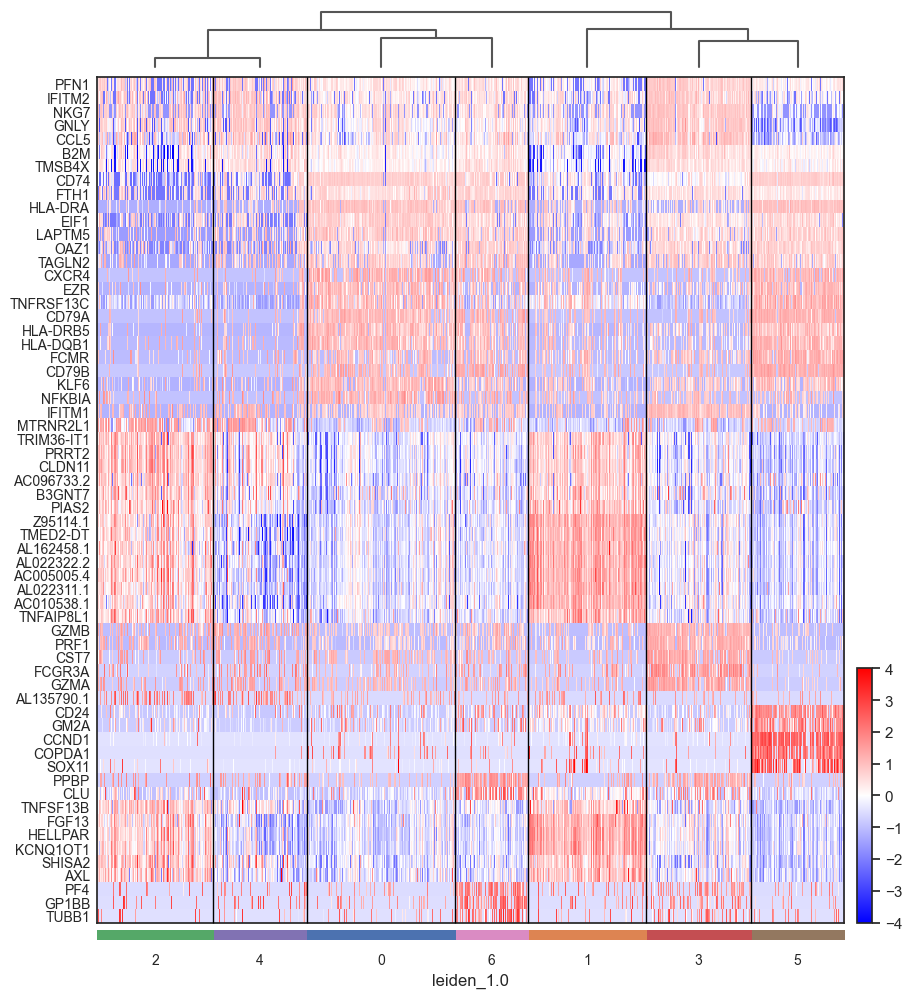

In [411]:
zscoreVisDf = adata.raw.to_adata()[ adata.obs["leiden_1.0"].isin(clusterList)].copy()
zscoreVisDf = zscoreVisDf[:, markers]
sc.pp.scale(zscoreVisDf)

sc.pl.rank_genes_groups_heatmap(zscoreVisDf, 
                       show_gene_labels=True, 
                       key="rank_genes_groups", var_names=markersReorder,
                       swap_axes=True, show=False, cmap="bwr",
                        vmax=4, vmin=-4)
plt.savefig("SMART-seq/rank_genes_group_heatmap_zscore.pdf", 
                format="pdf")

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


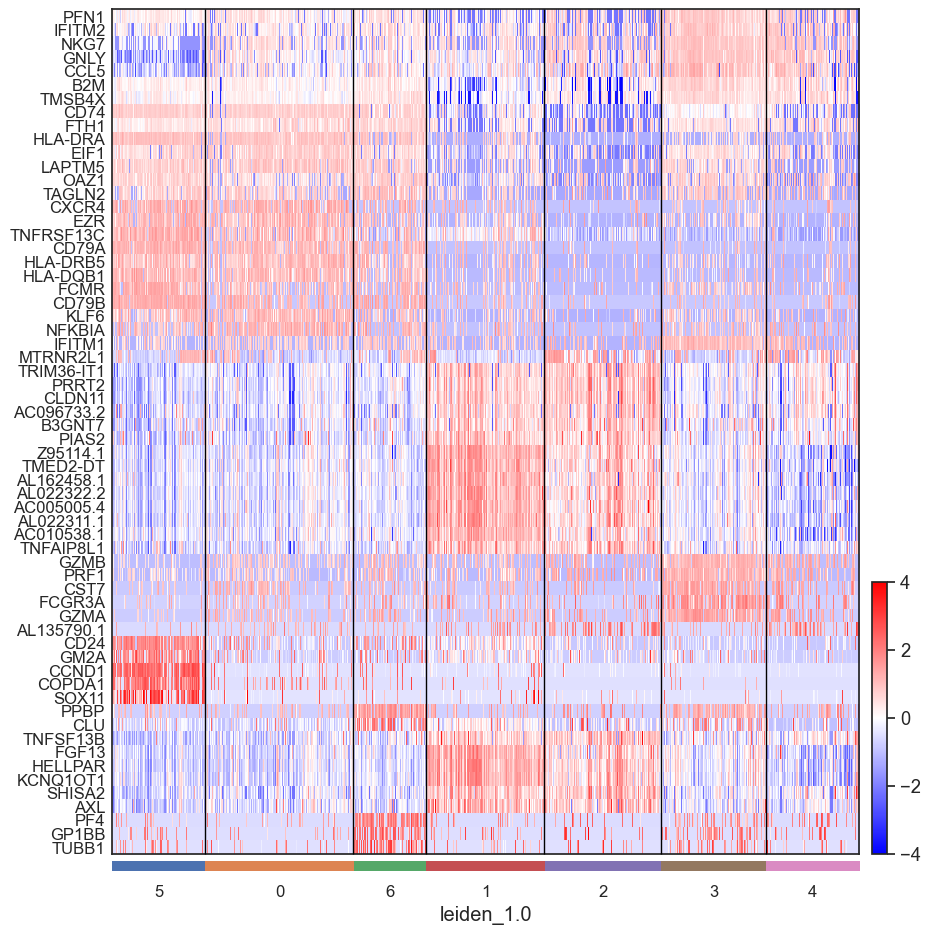

In [429]:
zscoreVisDf = adata.raw.to_adata()[ adata.obs["leiden_1.0"].isin(clusterList)].copy()
zscoreVisDf = zscoreVisDf[:, markers]
sc.pp.scale(zscoreVisDf)
order=['5','0','6','1','2','3','4']
cat_type = pd.api.types.CategoricalDtype(categories=order, ordered=True)
zscoreVisDf.obs["leiden_1.0"] = zscoreVisDf.obs["leiden_1.0"].astype(cat_type)
sc.pl.rank_genes_groups_heatmap(zscoreVisDf, 
                       show_gene_labels=True, 
                       key="rank_genes_groups", var_names=markersReorder,
                       swap_axes=True, show=False, cmap="bwr",
                                dendrogram=False,
                        vmax=4, vmin=-4)
plt.savefig("SMART-seq/rank_genes_group_heatmap_zscore_nodendrogram.pdf", 
                format="pdf")

In [428]:
zscoreVisDf.obs["leiden_1.0"]

batch1_S1      0
batch1_S10     0
batch1_S100    3
batch1_S101    3
batch1_S102    3
              ..
batch4_S95     4
batch4_S96     2
batch4_S97     2
batch4_S98     2
batch4_S99     2
Name: leiden_1.0, Length: 1551, dtype: category
Categories (7, object): ['0', '1', '2', '3', '4', '5', '6']

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


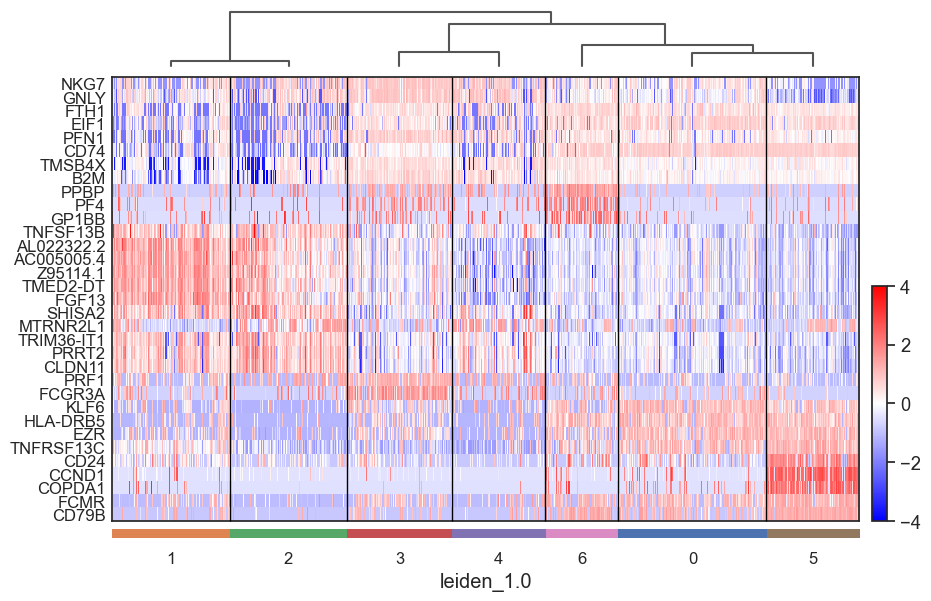

In [415]:
n = 5 # number of markers from each cluster
key = "rank_genes_groups"
clusterList = adata.uns[key]["pvals_adj"].dtype.names
markerSet = set({})
markers = []
logfoldchange = 1
for cluster in clusterList:
    cnt = 0
    for j, g in enumerate(adata.uns[key]["names"][cluster]):
        #print(i, j, g, data.uns["rank_genes_groups"]["pvals_adj"][i][j])
        if (adata.uns[key]["pvals_adj"][cluster][j] >= 0.05):
            continue
        if (g.startswith("RP") or g.startswith("MT-")):
            continue
        if (g not in markerSet):
            markers.append(g)
            markerSet.add(g)
        cnt += 1
        if (cnt >= n):
            break
            
markerAdata = adata.raw.to_adata()[:, markers]
markerX = markerAdata.X.toarray().T

Z = sp.cluster.hierarchy.linkage(markerX, 'complete')
markersReorder = [markers[int(i)] for i in sp.cluster.hierarchy.leaves_list(Z)]

#sc.pl.rank_genes_groups_heatmap(adata[adata.obs["leiden_1.0"].isin(clusterList)], 
#                       show_gene_labels=True, 
#                       key=key, var_names=markersReorder,
#                       swap_axes=True, show=False)

zscoreVisDf = adata.raw.to_adata()[ adata.obs["leiden_1.0"].isin(clusterList)].copy()
zscoreVisDf = zscoreVisDf[:, markers]
sc.pp.scale(zscoreVisDf)

sns.set(font_scale=1.2, style="white")

sc.pl.rank_genes_groups_heatmap(zscoreVisDf, 
                       show_gene_labels=True, 
                       key="rank_genes_groups", var_names=markersReorder,
                       swap_axes=True, show=False, cmap="bwr",
                        vmax=4, vmin=-4)
plt.savefig("SMART-seq/rank_genes_group_heatmap_zscore_3genepercluster.pdf", 
                format="pdf")

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


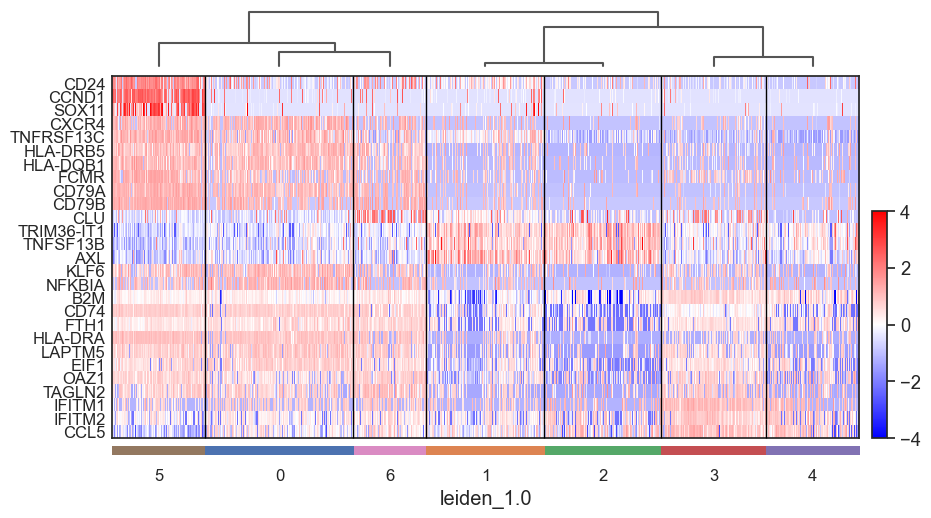

In [423]:
# Use selected gene list
key = "rank_genes_groups"
clusterList = adata.uns[key]["pvals_adj"].dtype.names
markerSet = set({})
#markers = ["B2M", "CD74", "IFITM2", "CCL5", "CD79B", "EZR",
#                  "TNFRSF13C", "HLA-DRB5", "MS4A1", "CD79A", "FCMR",
#                  "PDCD4", "KLF6", "CD37", "HLA-DRA", "HLA-DPA1", "EIF1", "LAPTM5",
#                  "IFITM1", "FRK", "CCDC191", "CD24", "CCND1", "COPDA1", "TNFSF13B"]
markers = ["CD79A", "CD79B", "TNFRSF13C", "HLA-DRA", "HLA-DRB5", "HLA-DQB1",
"FCMR","LAPTM5","CD24","TNFSF13B","CCND1","SOX11","KLF6","CLU","IFITM1",
"IFITM2","CCL5","B2M","NFKBIA","EIF1","CD74","AXL","CXCR4","FTH1",
"TRIM36-IT1","OAZ1","TAGLN2"
]           
markerAdata = adata.raw.to_adata()[:, markers]
markerX = markerAdata.X.toarray().T

Z = sp.cluster.hierarchy.linkage(markerX, 'complete')
markersReorder = [markers[int(i)] for i in sp.cluster.hierarchy.leaves_list(Z)]

#sc.pl.rank_genes_groups_heatmap(adata[adata.obs["leiden_1.0"].isin(clusterList)], 
#                       show_gene_labels=True, 
#                       key=key, var_names=markersReorder,
#                       swap_axes=True, show=False)

zscoreVisDf = adata.raw.to_adata()[ adata.obs["leiden_1.0"].isin(clusterList)].copy()
zscoreVisDf = zscoreVisDf[:, markers]
sc.pp.scale(zscoreVisDf)

sns.set(font_scale=1.2, style="white")

sc.pl.rank_genes_groups_heatmap(zscoreVisDf, 
                       show_gene_labels=True, 
                       key="rank_genes_groups", var_names=markersReorder,
                       swap_axes=True, show=False, cmap="bwr",
                        vmax=4, vmin=-4)
plt.savefig("SMART-seq/rank_genes_group_heatmap_zscore_selectedgene.pdf", 
                format="pdf")

In [421]:
sorted(markers)

['AXL',
 'B2M',
 'B2M',
 'CCL5',
 'CCND1',
 'CD24',
 'CD74',
 'CD79A',
 'CD79B',
 'CLU',
 'CXCR4',
 'CXCR4',
 'EIF1',
 'FCMR',
 'FTH1',
 'HLA-DQB1',
 'HLA-DRA',
 'HLA-DRB5',
 'IFITM1',
 'IFITM2',
 'KLF6',
 'LAPTM5',
 'NFKBIA',
 'OAZ1',
 'SOX11',
 'TAGLN2',
 'TNFRSF13C',
 'TNFSF13B',
 'TRIM36-IT1']

In [413]:
# validate whether selected marker is in the gene list
for m in ["B2M", "CD74", "IFITM2", "CCL5", "CD79B", "EZR",
                  "TNFRSF13C", "HLA-DRB5", "MS4A1", "CD79A", "FCMR",
                  "PDCD4", "KLF6", "CD37", "HLA-DRA", "HLA-DPA1", "EIF1", "LAPTM5",
                  "IFITM1", "FRK", "CCDC191", "CD24", "CCND1", "COPDA1", "TNFSF13B"]:
    if (m not in markerSet):
        print(m)

MS4A1
PDCD4
CD37
HLA-DPA1
FRK
CCDC191


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


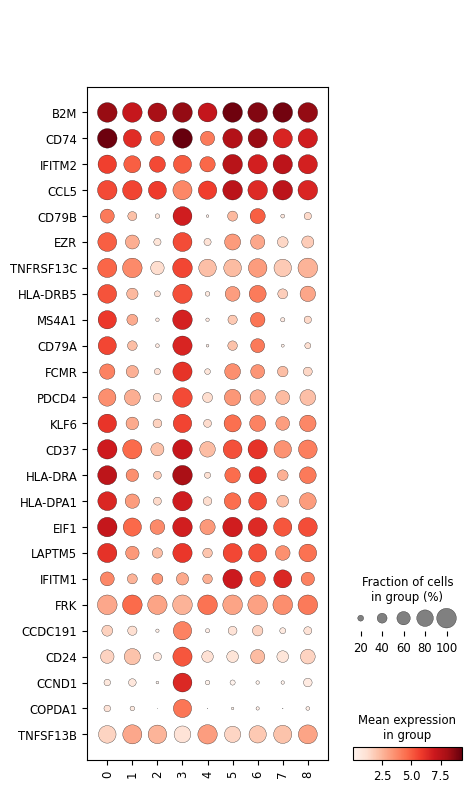

In [101]:
# dot plot
dotPlotGeneList = ["B2M", "CD74", "IFITM2", "CCL5", "CD79B", "EZR",
                  "TNFRSF13C", "HLA-DRB5", "MS4A1", "CD79A", "FCMR",
                  "PDCD4", "KLF6", "CD37", "HLA-DRA", "HLA-DPA1", "EIF1", "LAPTM5",
                  "IFITM1", "FRK", "CCDC191", "CD24", "CCND1", "COPDA1", "TNFSF13B"]
sc.pl.dotplot(adata[adata.obs["leiden_1.0"].isin(clusterList)], 
                       groupby="leiden_1.0",
                       var_names=dotPlotGeneList,
                       swap_axes=True, show=False)
plt.savefig("SMART-seq/rank_genes_group_dotplot.pdf", 
                format="pdf")

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/tools/_dendrogram.py:161: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = dat
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


{'mainplot_ax': <Axes: >,
 'group_extra_ax': <Axes: >,
 'size_legend_ax': <Axes: title={'center': 'Fraction of cells\nin group (%)'}>,
 'color_legend_ax': <Axes: title={'center': 'Mean expression\nin group'}>}

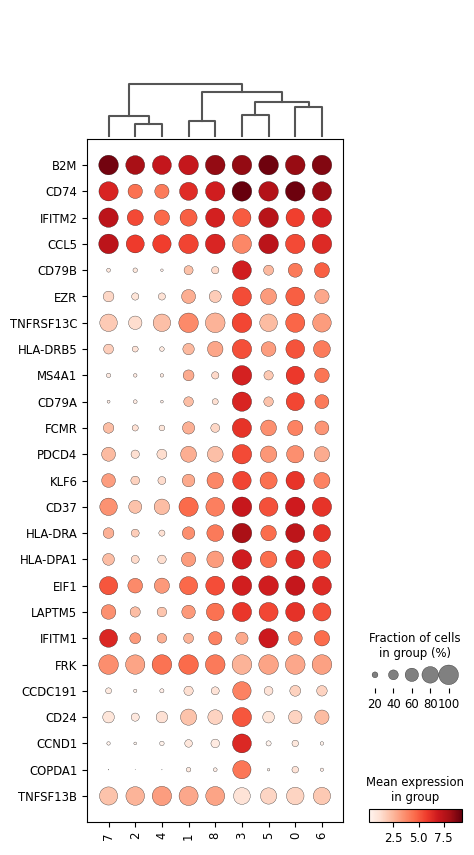

In [100]:
sc.pl.rank_genes_groups_dotplot(adata[adata.obs["leiden_1.0"].isin(clusterList)],  
                       key=key, var_names=dotPlotGeneList,
                       swap_axes=True, show=False)
#plt.savefig("SMART-seq/dotplot.pdf", 
#                format="pdf")

In [429]:
for patient in scSnpMarkerSamples:
    sampleidList = []
    classifyResult = []
    
    tmpDf = pd.read_csv("scSnpMarker/%s_cancernormal_group.tsv"%patient,
                        sep="\t", header=None)
    tmpDf = tmpDf[ tmpDf[1] != -1]
    
    sampleidList = list(tmpDf[0])
    classifyResult = list(tmpDf[1])
    
    tmpDf = pd.read_csv("scSnpMarker/%s_classify_result_wsampleid.out"%patient,
                        sep="\t", header=None)
    sampleidList.extend(tmpDf[0])
    classifyResult.extend(tmpDf[1])
    
    tmpDf = pd.DataFrame({"sampleid":sampleidList, "classify":classifyResult})
    
    tmpDf = tmpDf.merge(adata.obs, left_on="sampleid", right_index=True)
    
    ax = sns.countplot(x="leiden_1.0", hue="classify", data=tmpDf)
    ax.set(title=patient)
    plt.show()
#tmpDf

NameError: name 'scSnpMarkerSamples' is not defined

In [142]:
scSnpMarkerDf = pd.DataFrame({"sampleid":[], "ssmpred":[]})
scSnpMarkerSamples = ["895557", "1039747", "670730"]
for patient in scSnpMarkerSamples:
    sampleidList = []
    classifyResult = []
    
    tmpDf = pd.read_csv("scSnpMarker/%s_cancernormal_group.tsv"%patient,
                        sep="\t", header=None)
    tmpDf = tmpDf[ tmpDf[1] != -1]
    
    sampleidList = list(tmpDf[0])
    classifyResult = list(tmpDf[1].map({1:"tumor_t4", 0:"normal_t4"}))
    
    tmpDf = pd.read_csv("scSnpMarker/%s_classify_result_wsampleid.out"%patient,
                        sep="\t", header=None)
    sampleidList.extend(tmpDf[0])
    classifyResult.extend(list(tmpDf[1].map({1:"tumor_infer", 0:"normal_infer",
                                       -1:"unknown"})))
    
    tmpDf = pd.DataFrame({"sampleid":sampleidList, "ssmpred":classifyResult})
    scSnpMarkerDf = pd.concat([scSnpMarkerDf, tmpDf], ignore_index=True)

#scSnpMarkerDf["ssmpred"] = scSnpMarkerDf["ssmpred"].astype(int)
#tmpDf

In [109]:
sampleidList

['batch4_S281',
 'batch4_S285',
 'batch4_S259',
 'batch4_S298',
 'batch4_S300',
 'batch4_S295',
 'batch4_S265',
 'batch4_S277',
 'batch4_S283',
 'batch4_S269',
 'batch4_S286',
 'batch4_S260',
 'batch4_S274',
 'batch4_S267',
 'batch4_S290',
 'batch4_S261',
 'batch4_S288',
 'batch4_S301',
 'batch4_S280',
 'batch4_S297',
 'batch4_S296',
 'batch4_S284',
 'batch4_S262',
 'batch4_S282',
 'batch4_S291',
 'batch4_S279',
 'batch4_S292',
 'batch4_S272',
 'batch4_S273',
 'batch4_S270',
 'batch4_S299',
 'batch4_S257',
 'batch4_S357',
 'batch4_S372',
 'batch4_S369',
 'batch4_S464',
 'batch4_S351',
 'batch4_S368',
 'batch4_S467',
 'batch4_S445',
 'batch4_S433',
 'batch4_S470',
 'batch4_S375',
 'batch4_S462',
 'batch4_S352',
 'batch4_S384',
 'batch4_S359',
 'batch4_S370',
 'batch4_S376',
 'batch4_S448',
 'batch4_S465',
 'batch4_S439',
 'batch4_S342',
 'batch4_S381',
 'batch4_S340',
 'batch4_S358',
 'batch4_S362',
 'batch4_S363',
 'batch4_S349',
 'batch4_S453',
 'batch4_S442',
 'batch4_S361',
 'batch4

In [143]:
adata.obs = adata.obs.drop(["ssmpred"], axis=1)

In [144]:
adata.obs = adata.obs.merge(scSnpMarkerDf.set_index("sampleid"), 
                left_index=True, right_index=True, how="left")

In [112]:
adata.obs["ssmpred"] = adata.obs["ssmpred"].fillna("Unknown")

KeyError: 'ssmpred'

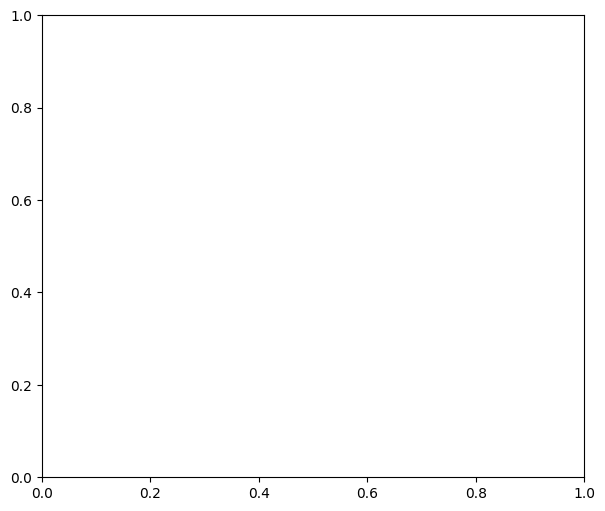

In [428]:
with plt.rc_context({"figure.figsize": (7, 6)}):
    mypalette = sns.color_palette(None, 5)
    mypalette[1], mypalette[2] = mypalette[2], mypalette[1]
    ax = sc.pl.umap(adata[ adata.obs["patient"].isin(["895557", "1039747"])], 
                color=["ssmpred"], palette=mypalette,
                show=False, ncols=1,
               size=60)
plt.tight_layout()
plt.savefig("scSnpMarker/umap.pdf", format="pdf")


In [129]:
sns.color_palette(None, 5)

[(0.12156862745098039, 0.4666666666666667, 0.7058823529411765),
 (1.0, 0.4980392156862745, 0.054901960784313725),
 (0.17254901960784313, 0.6274509803921569, 0.17254901960784313),
 (0.8392156862745098, 0.15294117647058825, 0.1568627450980392),
 (0.5803921568627451, 0.403921568627451, 0.7411764705882353)]

In [40]:
pd.read_csv("scSnpMarker/%s_cancernormal_group.tsv"%patient,
                        sep="\t", header=None)

,0,1
0,batch3_S241,1
1,batch3_S254,1
2,batch3_S220,1
3,batch3_S225,1
4,batch3_S246,1
...,...,...
226,batch3_S265,-1
227,batch3_S284,-1
228,batch3_S223,-1
229,batch3_S342,-1


In [20]:
tmpDf

,batch4_S325,1,895557_d28
0,batch4_S322,1,895557_d28
1,batch4_S316,1,895557_d28
2,batch4_S335,-1,895557_M2
3,batch4_S367,1,895557_M6
4,batch4_S461,-1,895557_M9
...,...,...,...
68,batch4_S289,1,895557_pre
69,batch4_S336,1,895557_M2
70,batch4_S341,-1,895557_M3
71,batch4_S302,1,895557_pre


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list


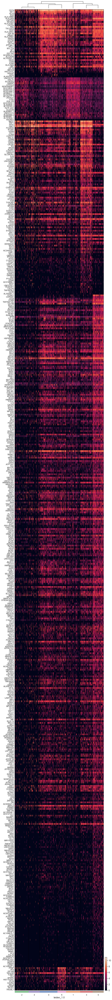

In [91]:
# List all the DEG 
key = "rank_genes_groups"
clusterList = adata.uns[key]["pvals_adj"].dtype.names
markerSet = set({})
markers = []
for cluster in clusterList:
    cnt = 0
    for j, g in enumerate(adata.uns[key]["names"][cluster]):
        #print(i, j, g, data.uns["rank_genes_groups"]["pvals_adj"][i][j])
        if (adata.uns[key]["pvals_adj"][cluster][j] >= 0.05
           or adata.uns[key]["logfoldchanges"][cluster][j] < 3):
            continue
        if (g.startswith("RP") or g.startswith("MT-")):
            continue
        if (g not in markerSet):
            markers.append(g)
            markerSet.add(g)
        
sc.pl.rank_genes_groups_heatmap(adata[adata.obs["leiden_1.0"].isin(clusterList)], 
                       show_gene_labels=True, 
                       key=key, var_names=list(markers),
                       swap_axes=True, show=False)

plt.savefig("SMART-seq/rank_genes_group_heatmap_full.pdf", 
                format="pdf")

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


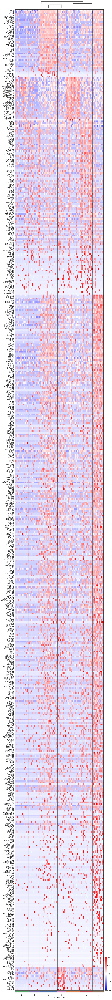

In [92]:
zscoreVisDf = adata.raw.to_adata()[ adata.obs["leiden_1.0"].isin(clusterList)].copy()
zscoreVisDf = zscoreVisDf[:, markers]
sc.pp.scale(zscoreVisDf)

sc.pl.rank_genes_groups_heatmap(zscoreVisDf, 
                       show_gene_labels=True, 
                       key="rank_genes_groups", var_names=list(markers),
                       swap_axes=True, show=False, cmap="bwr",
                        vmin=-4, vmax=4)
plt.savefig("SMART-seq/rank_genes_group_heatmap_full_zscore.pdf", 
                format="pdf")

#### Rank gene analysis for some other feature split

In [470]:
feature = "cd19 expression"
adata.uns["log1p"]["base"] = None
subAdata = adata[ adata.obs["reduced_time"] == "M1-3"]
# Add a column for reduced time point
tmp = {}
for t in ["low", "pos"]:
    tmp[t] = "pos"
tmp["neg"] = "neg"
tmp["Unknown"] = "Unknown"
subAdata.obs["cd19_3cat"] = adata.obs["cd19 expression"].map(tmp)
sc.tl.rank_genes_groups(subAdata, groupby="cd19_3cat", 
                        method='wilcoxon',
                        groups=["pos", "neg"])

/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_25964/2627348363.py:10: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  subAdata.obs["cd19_3cat"] = adata.obs["cd19 expression"].map(tmp)


In [471]:
subAdata.obs["cd19_3cat"].value_counts()

cd19_3cat
pos        237
Unknown    162
neg        128
Name: count, dtype: int64

In [431]:
feature = "cd19 expression"

In [456]:
subAdata.uns

{'hvg': {'flavor': 'seurat_v3'},
 'leiden': {'params': {'n_iterations': -1,
   'random_state': 0,
   'resolution': 1.0}},
 'log1p': {'base': None},
 'neighbors': {'connectivities_key': 'connectivities',
  'distances_key': 'distances',
  'params': {'method': 'umap',
   'metric': 'euclidean',
   'n_neighbors': 15,
   'random_state': 0,
   'use_rep': 'X_pca_harmony'}},
 'pca': {'params': {'use_highly_variable': True, 'zero_center': True},
  'variance': array([47.39982877, 38.23246872, 16.29588122,  8.39737613,  7.4633844 ,
          6.20159917,  5.73684919,  5.53006697,  5.2537388 ,  5.07423003,
          4.97893245,  4.87470403,  4.71486302,  4.53426874,  4.51714791,
          4.49010033,  4.44489652,  4.40574166,  4.39420585,  4.34643906,
          4.3218647 ,  4.31390891,  4.28061429,  4.24345189,  4.22191991,
          4.19436396,  4.18870827,  4.16718323,  4.14749033,  4.12762861,
          4.11847717,  4.09874573,  4.08374137,  4.06193937,  4.04789298,
          4.01933898,  4.01601

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_25964/3479107790.py:43: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


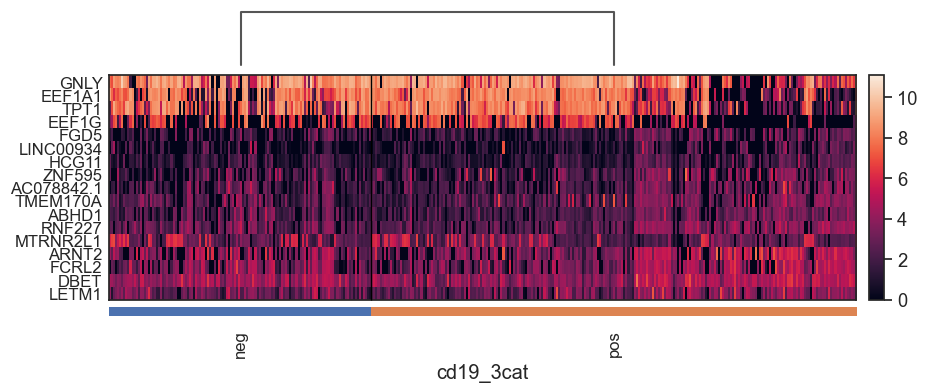

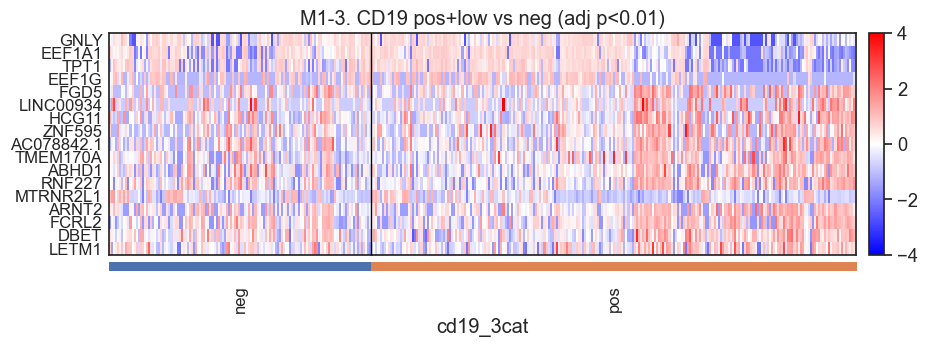

In [480]:
n = 100000 # number of markers from each cluster
key = "rank_genes_groups"
#clusterList = subAdata.uns[key]["pvals_adj"].dtype.names
markerSet = set({})
markers = []
logfoldchange = 1
for cluster in ["pos", "neg"]:
    cnt = 0
    for j, g in enumerate(subAdata.uns[key]["names"][cluster]):
        #print(i, j, g, data.uns["rank_genes_groups"]["pvals_adj"][i][j])
        if (subAdata.uns[key]["pvals_adj"][cluster][j] >= 0.01):
            continue
        if (g.startswith("RP") or g.startswith("MT-")):
            continue
        if (g not in markerSet):
            markers.append(g)
            markerSet.add(g)
        cnt += 1
        if (cnt >= n):
            break
            
markerAdata = subAdata.raw.to_adata()[:, markers]
markerX = markerAdata.X.toarray().T

Z = sp.cluster.hierarchy.linkage(markerX, 'complete')
markersReorder = [markers[int(i)] for i in sp.cluster.hierarchy.leaves_list(Z)]

sc.pl.rank_genes_groups_heatmap(subAdata[subAdata.obs["cd19_3cat"].isin(["pos", "neg"])], 
                       show_gene_labels=True, 
                       key=key, var_names=markersReorder,
                       swap_axes=True, show=False)

zscoreVisDf = subAdata.raw.to_adata().copy()
zscoreVisDf = zscoreVisDf[:, markersReorder]
sc.pp.scale(zscoreVisDf)

ax=sc.pl.rank_genes_groups_heatmap(zscoreVisDf[ zscoreVisDf.obs["cd19_3cat"].isin(["pos", "neg"])], 
                       show_gene_labels=True, 
                       key="rank_genes_groups", var_names=markersReorder,
                       swap_axes=True, show=False, cmap="bwr",
                        vmin=-4, vmax=4, dendrogram=False)
ax["heatmap_ax"].set_title("M1-3. CD19 pos+low vs neg (adj p<0.01)")
plt.tight_layout()
plt.savefig("SMART-seq/rank_genes_group_heatmap_cd19_zscore.pdf", 
                format="pdf")

/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_25964/1607045596.py:11: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  subAdata.obs["cd19_3cat"] = adata.obs["cd19 expression"].map(tmp)


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_25964/1607045596.py:58: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


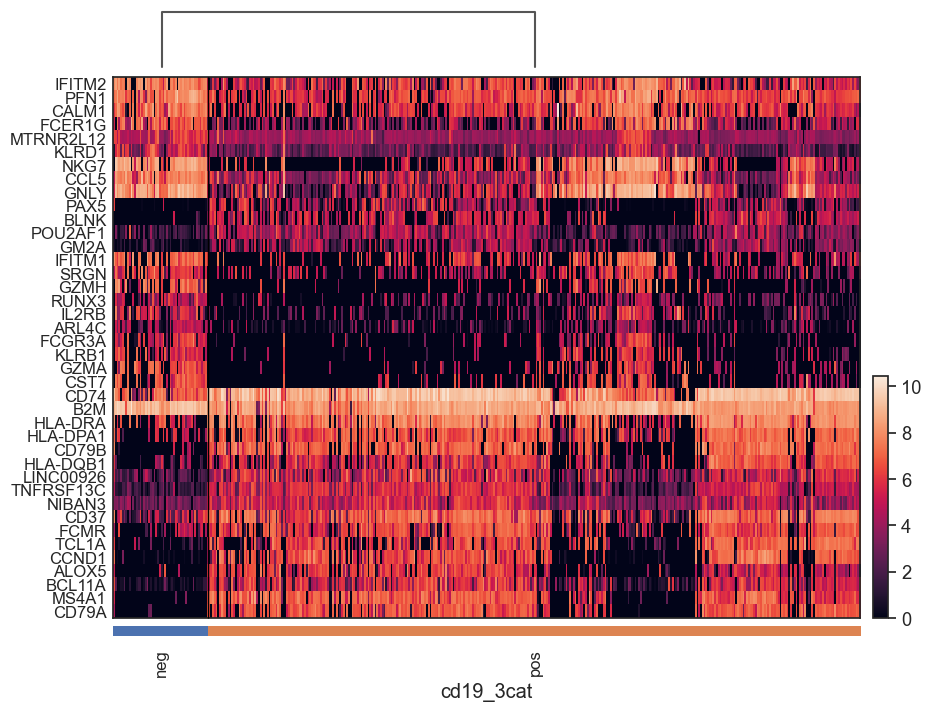

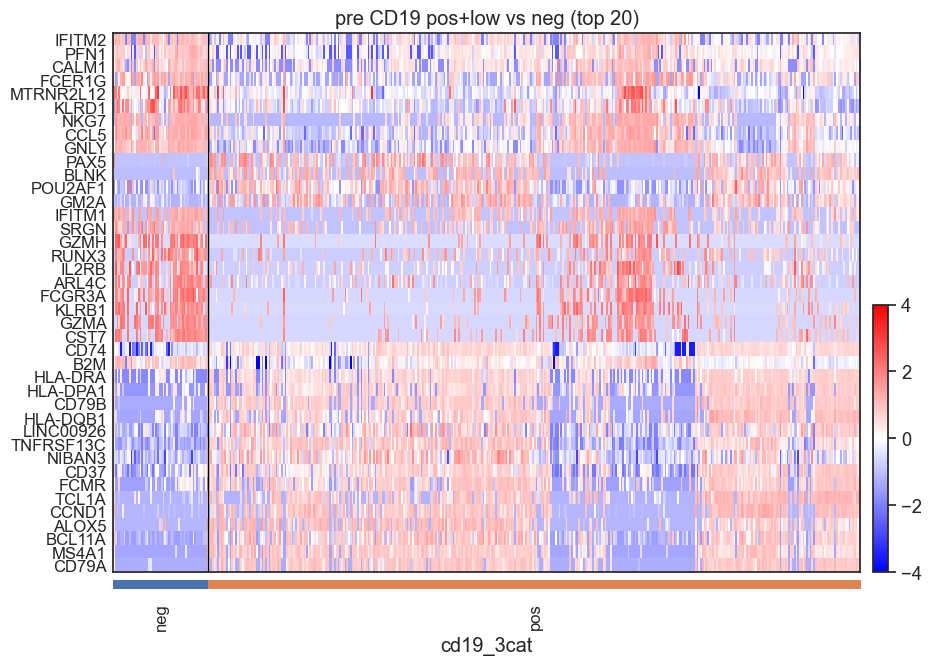

In [484]:
feature = "cd19 expression"
adata.uns["log1p"]["base"] = None
subAdata = adata[ adata.obs["reduced_time"] == "pre"]
# Add a column for reduced time point
tmp = {}
for t in ["low", "pos"]:
    tmp[t] = "pos"
tmp["low"] = "low"
tmp["neg"] = "neg"
tmp["Unknown"] = "Unknown"
subAdata.obs["cd19_3cat"] = adata.obs["cd19 expression"].map(tmp)
sc.tl.rank_genes_groups(subAdata, groupby="cd19_3cat", 
                        method='wilcoxon',
                        groups=["pos", "neg"])

n = 20 # number of markers from each cluster
key = "rank_genes_groups"
#clusterList = subAdata.uns[key]["pvals_adj"].dtype.names
markerSet = set({})
markers = []
logfoldchange = 1
for cluster in ["pos", "neg"]:
    cnt = 0
    for j, g in enumerate(subAdata.uns[key]["names"][cluster]):
        #print(i, j, g, data.uns["rank_genes_groups"]["pvals_adj"][i][j])
        if (subAdata.uns[key]["pvals_adj"][cluster][j] >= 0.05):
            continue
        if (g.startswith("RP") or g.startswith("MT-")):
            continue
        if (g not in markerSet):
            markers.append(g)
            markerSet.add(g)
        cnt += 1
        if (cnt >= n):
            break
            
markerAdata = subAdata.raw.to_adata()[:, markers]
markerX = markerAdata.X.toarray().T

Z = sp.cluster.hierarchy.linkage(markerX, 'complete')
markersReorder = [markers[int(i)] for i in sp.cluster.hierarchy.leaves_list(Z)]

sc.pl.rank_genes_groups_heatmap(subAdata[subAdata.obs["cd19_3cat"].isin(["pos", "neg"])], 
                       show_gene_labels=True, 
                       key=key, var_names=markersReorder,
                       swap_axes=True, show=False)

zscoreVisDf = subAdata.raw.to_adata().copy()
zscoreVisDf = zscoreVisDf[:, markersReorder]
sc.pp.scale(zscoreVisDf)

ax=sc.pl.rank_genes_groups_heatmap(zscoreVisDf[ zscoreVisDf.obs["cd19_3cat"].isin(["pos", "neg"])], 
                       show_gene_labels=True, 
                       key="rank_genes_groups", var_names=markersReorder,
                       swap_axes=True, show=False, cmap="bwr",
                        vmin=-4, vmax=4, dendrogram=False)
ax["heatmap_ax"].set_title("pre CD19 pos+low vs neg (top 20)")
plt.tight_layout()
plt.savefig("SMART-seq/rank_genes_group_heatmap_cd19_zscore_pre.pdf", 
                format="pdf")

#### Boxplot for specific genes

In [374]:
gene = "IFITM2"

In [389]:
geneDf = adata.obs[["reduced_time"]]
geneDf["gene"] = adata.raw.X[:, adata.raw.var.index.get_loc(gene)]

/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_25964/2130046610.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  geneDf["gene"] = adata.raw.X[:, adata.raw.var.index.get_loc(gene)]


In [395]:
def hollowboxplot(data, x=None, y=None, hue=None, palette=None, ax=None, color=None, 
                  order=None, hue_order=None, jitter=True):
    snsFig = sns.boxplot(x=x, y=y, hue=hue, data=data, hue_order=hue_order, order=order,
                         showfliers = False, palette=palette, ax=ax)
    for i,box in enumerate([p for p in snsFig.patches if not p.get_label()]): 
        color = box.get_facecolor()
        box.set_edgecolor(color)
        box.set_facecolor('white')
        # iterate over whiskers and median lines
        for j in range(5*i,5*(i+1)):
             snsFig.lines[j].set_color(color)
    if (hue):
        snsFig = sns.stripplot(x=x, y=y, hue=hue, data=data, hue_order=hue_order, order=order,
                             jitter=jitter, dodge=True, palette=palette, ax=snsFig)
    else:
        snsFig = sns.stripplot(x=x, y=y, hue=x, data=data, hue_order=hue_order, order=order,
                             jitter=jitter, dodge=False, palette=palette, ax=snsFig)
    return snsFig

In [409]:
from pvalannot import pvalannot

ModuleNotFoundError: No module named 'pvalannot'

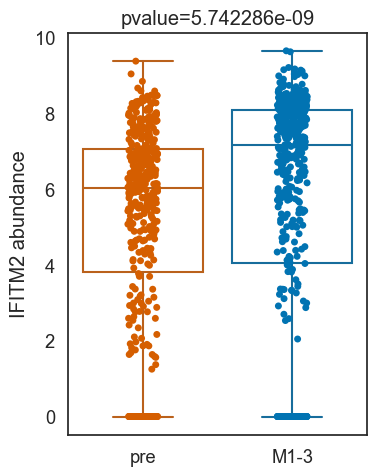

In [454]:
plt.figure(figsize=(4,5))
ax = hollowboxplot(data=geneDf, x="reduced_time", y="gene",
             order=["pre", "M1-3"], palette=reducedColorMap)
ax.set(xlabel="", ylabel=gene + " abundance")
ax.get_legend().remove()
ax.set(title="pvalue=%1e"%(sp.stats.mannwhitneyu(geneDf[ geneDf["reduced_time"] == "pre"]["gene"],
                 geneDf[ geneDf["reduced_time"] == "M1-3"]["gene"])[1]))
plt.tight_layout()
plt.savefig( "SMART-seq/" + gene + "_pre_M1-3_comp.png", dpi=300)

In [407]:
sp.stats.mannwhitneyu(geneDf[ geneDf["reduced_time"] == "pre"]["gene"],
                 geneDf[ geneDf["reduced_time"] == "M1-3"]["gene"])

MannwhitneyuResult(statistic=87715.5, pvalue=5.7422855775786e-09)

### Use pegasus to calculate marker genes

In [50]:
pgAdata = adata.copy()

In [51]:
pgAdata.X = pgAdata.X.astype(np.float32)
pg.de_analysis(pgAdata, cluster="leiden_1.0", subset=clusterList, de_key="pegasus_res")

2023-12-16 19:31:56,408 - pegasus.tools.diff_expr - INFO - CSR matrix is converted to CSC matrix. Time spent = 0.0275s.
2023-12-16 19:32:07,886 - pegasus.tools.diff_expr - INFO - MWU test and AUROC calculation are finished. Time spent = 11.4785s.
2023-12-16 19:32:07,900 - pegasus.tools.diff_expr - INFO - Sufficient statistics are collected. Time spent = 0.0139s.
2023-12-16 19:32:07,910 - pegasus.tools.diff_expr - INFO - Differential expression analysis is finished.
2023-12-16 19:32:07,911 - pegasus.tools.diff_expr - INFO - Function 'de_analysis' finished in 11.74s.


In [52]:
result = pg.markers(pgAdata, de_key="pegasus_res", alpha=0.05)

In [55]:
fc = 1
markerSet = set({})
markerList = []
for i, c in enumerate(clusterList):
    for direction in ["up", "down"]:
        for g in result[c][direction][ abs(result[c][direction]["log2FC"])>=fc].index:
            if (g.startswith("RP") or g.startswith("MT-")):
                continue
            if (g not in markerSet):
                markerSet.add(g)
                markerList.append(g)

In [56]:
len(markerList)

157

/Users/lsong/opt/anaconda3/lib/python3.9/site-packages/scanpy/tools/_dendrogram.py:161: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = dat
/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_45021/963984636.py:9: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


/Users/lsong/opt/anaconda3/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_45021/963984636.py:26: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


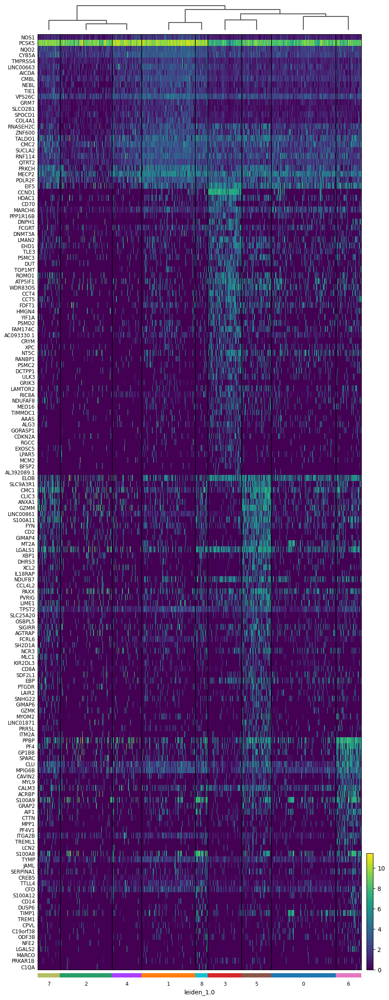

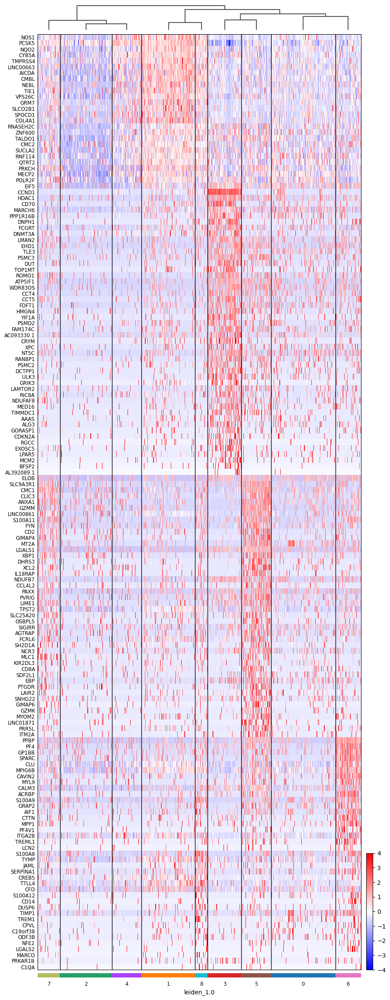

calc_mwu finished for genes in [1000, 1200).
calc_mwu finished for genes in [1400, 1600).
calc_mwu finished for genes in [600, 800).
calc_mwu finished for genes in [200, 400).
calc_mwu finished for genes in [1800, 2000).
calc_mwu finished for genes in [1600, 1800).
calc_mwu finished for genes in [1200, 1400).
calc_mwu finished for genes in [800, 1000).
calc_mwu finished for genes in [0, 200).
calc_mwu finished for genes in [400, 600).


In [58]:
method = "leiden"
resolution = 1.0
            
sc.pl.rank_genes_groups_heatmap(pgAdata[pgAdata.obs["%s_%.1f"%(method, resolution)].isin(clusterList)], 
                       show_gene_labels=True, 
                       key="rank_genes_groups", var_names=markerList,
                       swap_axes=True, show=False,
                        )
plt.tight_layout()
if (True):
    plt.savefig("SMART-seq/rank_genes_%s_%.1f_heatmap_pegasus.pdf"%(method, resolution), 
                format="pdf")

# Heatmap with z-score    
zscoreVisDf = pgAdata.raw.to_adata()[ 
    pgAdata.obs["%s_%.1f"%(method, resolution)].isin(clusterList)].copy()
zscoreVisDf = zscoreVisDf[:, markerList]
sc.pp.scale(zscoreVisDf)

sc.pl.rank_genes_groups_heatmap(zscoreVisDf, 
                       show_gene_labels=True, 
                       key="rank_genes_groups", var_names=markerList,
                       swap_axes=True, show=False, cmap="bwr",
                       vmin=-4, vmax=4)
if (True):
    plt.tight_layout()
    plt.savefig("SMART-seq/rank_genes_%s_%.1f_heatmap_pegasus_zscore.pdf"%(method, resolution), 
                format="pdf")

In [11]:
# Export the gene list
deDf = pd.DataFrame()
for i, c in enumerate(clusterList):
    for d in ["up", "down"]:
        df = result[c][d].copy()
        df["cluster"] = c
        df["direction"] = d
        deDf = pd.concat([deDf, df])
deDf.to_csv("SMART-seq/pegasus_diffexp_gene_log2fc0.6.tsv", sep="\t")

calc_mwu finished for genes in [0, 200).
calc_mwu finished for genes in [400, 600).
calc_mwu finished for genes in [1200, 1400).
calc_mwu finished for genes in [1400, 1600).
calc_mwu finished for genes in [1000, 1200).
calc_mwu finished for genes in [600, 800).
calc_mwu finished for genes in [1600, 1800).
calc_mwu finished for genes in [800, 1000).
calc_mwu finished for genes in [1800, 2000).
calc_mwu finished for genes in [200, 400).


In [13]:
# The selected pair of clustersd
pgAdata = adata.copy()
pgAdata.X = pgAdata.X.astype(np.float32)

#for p in [['5', '2'], ['6', '2'], ['1', '2']]:
for p in [['5', '6']]:
    print(p)
    pg.de_analysis(pgAdata, cluster="leiden_1.0", subset=p, de_key="pegasus_res")
    result = pg.markers(pgAdata, de_key="pegasus_res", alpha=0.05)
    deDf = pd.DataFrame()
    for i, c in enumerate(p):
        for d in ["up", "down"]:
            df = result[c][d].copy()
            df["cluster"] = c
            df["direction"] = d
            deDf = pd.concat([deDf, df])
    deDf.to_csv("SMART-seq/pegasus_diffexp_gene_cluster%s_%s.tsv"%(p[0], p[1]), sep="\t")
    

['5', '6']
2023-09-12 14:40:43,762 - pegasus.tools.diff_expr - INFO - CSR matrix is converted to CSC matrix. Time spent = 0.0050s.
2023-09-12 14:40:54,629 - pegasus.tools.diff_expr - INFO - MWU test and AUROC calculation are finished. Time spent = 10.8667s.
2023-09-12 14:40:54,634 - pegasus.tools.diff_expr - INFO - Sufficient statistics are collected. Time spent = 0.0051s.
2023-09-12 14:40:54,638 - pegasus.tools.diff_expr - INFO - Differential expression analysis is finished.
2023-09-12 14:40:54,638 - pegasus.tools.diff_expr - INFO - Function 'de_analysis' finished in 11.01s.
calc_mwu finished for genes in [400, 600).
calc_mwu finished for genes in [1800, 2000).
calc_mwu finished for genes in [1600, 1800).
calc_mwu finished for genes in [1200, 1400).
calc_mwu finished for genes in [1000, 1200).
calc_mwu finished for genes in [0, 200).
calc_mwu finished for genes in [1400, 1600).
calc_mwu finished for genes in [600, 800).
calc_mwu finished for genes in [200, 400).
calc_mwu finished for 

/Users/lsong/opt/anaconda3/lib/python3.9/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list


/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_47341/1296040676.py:15: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


/Users/lsong/opt/anaconda3/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


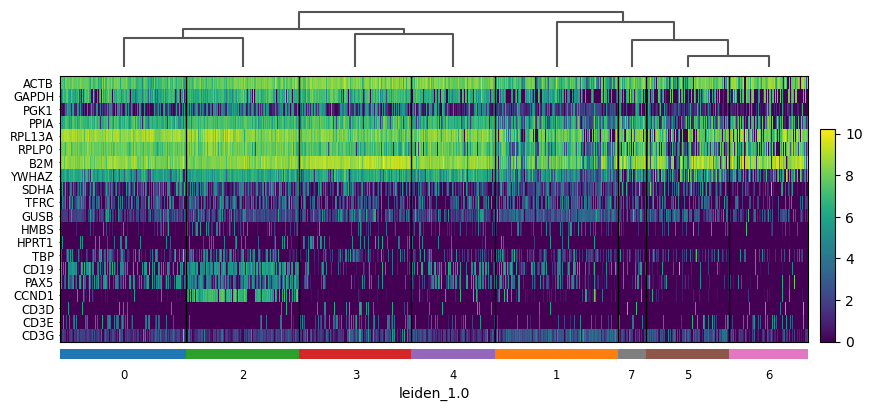

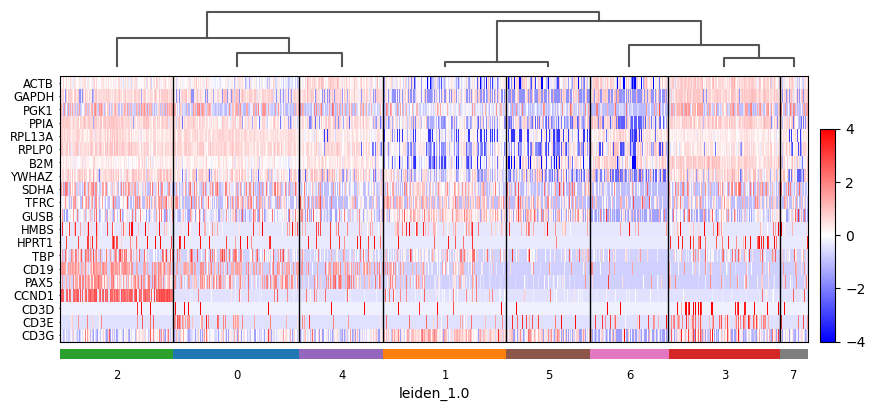

In [12]:
# Visualize housekeeping genes
# list from https://www.genomics-online.com/resources/16/5049/housekeeping-genes/
hkGenes = ["ACTB", "GAPDH", "PGK1", "PPIA", "RPL13A", "RPLP0",
          "B2M", "YWHAZ", "SDHA", "TFRC", "GUSB", "HMBS", "HPRT1", "TBP",
          "CD19", "PAX5", "CCND1", "CD3D", "CD3E", "CD3G"]

method = "leiden"
resolution = 1.0
            
sc.pl.rank_genes_groups_heatmap(adata[adata.obs["%s_%.1f"%(method, resolution)].isin(clusterList)], 
                       show_gene_labels=True, 
                       key="rank_genes_groups", var_names=hkGenes,
                       swap_axes=True, show=False,
                        )
plt.tight_layout()
if (False):
    plt.savefig("SMART-seq/rank_genes_%s_%.1f_heatmap_pegasus.pdf"%(method, resolution), 
                format="pdf")

# Heatmap with z-score    
zscoreVisDf = adata.raw.to_adata()[ 
    pgAdata.obs["%s_%.1f"%(method, resolution)].isin(clusterList)].copy()
zscoreVisDf = zscoreVisDf[:, hkGenes]
sc.pp.scale(zscoreVisDf)

sc.pl.rank_genes_groups_heatmap(zscoreVisDf, 
                       show_gene_labels=True, 
                       key="rank_genes_groups", var_names=hkGenes,
                       swap_axes=True, show=False, cmap="bwr",
                       vmin=-4, vmax=4)
if (False):
    plt.tight_layout()
    plt.savefig("SMART-seq/rank_genes_%s_%.1f_heatmap_pegasus_zscore.pdf"%(method, resolution), 
                format="pdf")

In [16]:
adata

AnnData object with n_obs × n_vars = 1582 × 2000
    obs: 'batch', 'patient', 'timepoint', 'picking', 'cd19 expression', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden_1.0'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'imrep', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'log1p', 'neighbors', 'pca'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

### Celltypist

In [17]:
import celltypist

In [18]:
from celltypist import models

In [19]:
models.download_models(force_update=True)

📜 Retrieving model list from server https://celltypist.cog.sanger.ac.uk/models/models.json
📚 Total models in list: 48
📂 Storing models in /Users/lsong/.celltypist/data/models
💾 Downloading model [1/48]: Immune_All_Low.pkl
💾 Downloading model [2/48]: Immune_All_High.pkl
💾 Downloading model [3/48]: Adult_CynomolgusMacaque_Hippocampus.pkl
💾 Downloading model [4/48]: Adult_Human_PancreaticIslet.pkl
💾 Downloading model [5/48]: Adult_Human_Skin.pkl
💾 Downloading model [6/48]: Adult_Mouse_Gut.pkl
💾 Downloading model [7/48]: Adult_Mouse_OlfactoryBulb.pkl
💾 Downloading model [8/48]: Adult_Pig_Hippocampus.pkl
💾 Downloading model [9/48]: Adult_RhesusMacaque_Hippocampus.pkl
💾 Downloading model [10/48]: Autopsy_COVID19_Lung.pkl
💾 Downloading model [11/48]: COVID19_HumanChallenge_Blood.pkl
💾 Downloading model [12/48]: COVID19_Immune_Landscape.pkl
💾 Downloading model [13/48]: Cells_Adult_Breast.pkl
💾 Downloading model [14/48]: Cells_Fetal_Lung.pkl
💾 Downloading model [15/48]: Cells_Human_Tonsil.pkl
💾

In [23]:
model = models.Model.load(model = "Immune_All_Low.pkl")

In [11]:
adataForCelltypist= sc.AnnData(combinedTPM.transpose())
adataForCelltypist.var_names_make_unique()

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/anndata/_core/anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [12]:
adataForCelltypist = adataForCelltypist[ adataForCelltypist.obs.index.isin(adata.obs.index)]

In [13]:
adataForCelltypist

View of AnnData object with n_obs × n_vars = 1683 × 34615

In [14]:
adataForCelltypist.obs = pd.merge(adataForCelltypist.obs, adata.obs, left_index=True, right_index=True)

In [15]:
sc.pp.normalize_total(adataForCelltypist, target_sum=1e4)
sc.pp.log1p(adataForCelltypist)

In [21]:
predictions= celltypist.annotate(adataForCelltypist, model="Immune_All_Low.pkl", 
                                 over_clustering = "leiden_1.0", majority_voting=True)

🔬 Input data has 1683 cells and 34615 genes
🔗 Matching reference genes in the model
🧬 6116 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
🗳️ Majority voting the predictions
✅ Majority voting done!


In [22]:
predictions.predicted_labels["over_clustering"].unique()

['0', '7', '5', '12', '3', ..., '4', '9', '11', '10', '8']
Length: 13
Categories (13, object): ['0', '1', '2', '3', ..., '9', '10', '11', '12']

In [23]:
predictionsCoarse = celltypist.annotate(adataForCelltypist, model="Immune_All_High.pkl", 
                                        over_clustering = "leiden_1.0", majority_voting=True)

🔬 Input data has 1683 cells and 34615 genes
🔗 Matching reference genes in the model
🧬 6116 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
🗳️ Majority voting the predictions
✅ Majority voting done!


In [24]:
predictions.predicted_labels["majority_voting"].value_counts()

majority_voting
CD16+ NK cells                   522
Memory CD4+ cytotoxic T cells    456
Transitional B cells             453
Late erythroid                   181
Kidney-resident macrophages       71
Name: count, dtype: int64

In [103]:
predictions.probability_matrix

,Age-associated B cells,Alveolar macrophages,B cells,CD16+ NK cells,CD16- NK cells,CD8a/a,CD8a/b(entry),CMP,CRTAM+ gamma-delta T cells,Classical monocytes,...,Transitional B cells,Transitional DC,Transitional NK,Treg(diff),Trm cytotoxic T cells,Type 1 helper T cells,Type 17 helper T cells,gamma-delta T cells,pDC,pDC precursor
batch1_S1,0.364693,0.980476,0.996166,0.893073,0.997940,0.998306,0.959663,0.999586,0.960227,0.996776,...,0.999618,0.998695,0.999979,0.999412,0.996546,0.998521,0.993413,0.995150,0.998563,0.999625
batch1_S10,0.893146,0.999023,0.999996,0.999900,0.997137,0.999993,0.999712,0.999991,0.999559,0.999630,...,0.999959,0.999997,0.999985,0.999723,0.999971,0.999475,0.999862,0.999958,0.999992,0.999994
batch1_S100,0.999804,0.999566,1.000000,1.000000,0.999037,0.999999,0.999993,1.000000,0.985574,0.999955,...,1.000000,1.000000,1.000000,1.000000,0.999986,0.999958,0.999473,0.999999,0.999999,1.000000
batch1_S101,0.997996,0.993783,0.999994,1.000000,0.642404,0.999999,0.999701,0.999996,0.733269,0.999552,...,1.000000,0.999994,0.999994,0.999992,0.983929,0.999150,0.998645,0.999917,0.999999,0.999999
batch1_S102,0.997819,0.996823,0.999997,1.000000,0.985452,1.000000,0.999763,0.999999,0.672750,0.950493,...,0.999999,0.999995,0.999996,0.999658,0.999688,0.998045,0.995516,0.999996,1.000000,0.999999
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
batch4_S95,0.952065,0.994182,1.000000,1.000000,0.995628,1.000000,0.999878,1.000000,0.908845,0.997976,...,0.999997,0.999999,1.000000,0.999977,0.999827,0.999683,0.998809,0.999991,0.999999,1.000000
batch4_S96,0.999493,0.999377,0.999987,0.999963,0.992702,0.999996,0.997936,0.999991,0.999942,0.998324,...,1.000000,1.000000,1.000000,0.999903,0.999947,0.999918,0.767276,0.999989,1.000000,1.000000
batch4_S97,0.999946,0.999769,1.000000,1.000000,0.997057,1.000000,0.999993,1.000000,0.397456,0.998782,...,1.000000,1.000000,1.000000,0.999998,0.999967,0.999984,0.999921,1.000000,1.000000,1.000000
batch4_S98,0.969624,0.999997,0.999984,1.000000,0.982967,0.999992,0.996976,0.999998,0.986118,0.999705,...,0.999999,0.999999,0.999998,0.999999,0.999994,0.616501,0.999022,0.999999,1.000000,1.000000


In [25]:
adataForCelltypist.obs["celltypist_label_fine"] = predictions.predicted_labels.loc[adataForCelltypist.obs.index, "majority_voting"]
adataForCelltypist.obs["celltypist_label_coarse"] = predictionsCoarse.predicted_labels.loc[adataForCelltypist.obs.index, "majority_voting"]

In [105]:
predictions.probability_matrix

,Age-associated B cells,Alveolar macrophages,B cells,CD16+ NK cells,CD16- NK cells,CD8a/a,CD8a/b(entry),CMP,CRTAM+ gamma-delta T cells,Classical monocytes,...,Transitional B cells,Transitional DC,Transitional NK,Treg(diff),Trm cytotoxic T cells,Type 1 helper T cells,Type 17 helper T cells,gamma-delta T cells,pDC,pDC precursor
batch1_S1,0.364693,0.980476,0.996166,0.893073,0.997940,0.998306,0.959663,0.999586,0.960227,0.996776,...,0.999618,0.998695,0.999979,0.999412,0.996546,0.998521,0.993413,0.995150,0.998563,0.999625
batch1_S10,0.893146,0.999023,0.999996,0.999900,0.997137,0.999993,0.999712,0.999991,0.999559,0.999630,...,0.999959,0.999997,0.999985,0.999723,0.999971,0.999475,0.999862,0.999958,0.999992,0.999994
batch1_S100,0.999804,0.999566,1.000000,1.000000,0.999037,0.999999,0.999993,1.000000,0.985574,0.999955,...,1.000000,1.000000,1.000000,1.000000,0.999986,0.999958,0.999473,0.999999,0.999999,1.000000
batch1_S101,0.997996,0.993783,0.999994,1.000000,0.642404,0.999999,0.999701,0.999996,0.733269,0.999552,...,1.000000,0.999994,0.999994,0.999992,0.983929,0.999150,0.998645,0.999917,0.999999,0.999999
batch1_S102,0.997819,0.996823,0.999997,1.000000,0.985452,1.000000,0.999763,0.999999,0.672750,0.950493,...,0.999999,0.999995,0.999996,0.999658,0.999688,0.998045,0.995516,0.999996,1.000000,0.999999
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
batch4_S95,0.952065,0.994182,1.000000,1.000000,0.995628,1.000000,0.999878,1.000000,0.908845,0.997976,...,0.999997,0.999999,1.000000,0.999977,0.999827,0.999683,0.998809,0.999991,0.999999,1.000000
batch4_S96,0.999493,0.999377,0.999987,0.999963,0.992702,0.999996,0.997936,0.999991,0.999942,0.998324,...,1.000000,1.000000,1.000000,0.999903,0.999947,0.999918,0.767276,0.999989,1.000000,1.000000
batch4_S97,0.999946,0.999769,1.000000,1.000000,0.997057,1.000000,0.999993,1.000000,0.397456,0.998782,...,1.000000,1.000000,1.000000,0.999998,0.999967,0.999984,0.999921,1.000000,1.000000,1.000000
batch4_S98,0.969624,0.999997,0.999984,1.000000,0.982967,0.999992,0.996976,0.999998,0.986118,0.999705,...,0.999999,0.999999,0.999998,0.999999,0.999994,0.616501,0.999022,0.999999,1.000000,1.000000


In [26]:
adataForCelltypist.obsm["X_umap"] = adata.obsm["X_umap"].copy()

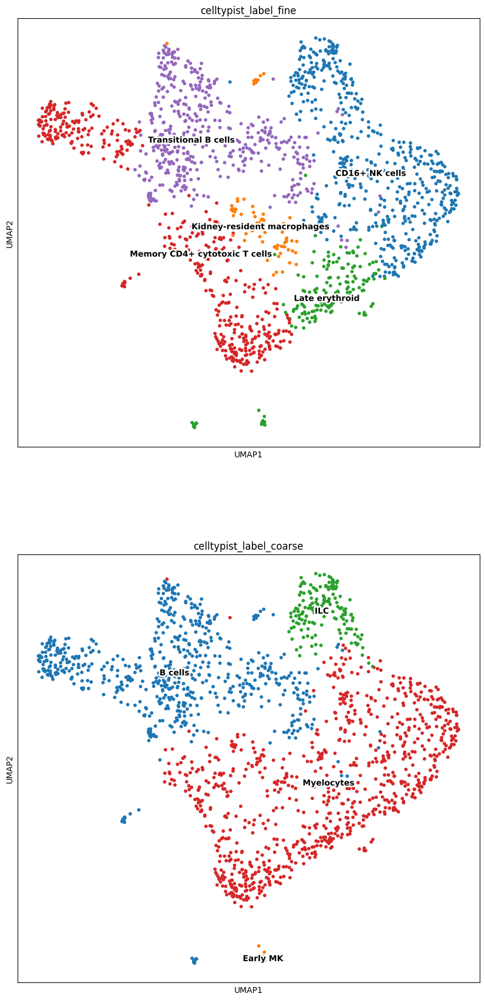

In [27]:
with plt.rc_context({"figure.figsize": (10, 10)}):
    sc.pl.umap(adataForCelltypist, color=["celltypist_label_fine", "celltypist_label_coarse"], 
               legend_loc='on data', legend_fontoutline=4,
              ncols=1)

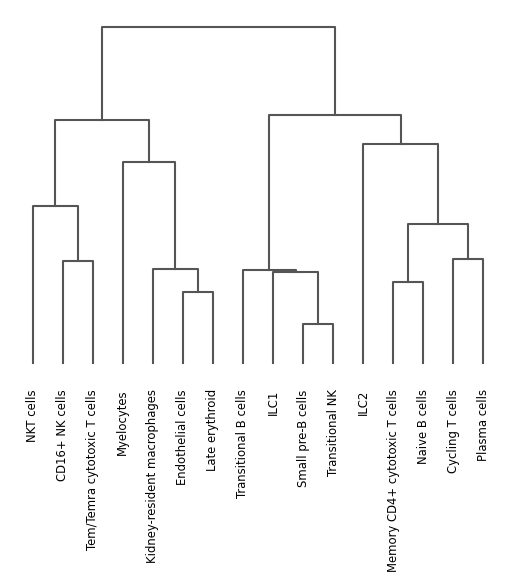

<Axes: >

In [98]:
sc.pl.dendrogram(adataForCelltypist, groupby="celltypist_label_fine")

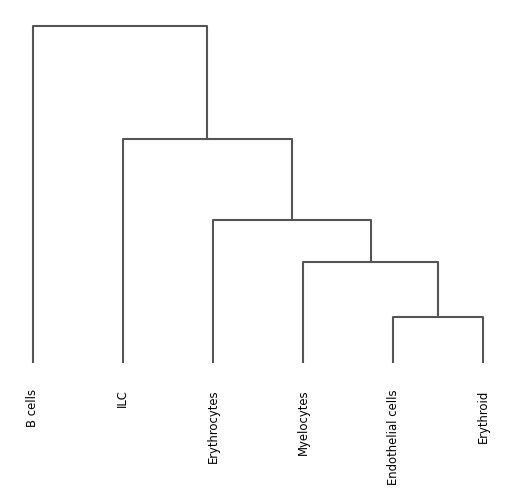

<Axes: >

In [99]:
sc.pl.dendrogram(adataForCelltypist, groupby="celltypist_label_coarse")

## Add TRUST4 results to adata

In [188]:
trust4Airr = pd.read_csv("pickseq_smartseq_airr_wmeta.tsv", sep="\t", keep_default_na=False)

In [189]:
def GetChainType( v, j, c ):
    s = ""
    if ( v != "*" and v != "" ):
        s = v 
    elif ( j != "*" and v != ""):
        s = j
    elif ( c != "*" and v != ""):
        s = c
    else:
        return -1

    if ( s[0:3] == "IGH" ):
        return 0
    elif ( s[0:3] == "IGK" ):
        return 1
    elif ( s[0:3] == "IGL" ):
        return 1 
    elif ( s[0:3] == "TRA" ):
        return 3
    elif ( s[0:3] == "TRB" ):
        return 4
    elif ( s[0:3] == "TRG" ):
        return 5
    elif ( s[0:3] == "TRD" ):
        return 6
    
    return -1 

def GetGeneType( s ):
    if ( s[3] == "V" ):
        return 0 
    elif ( s[3] == "J" ):
        return 2
    elif (s[3] == "D"):
        if (len(s) == 4):
            return 3
        else:
            return 1
    elif ( s[3] == "-" ):
        return -1
    else:
        return 3
    
chainTypeToName = ("IGH", "IGK", "IGL", "TRA", "TRB", "TRG", "TRD" )
geneTypeToName = ("V", "J", "C" )

def GetMainGeneName( g ): # remove the allele type from the gene name
    fields = g.split( "*", 1 )
    return fields[0]

In [190]:
cellTrustType = {}
for cell in adata.obs.index:
    cellTrustType[cell] = "NA" 
for i, row in trust4Airr.iterrows():
    chainType = GetChainType(row["v_call"], row["j_call"], row["c_call"])
    if (chainType <= 2):
        cellTrustType[row["cell"]] = "B" 
    elif (chainType <= 4):
        cellTrustType[row["cell"]] = "abT"
    elif (chainType <= 6):
        cellTrustType[row["cell"]] = "gdT"
cellTrustDf = pd.DataFrame.from_dict(cellTrustType, orient="index", columns=["t4type"])

In [259]:
cellTrustDf

,t4type
batch1_S1,B
batch1_S10,B
batch1_S100,NA
batch1_S101,NA
batch1_S102,NA
...,...
batch4_S96,NA
batch4_S97,NA
batch4_S98,NA
batch4_S99,NA


In [191]:
adata.obs = adata.obs.merge(cellTrustDf, left_index=True, right_index=True)

In [467]:
cellTrustDf

,t4type
batch1_S1,B
batch1_S10,B
batch1_S100,NA
batch1_S101,NA
batch1_S102,NA
...,...
batch4_S96,NA
batch4_S97,NA
batch4_S98,NA
batch4_S99,NA


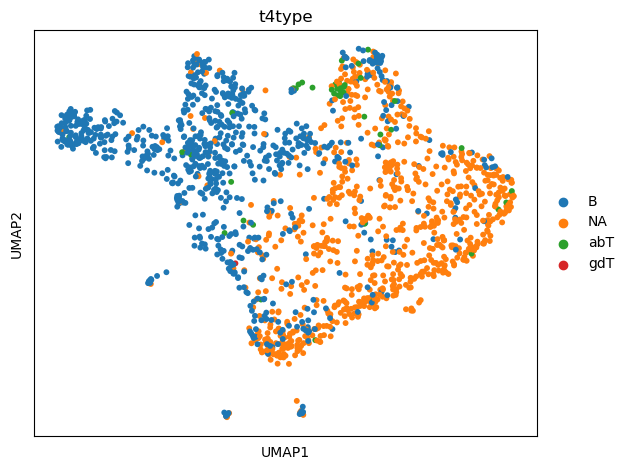

In [70]:
sc.pl.umap(adata, color=["t4type"], show=False)
plt.tight_layout()
plt.savefig("SMART-seq/umap_t4type.pdf", format="pdf")

In [99]:
adata.obs

,batch,patient,timepoint,picking,cd19 expression,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden_1.0,raw_pateint,reduced_time,t4type
batch1_S1,batch1,HD1,normal,D,pos,9753,828690.973979,57756.243776,6.969576,0,PBMC13,normal,B
batch1_S10,batch1,HD1,normal,D,pos,10188,854050.840136,38392.017611,4.495285,0,PBMC13,normal,B
batch1_S100,batch1,MCL03,pre,S,pos,11248,827730.086682,53239.283250,6.431962,3,753528,pre,NA
batch1_S101,batch1,MCL03,pre,D,pos,9026,908373.480852,41163.609974,4.531573,3,753528,pre,NA
batch1_S102,batch1,MCL03,pre,D,pos,4738,889274.342253,34622.911165,3.893389,3,753528,pre,NA
...,...,...,...,...,...,...,...,...,...,...,...,...,...
batch4_S95,batch4,MCL08,M1,D,pos,5706,828051.723576,153651.310291,18.555762,4,693381,M1-3,NA
batch4_S96,batch4,MCL08,M1,S,pos,6341,755590.221229,143769.890304,19.027495,2,693381,M1-3,NA
batch4_S97,batch4,MCL08,M1,D,pos,9039,796180.808463,60950.068853,7.655305,2,693381,M1-3,NA
batch4_S98,batch4,MCL08,M1,D,neg,7781,791343.784788,122691.448853,15.504191,2,693381,M1-3,NA


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/anndata/_core/anndata.py:1222: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


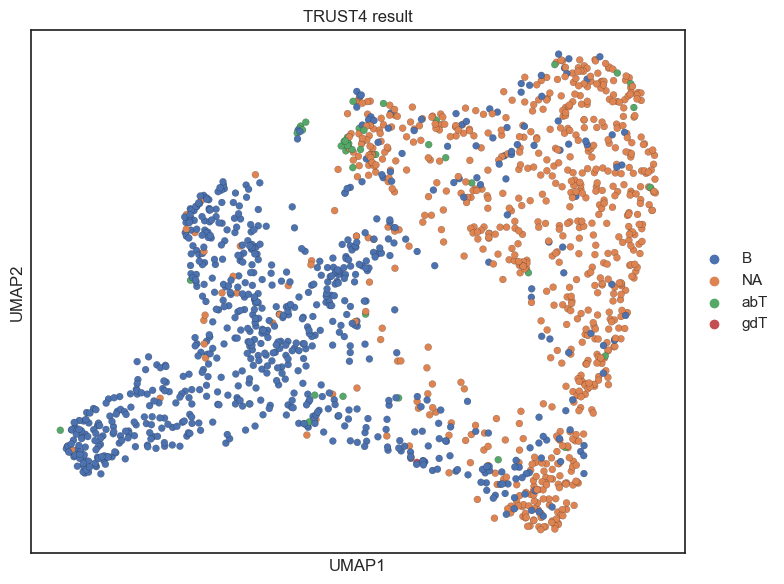

In [192]:
# FOR FINAL FIGURE
# Umap for trust4 assembly result
subAdata = adata[ adata.obs["leiden_1.0"].isin(clusterList) ]
#subAdata.obs["reduced_time"] = subAdata.obs["reduced_time"].astype("category")
#subAdata.obs["reduced_time"] = subAdata.obs["reduced_time"].cat.reorder_categories(selectedTime)
with plt.rc_context({"figure.figsize": (8, 6)}):
    ax = sc.pl.umap(subAdata, color=['t4type'],
         show=False, ncols=1, na_in_legend=False, 
           size=100, linewidth=0.1, edgecolor=[0,0,0])
    ax.set(title="TRUST4 result")
    plt.tight_layout()
    plt.savefig("./SMART-seq/umap_t4type.pdf", format="pdf")

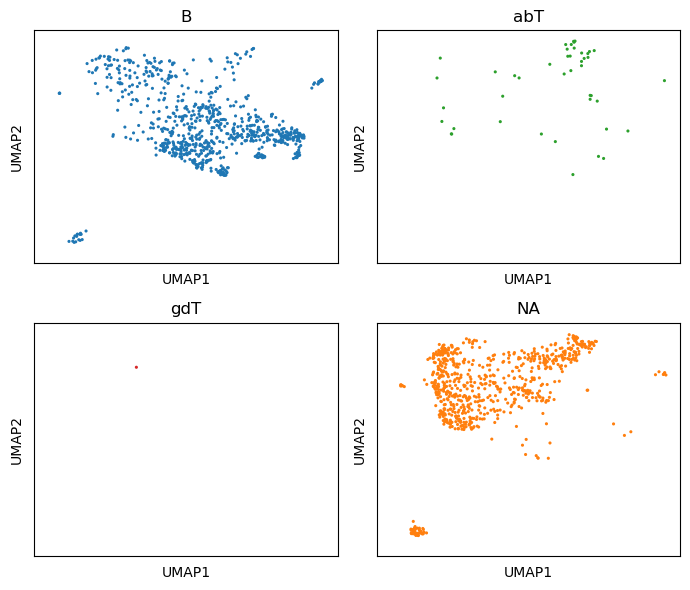

In [71]:
fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(7,6))
t4types = ["B", "abT", "gdT", "NA"]
for i, c in enumerate(t4types):
    snsFig = sc.pl.umap(adata[ adata.obs["t4type"]==c, :], color=["t4type"],
              legend_loc='', legend_fontoutline=1, show=False, size=20,
                    ax=ax[i//2][i%2], title=c)
    snsFig.set(xlim=(-6, 3), ylim=(-5, 6.5))
plt.tight_layout()
plt.savefig("SMART-seq/umap_t4type_separate.pdf", format="pdf")

In [64]:
adata.obs

,batch,patient,timepoint,picking,cd19 expression,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden_1.0,t4type
batch1_S1,batch1,PBMC13,normal,D,pos,11273,995373.382029,159933.930748,16.067732,0,B
batch1_S10,batch1,PBMC13,normal,D,pos,11762,989752.107420,91362.027842,9.230799,0,B
batch1_S100,batch1,753528,pre,S,pos,12943,986857.034991,111321.696096,11.280428,3,NA
batch1_S101,batch1,753528,pre,D,pos,10142,995689.115797,72172.774327,7.248525,3,NA
batch1_S102,batch1,753528,pre,D,pos,5096,994763.424797,75908.554398,7.630815,3,NA
...,...,...,...,...,...,...,...,...,...,...,...
batch4_S95,batch4,693381,d28,D,pos,6442,980703.263620,211381.908178,21.554115,6,NA
batch4_S96,batch4,693381,d28,S,pos,7142,983715.808278,231629.795931,23.546414,5,NA
batch4_S97,batch4,693381,d28,D,pos,10214,990689.295454,115019.627698,11.610061,5,NA
batch4_S98,batch4,693381,d28,D,neg,8801,990391.767907,204685.377703,20.667112,6,NA


In [70]:
np.max(adata.obsm["X_umap"][:, 1])

5.9688416

In [69]:
np.min(adata.obsm["X_umap"][:, 1])

-4.0121098

In [540]:
for i in adata.obs["t4type"].unique():
    print(i)

B
NA
abT
gdT


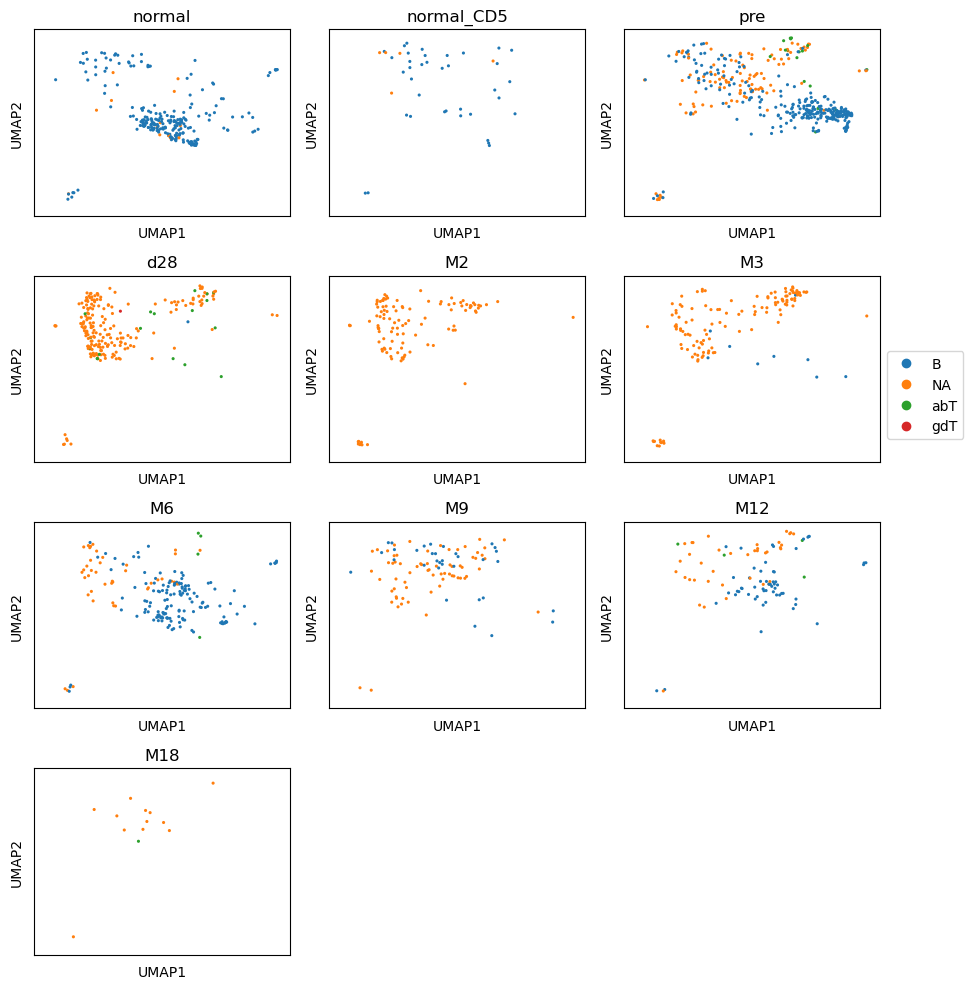

In [72]:
timepoints = ["normal", "normal_CD5", "pre", "d28",
             "M2", "M3", "M6", "M9", "M12", "M18"]
fig, ax = plt.subplots(nrows=int(np.ceil(len(timepoints)/3)), ncols=3, figsize=(9, 10))
for i, t in enumerate(timepoints):
    #print(i, t)
    snsFig = sc.pl.umap(adata[adata.obs["timepoint"]==t, :], color=["t4type"],
              legend_loc="", legend_fontoutline=1, show=False, size=20,
                    ax=ax[i//3][i%3], title=t)
    snsFig.set(xlim=(-6, 3), ylim=(-5, 6.5))
        
for i in range(len(timepoints)%3, 3):
    j = i + len(timepoints) - 1
    ax[j//3][j%3].axis('off')
    
dots = []
for i, t in enumerate(adata.obs["t4type"].unique()):
    dots.append(Line2D([0], [0], marker='o', linestyle='',
                       color = adata.uns["t4type_colors"][i], label=t))
plt.tight_layout()
plt.legend(handles=dots, bbox_to_anchor=(1,3), loc='center left')
plt.savefig("SMART-seq/umap_timepoint_t4type_separate.pdf", format="pdf")

0 0
1 1
2 2
3 3
4 4
5 5
6 6


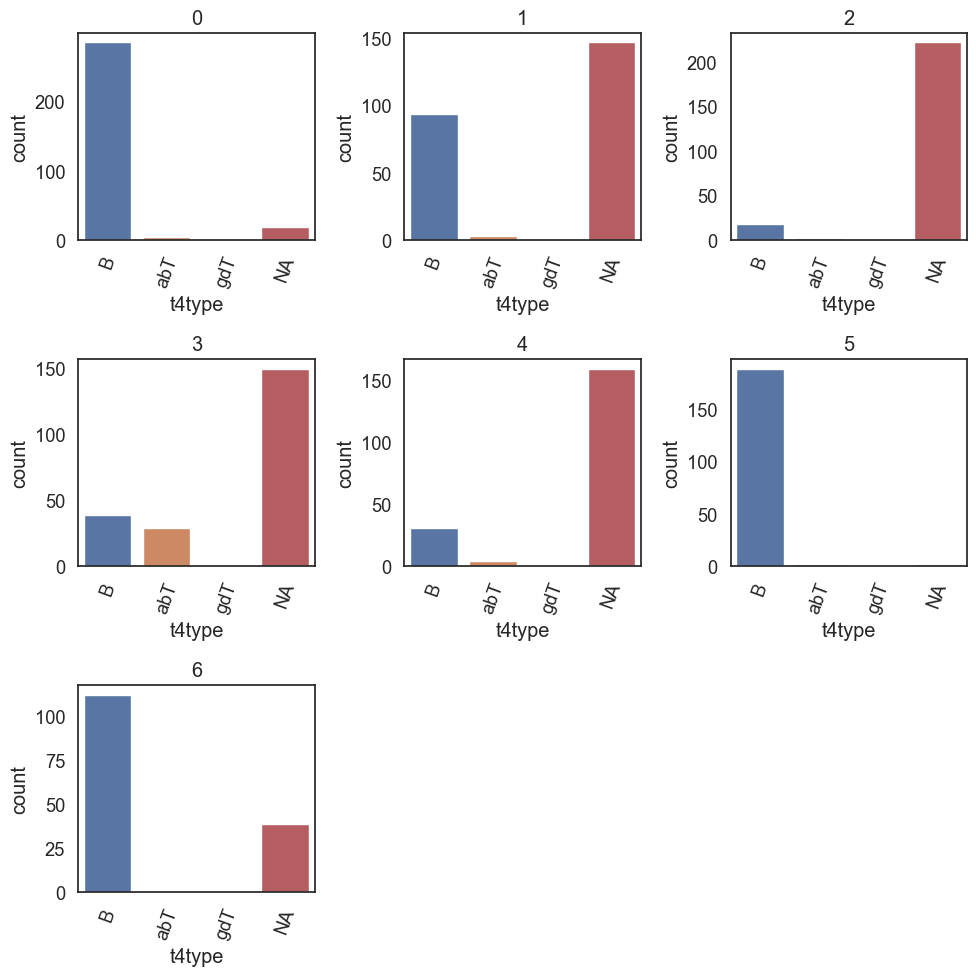

In [101]:
t4types = ["B", "abT", "gdT", "NA"]
fig, ax = plt.subplots(nrows=int(np.ceil(len(clusterList)/3)), ncols=3, figsize=(10, 10))
for i, c in enumerate(clusterList):
    print(i, c)
    subdf = adata.obs.loc[ adata.obs["leiden_1.0"] == c]
    snsFig = sns.countplot(x='t4type', data=subdf, order=t4types,
                           ax=ax[i//3][i%3])
    snsFig.set(title=c)
    #snsFig.set_xticklabels(snsFig.get_xticks(), rotation = 45)
    for tick in snsFig.get_xticklabels():
        tick.set_rotation(70)
    
if (len(clusterList) % 3 != 0):
    for i in range(len(clusterList)%3, 3):
        j = i + (len(clusterList)//3)*3
        ax[j//3][j%3].axis('off')
    
plt.tight_layout()
plt.savefig("SMART-seq/composition_cluster_t4type.pdf", format="pdf")

0 Unknown
1 low
2 neg
3 pos


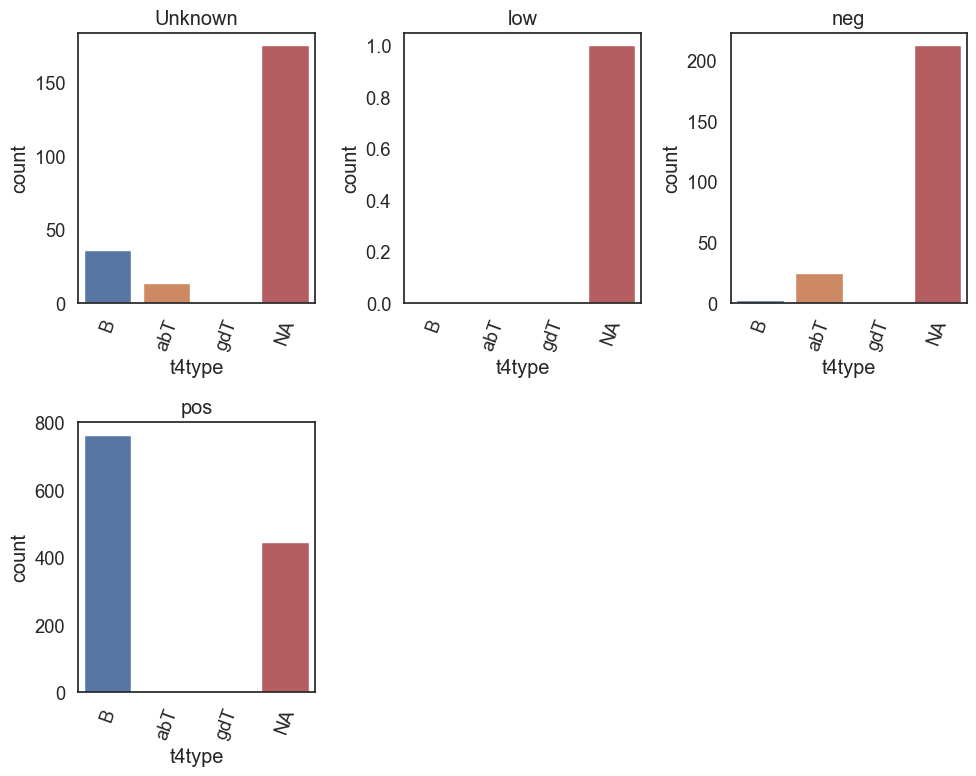

In [102]:
t4types = ["B", "abT", "gdT", "NA"]
lst = ["Unknown", "low", "neg", "pos"]
fig, ax = plt.subplots(nrows=int(np.ceil(len(lst)/3)), ncols=3, figsize=(10, 8))
for i, c in enumerate(["Unknown", "low", "neg", "pos"]):
    print(i, c)
    subdf = adata.obs.loc[ adata.obs["cd19 expression"] == c]
    snsFig = sns.countplot(x='t4type', data=subdf, order=t4types,
                           ax=ax[i//3][i%3])
    snsFig.set(title=c)
    #snsFig.set_xticklabels(snsFig.get_xticks(), rotation = 45)
    for tick in snsFig.get_xticklabels():
        tick.set_rotation(70)
    
if (len(lst) % 3 != 0):
    for i in range(len(lst)%3, 3):
        j = i + (len(lst)//3)*3
        ax[j//3][j%3].axis('off')
    
plt.tight_layout()
plt.savefig("SMART-seq/composition_cd19_t4type.pdf", format="pdf")

0 D
1 S


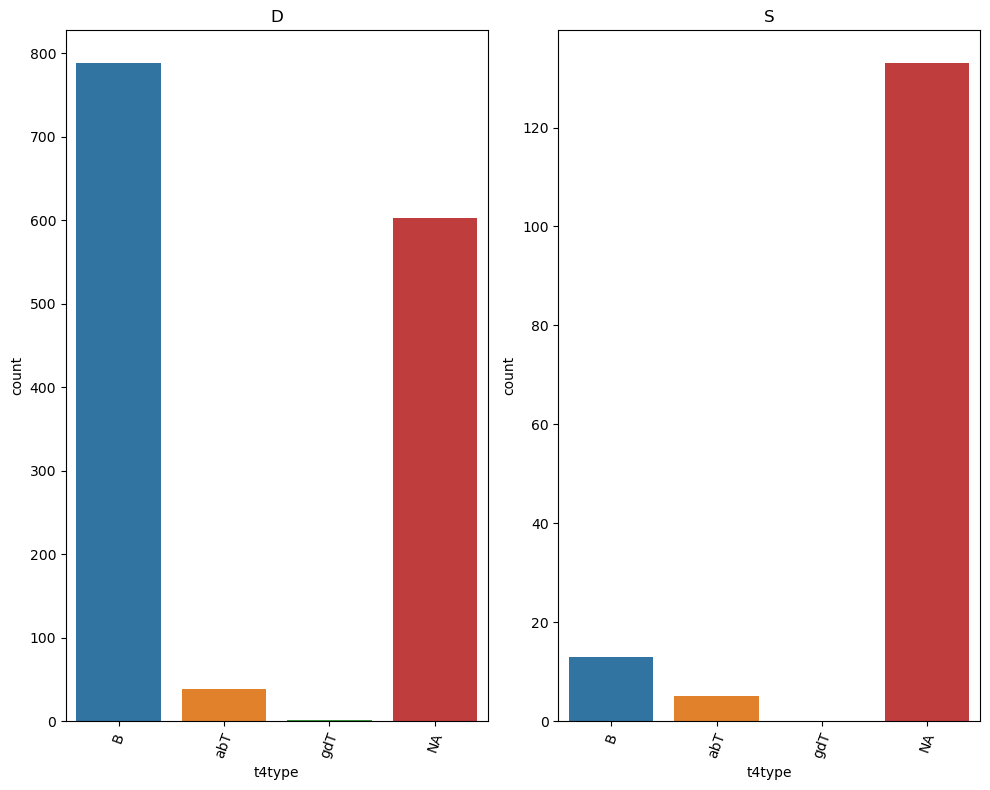

In [75]:
t4types = ["B", "abT", "gdT", "NA"]
lst = ["D", "S"]
fig, ax = plt.subplots(nrows=int(np.ceil(len(lst)/3)), ncols=2, figsize=(10, 8))
for i, c in enumerate(lst):
    print(i, c)
    subdf = adata.obs.loc[ adata.obs["picking"] == c]
    snsFig = sns.countplot(x='t4type', data=subdf, order=t4types,
                           ax=ax[i%3])
    snsFig.set(title=c)
    #snsFig.set_xticklabels(snsFig.get_xticks(), rotation = 45)
    for tick in snsFig.get_xticklabels():
        tick.set_rotation(70)
    
plt.tight_layout()
plt.savefig("SMART-seq/composition_picking_t4type.pdf", format="pdf")

In [116]:
adata.obs["picking"].value_counts()

D    1534
S     167
Name: picking, dtype: int64

In [73]:
cellTrustType = {}
for cell in adata.obs.index:
    cellTrustType[cell] = "NA" 
for i, row in trust4Airr.iterrows():
    chainType = GetChainType(row["v_call"], row["j_call"], row["c_call"])
    if (chainType <= 2):
        cellTrustType[row["cell"]] = "B" 
    elif (chainType <= 4):
        cellTrustType[row["cell"]] = "abT"
    elif (chainType <= 6):
        cellTrustType[row["cell"]] = "gdT"
cellTrustDf = pd.DataFrame.from_dict(cellTrustType, orient="index", columns=["t4type"])

In [ ]:

cellTrustType = {}
for cell in adata.obs.index:
    cellTrustType[cell] = "NA" 
for i, row in trust4Airr.iterrows():
    chainType = GetChainType(row["v_call"], row["j_call"], row["c_call"])
    if (chainType <= 2):
        cellTrustType[row["cell"]] = "B" 
    elif (chainType <= 4):
        cellTrustType[row["cell"]] = "abT"
    elif (chainType <= 6):
        cellTrustType[row["cell"]] = "gdT"
cellTrustDf = pd.DataFrame.from_dict(cellTrustType, orient="index", columns=["t4type"])

<AxesSubplot: ylabel='pct_counts_mt'>

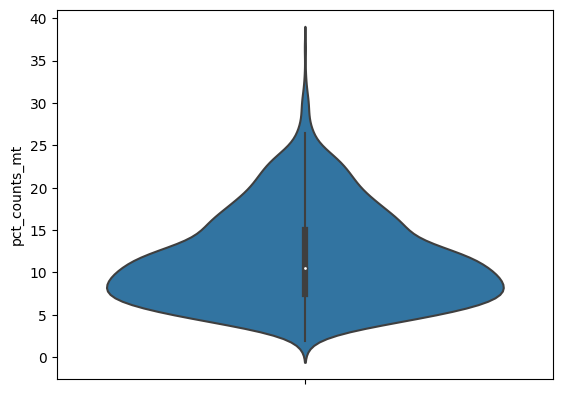

In [158]:
sns.violinplot(y="pct_counts_mt", data=adata.obs)

In [277]:
adata.obs

,batch,patient,timepoint,picking,cd19 expression,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden_1.0,raw_pateint,scSnpMarker_category,reduced_time,t4type
batch1_S1,batch1,HD1,normal,D,pos,9753,828690.973979,57756.243776,6.969576,0,PBMC13,NaN,normal,B
batch1_S10,batch1,HD1,normal,D,pos,10188,854050.840136,38392.017611,4.495285,0,PBMC13,NaN,normal,B
batch1_S100,batch1,MCL03,pre,S,pos,11248,827730.086682,53239.283250,6.431962,7,753528,NaN,pre,NA
batch1_S101,batch1,MCL03,pre,D,pos,9026,908373.480852,41163.609974,4.531573,5,753528,NaN,pre,NA
batch1_S102,batch1,MCL03,pre,D,pos,4738,889274.342253,34622.911165,3.893389,5,753528,NaN,pre,NA
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
batch4_S95,batch4,MCL08,M1,D,pos,5706,828051.723576,153651.310291,18.555762,2,693381,NaN,M1-3,NA
batch4_S96,batch4,MCL08,M1,S,pos,6341,755590.221229,143769.890304,19.027495,4,693381,NaN,M1-3,NA
batch4_S97,batch4,MCL08,M1,D,pos,9039,796180.808463,60950.068853,7.655305,4,693381,NaN,M1-3,NA
batch4_S98,batch4,MCL08,M1,D,neg,7781,791343.784788,122691.448853,15.504191,2,693381,NaN,M1-3,NA


In [15]:
adata.obs.to_csv("cell_clusters.tsv", sep="\t")

In [305]:
trust4Airr.columns

Index(['sequence_id', 'sequence', 'rev_comp', 'productive', 'v_call', 'd_call',
       'j_call', 'c_call', 'sequence_alignment', 'germline_alignment', 'cdr1',
       'cdr2', 'junction', 'junction_aa', 'v_cigar', 'd_cigar', 'j_cigar',
       'v_identity', 'j_identity', 'cell_id', 'complete_vdj',
       'consensus_count', 'cell', 'meta'],
      dtype='object')

### Obtain the sample/cluster clonality and entropy results

In [193]:
locus = []
for i, row in trust4Airr.iterrows():
    if (row["v_call"] != None):
        locus.append(row["v_call"][0:3])
    elif (row["j_call"] != None):
        locus.append(row["j_call"][0:3])
    elif (row["c_call"] != None):
        locus.append(row["c_call"][0:3])
trust4Airr["locus"] = locus

In [485]:
trust4Airr.iloc[19]

sequence_id           batch1_753528_pre_C09_RX10465_S129_R1_001_asse...
sequence              GCCCTGACCCTGCCATGGGCACCAGCCTCCTCTGCTGGATGGCCCT...
rev_comp                                                              F
productive                                                            T
v_call                                                       TRBV7-9*01
d_call                                                         TRBD2*01
j_call                                                       TRBJ1-5*01
c_call                                                            TRBC1
sequence_alignment    GATACTGGAGTCTCCCAGAACCCCAGACACAAGATCACAAAGAGGG...
germline_alignment    GATACTGGAGTCTCCCAGAACCCCAGACACAAGATCACAAAGAGGG...
cdr1                                                    TCTGAACACAACCGC
cdr2                                                 TTCCAGAATGAAGCTCAA
junction                  TGTGCCAGCAGCCAATCTGGGTCTAGCAATCAGCCCCAGCATTTT
junction_aa                                             CASSQSGS

In [491]:
trust4Airr.loc[ trust4Airr["locus"] == "IGH" ][["cell", "junction"]]

,cell,junction
36,batch1_S5,TGTGTCCCCTACCAGGTATCCCGGGGGCGGTGGTTCGACCCCTGG
39,batch1_S8,TGTGCGAGAGATACTTGGGCAGTAACCAGCCTCGACTACTACTACG...
42,batch1_S9,TGTGCGAAAGATCTCACGGGTATACGGGTTAGGTACTTCGATCTCTGG
43,batch1_S10,TGTGCGAAAGACGGATACGATCTAACGTGG
45,batch1_S12,TGTGCGAGACGGAAATTGGAGGGGGGCCCTATTGTCATAATACCAG...
...,...,...
1499,batch4_S424,TGTGCGAGCCACTACAGTAACTCCTACTACTACGGTATGGACGTCTGG
1501,batch4_S426,TGTGCGAGAGCTACTAAAGGGGGGGAAAACAACTACTGG
1504,batch4_S427,TGTGCGAGAGATCTTGAATACGCCGGATATTGTAGTGGTGGTAGCT...
1507,batch4_S429,TGTGCAAGCGTCCGTGGAGTGGGAGCTAGTGACTGGTTCGACCCCTGG


In [493]:
adata.obs

,batch,patient,timepoint,picking,cd19 expression,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden_1.0,raw_pateint,scSnpMarker_category,reduced_time,t4type
0,batch1,HD1,normal,D,pos,9753,828690.973979,57756.243776,6.969576,0,PBMC13,NaN,normal,B
1,batch1,HD1,normal,D,pos,10188,854050.840136,38392.017611,4.495285,0,PBMC13,NaN,normal,B
2,batch1,MCL03,pre,S,pos,11248,827730.086682,53239.283250,6.431962,7,753528,NaN,pre,NA
3,batch1,MCL03,pre,D,pos,9026,908373.480852,41163.609974,4.531573,5,753528,NaN,pre,NA
4,batch1,MCL03,pre,D,pos,4738,889274.342253,34622.911165,3.893389,5,753528,NaN,pre,NA
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1678,batch4,MCL08,M1,D,pos,5706,828051.723576,153651.310291,18.555762,2,693381,NaN,M1-3,NA
1679,batch4,MCL08,M1,S,pos,6341,755590.221229,143769.890304,19.027495,4,693381,NaN,M1-3,NA
1680,batch4,MCL08,M1,D,pos,9039,796180.808463,60950.068853,7.655305,4,693381,NaN,M1-3,NA
1681,batch4,MCL08,M1,D,neg,7781,791343.784788,122691.448853,15.504191,2,693381,NaN,M1-3,NA


In [194]:
adata.obs = adata.obs.merge(trust4Airr.loc[ trust4Airr["locus"] == "IGH" ][["cell", "junction"]], 
                left_index=True, right_on="cell", 
                how="left").set_index("cell")
adata.obs.index.name = None

In [517]:
adata.obs

,batch,patient,timepoint,picking,cd19 expression,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden_1.0,raw_pateint,reduced_time,index_backup,junction
batch1_S1,batch1,HD1,normal,D,pos,9753,828690.973979,57756.243776,6.969576,0,PBMC13,normal,batch1_S1,NaN
batch1_S10,batch1,HD1,normal,D,pos,10188,854050.840136,38392.017611,4.495285,0,PBMC13,normal,batch1_S10,TGTGCGAAAGACGGATACGATCTAACGTGG
batch1_S100,batch1,MCL03,pre,S,pos,11248,827730.086682,53239.283250,6.431962,7,753528,pre,batch1_S100,NaN
batch1_S101,batch1,MCL03,pre,D,pos,9026,908373.480852,41163.609974,4.531573,5,753528,pre,batch1_S101,NaN
batch1_S102,batch1,MCL03,pre,D,pos,4738,889274.342253,34622.911165,3.893389,5,753528,pre,batch1_S102,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
batch4_S95,batch4,MCL08,M1,D,pos,5706,828051.723576,153651.310291,18.555762,2,693381,M1-3,batch4_S95,NaN
batch4_S96,batch4,MCL08,M1,S,pos,6341,755590.221229,143769.890304,19.027495,4,693381,M1-3,batch4_S96,NaN
batch4_S97,batch4,MCL08,M1,D,pos,9039,796180.808463,60950.068853,7.655305,4,693381,M1-3,batch4_S97,NaN
batch4_S98,batch4,MCL08,M1,D,neg,7781,791343.784788,122691.448853,15.504191,2,693381,M1-3,batch4_S98,NaN


In [195]:
# Function to calculate Shannon entropy
def shannon_entropy(series):
    counts = series.value_counts()
    probabilities = counts / len(series)
    entropy = -sum(probabilities * np.log2(probabilities))
    return entropy

# Sample DataFrame
data = {
    'Key1': ['A', 'B', 'A', 'B', 'A', 'B'],
    'Key2': ['X', 'Y', 'X', 'Y', 'Z', 'Z'],
    'Category': ['cat', 'dog', 'cat', 'dog', 'mouse', 'mouse']
}
df = pd.DataFrame(data)

# Group by multiple keys 'Key1' and 'Key2'
grouped = df.groupby(['Key1', 'Key2'])

# Calculate Shannon entropy for each group
entropy = grouped['Category'].apply(shannon_entropy)
entropy_df = entropy.reset_index()
entropy_df.columns = ['Key1', 'Key2', 'Entropy']

,Key1,Key2,Entropy
0,A,X,-0.0
1,A,Z,-0.0
2,B,Y,-0.0
3,B,Z,-0.0


In [196]:
def Entropy(series):
    if (len(series) < 5):
        return np.NaN
    probs = series.value_counts(normalize=True).values
    return -np.sum(probs * np.log2(probs))

def Clonality(series):
    if (len(series) < 5):
        return np.NaN
    if (len(series.value_counts()) == 1):
        return 1
    return 1 - Entropy(series) / np.log2(len(series.value_counts()))

In [197]:
Entropy(adata.obs.loc[ (adata.obs["patient"]=="HD1") & (adata.obs["timepoint"] =="normal") 
              & (adata.obs["leiden_1.0"] == "0") & (adata.obs["junction"].isnull() == False)]["junction"])

5.209453365628953

In [484]:
trust4Airr

,sequence_id,sequence,rev_comp,productive,v_call,d_call,j_call,c_call,sequence_alignment,germline_alignment,...,d_cigar,j_cigar,v_identity,j_identity,cell_id,complete_vdj,consensus_count,cell,meta,locus
0,batch1_753528_M3_E06_RX10465_S246_R1_001_assem...,GGTGGAGGCAGTGGTGAGCCAGGAAATGTTTAGGACGTAGAATCCT...,F,T,IGLV4-60*01,,,,,,...,,,80.95,,,F,51,batch1_S246,753528_M3,IGL
1,batch1_753528_pre_A02_RX10465_S98_R1_001_assem...,AGCAACCACCAAGTGGAGAATTGGTTTTCCTTATTCGTCGGAACTC...,F,T,TRAV19*01,,TRAJ4*01,TRAC,AGCAACCACCAAGTGGAGAATTGGTTTTCCTTATTCGTCGGAACTC...,AGCAACCACCAAGTGGAGAATTGGTTTTCCTTATTCGTCGGAACTC...,...,,179S5N58M234S,100.00,100.00,,F,84,batch1_S98,753528_pre,TRA
2,batch1_753528_pre_A02_RX10465_S98_R1_001_assem...,CCCCAAAGCACCTGATCACAGCAACTGGACAGCGAGTGACGCTGAG...,F,T,TRBV9*01,,TRBJ2-1*01,,CCCCAAAGCACCTGATCACAGCAACTGGACAGCGAGTGACGCTGAG...,CCCCAAAGCACCTGATCACAGCAACTGGACAGCGAGTGACGCTGAG...,...,,280S27M23N,100.00,100.00,,F,53,batch1_S98,753528_pre,TRB
3,batch1_753528_pre_A03_RX10465_S99_R1_001_assem...,TTGTAATGGAGAAGAGAGAGCAAAAGGAAACATTCTTGAACGATTC...,F,T,TRBV9*01,TRBD1*01,TRBJ2-7*01,TRBC2,TTGTAATGGAGAAGAGAGAGCAAAAGGAAACATTCTTGAACGATTC...,TTATAATGGAGAAGAGAGAGCAAAAGGAAACATTCTTGAACGATTC...,...,140S7M284S5N,154S1N46M231S,99.26,100.00,,F,208,batch1_S99,753528_pre,TRB
4,batch1_753528_pre_A03_RX10465_S99_R1_001_assem...,GGAGCAGAGTCCTCAGAACCTGACTGCCCAGGAAGAAGCATGGAAG...,F,T,TRAV41*01,,TRAJ42*01,TRAC,G---GAAGAAGCATGGAAGATTAATTGCCACAATAAACATACAGGA...,GGAAGAAGAAGCATGGAAGATTAATTGCCACAATAAACATACAGGA...,...,,151S4N62M211S,98.67,100.00,,F,75,batch1_S99,753528_pre,TRA
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1507,batch4_Normal_B_PBMC17_D09_RX11153_S429_R1_001...,AGCTACTGGATGCACTGGGTCCGCCAAGCTCCAGGGAAGGGGCTGG...,F,T,IGHV3-74*01,IGHD1-26*01,IGHJ5*02,IGHM,AGCTACTGGATGCACTGGGTCCGCCAAGCTCCAGGGAAGGGGCTGG...,AGCTACTGGATGCACTGGGTCCGCCAAGCTCCAGGGAAGGGGCTGG...,...,212S5N11M82S4N,226S3N48M31S,100.00,100.00,,F,52,batch4_S429,PBMC17_normal,IGH
1508,batch4_Normal_B_PBMC17_D10_RX11153_S430_R1_001...,GATCAGCACTGAACACAGAGGACTCACCATGGAGTCTGGGGGAGGC...,F,T,IGHV3-30*18,IGHD6-13*01,IGHJ4*02,IGHM,TGGAGTCTGGGGGAGGCGTGGTCCAGCCTGGGAGGTCCCTGAGACT...,TGGAGTCTGGGGGAGGCGTGGTCCAGCCTGGGAGGTCCCTGAGACT...,...,317S6N15M81S,334S5N43M36S,100.00,100.00,,F,201,batch4_S430,PBMC17_normal,IGH
1509,batch4_Normal_B_PBMC17_D10_RX11153_S430_R1_001...,TTTGTGCAGGAGTCAGACCCAGTCAGGACACAGCATGGACATGAGG...,F,T,IGKV1-12*01,,IGKJ4*01,IGKC,GACATCCAGATGACCCAGTCTCCATCTTCCGTGTCTGCATCTGTAG...,GACATCCAGATGACCCAGTCTCCATCTTCCGTGTCTGCATCTGTAG...,...,,385S1N37M234S,100.00,100.00,,T,65,batch4_S430,PBMC17_normal,IGK
1510,batch4_Normal_B_PBMC17_D11_RX11153_S431_R1_001...,AAGAACCTGCCCAGCCTGGGCCTCAGGAAGCAGCATCGGAGGTGCC...,F,T,IGLV3-1*01,,IGLJ2*01,IGLC2,TCCTATGAGCTGACTCAGCCACCCTCAGTGTCCGTGTCCCCAGGAC...,TCCTATGAGCTGACTCAGCCACCCTCAGTGTCCGTGTCCCCAGGAC...,...,,390S38M30S,100.00,100.00,,T,123,batch4_S431,PBMC17_normal,IGL


In [486]:
trust4Airr[ trust4Airr["junction_aa"]==""].iloc[0]

sequence_id           batch1_753528_pre_C08_RX10465_S128_R1_001_asse...
sequence              ATATGTAAAATGAAGGGTCTGTGGAAGGACATGAATAAAGCACAGG...
rev_comp                                                              F
productive                                                            F
v_call                                                    TRAV29/DV5*01
d_call                                                                 
j_call                                                        TRAJ10*01
c_call                                                             TRAC
sequence_alignment    GACCAGCAAGTTAAGCAAAATTCACCATCCCTGAGCGTCCAGGAAG...
germline_alignment    GACCAGCAAGTTAAGCAAAATTCACCATCCCTGAGCGTCCAGGAAG...
cdr1                                                 AACAGCATGTTTGATTAT
cdr2                                              ATAAGTTCCATTAAGGATAAA
junction                     TGTGCAGCAAGTCTCACGGGAGGATGAAACAAACTCACCTTT
junction_aa                                                     

In [473]:
tmpDf = adata.obs[ adata.obs["junction_aa"].isnull() == False ].groupby(["patient", "timepoint", "leiden_1.0"])["junction_aa"].apply(lambda x:Entropy(x)).reset_index()

1                     CAKDGYDLTW
22     CARRKLEGGPIVIIPATMGDAFDFW
33                 CAKEGGHPTFDYW
44               CARGCWYGDPEVDYW
66               CAREGIAVAGAFDYW
77           CAREDRAYYYDSSGYYVYW
88              CARDGSGSYYGWFDPW
119             CAKGICGGTSCQLDYW
128                             
145             CARDFCSTSCYADDYW
176          CARDPSNVDFLAVDGTWYW
187           CAKTSYSSGWYRSMGDYW
194           CTTDGPLVVWEPNYFDYW
203          CAKDIGSRQWLFFDAFDIW
213      CARIPYGGNSLRSRYYYYGMDVW
234              CASRGPASSDAFDIW
260           CARGLVTAISKSPWFDPW
271        CARGGYNVLTGDFYHYGMDVW
277           CARQPSVKIAAAAPFDYW
308                  CARLSSGMPNW
310             CAKGAEDSSYHYFDYW
315      CARDKGCSSTSCYFYYYYGMDVW
323                 CARDRDSGYDYW
325              CVPYQVSRGRWFDPW
369             CAKDLTGIRVRYFDLW
723             CAKVLYGDYKPPLQYW
726          CARHGYCSGGSCYAYMDVW
727     CAAPTAIFGVATVDYYYYYYMDVW
730                 CARVFSYGLYYW
731             CTRHNRGDNYAPFDYW
732       

/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_16067/1005978080.py:8: RuntimeWarning: divide by zero encountered in log2
  return -np.sum(probs * np.log2(probs))
/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_16067/1005978080.py:8: RuntimeWarning: invalid value encountered in multiply
  return -np.sum(probs * np.log2(probs))
/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_16067/1005978080.py:8: RuntimeWarning: divide by zero encountered in log2
  return -np.sum(probs * np.log2(probs))
/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_16067/1005978080.py:8: RuntimeWarning: invalid value encountered in multiply
  return -np.sum(probs * np.log2(probs))
/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_16067/1005978080.py:8: RuntimeWarning: divide by zero encountered in log2
  return -np.sum(probs * np.log2(probs))
/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_16067/1005978080.py:8: RuntimeWarning: invalid value encountered 

In [445]:
s = pd.Series([1,1,1,1,2,2])
Entropy(s)

0.9182958340544896

In [442]:
dropCols = [col for col in adata.obs.columns if (col.startswith("T4_"))]
adata.obs.drop(columns=dropCols, inplace=True)

In [521]:
adata.obs

,batch,patient,timepoint,picking,cd19 expression,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden_1.0,raw_pateint,reduced_time,index_backup,junction,T4_entropy
batch1_S1,batch1,HD1,normal,D,pos,9753,828690.973979,57756.243776,6.969576,0,PBMC13,normal,batch1_S1,NaN,5.357552
batch1_S10,batch1,HD1,normal,D,pos,10188,854050.840136,38392.017611,4.495285,0,PBMC13,normal,batch1_S10,TGTGCGAAAGACGGATACGATCTAACGTGG,5.357552
batch1_S100,batch1,MCL03,pre,S,pos,11248,827730.086682,53239.283250,6.431962,7,753528,pre,batch1_S100,NaN,NaN
batch1_S101,batch1,MCL03,pre,D,pos,9026,908373.480852,41163.609974,4.531573,5,753528,pre,batch1_S101,NaN,NaN
batch1_S102,batch1,MCL03,pre,D,pos,4738,889274.342253,34622.911165,3.893389,5,753528,pre,batch1_S102,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
batch4_S95,batch4,MCL08,M1,D,pos,5706,828051.723576,153651.310291,18.555762,2,693381,M1-3,batch4_S95,NaN,NaN
batch4_S96,batch4,MCL08,M1,S,pos,6341,755590.221229,143769.890304,19.027495,4,693381,M1-3,batch4_S96,NaN,NaN
batch4_S97,batch4,MCL08,M1,D,pos,9039,796180.808463,60950.068853,7.655305,4,693381,M1-3,batch4_S97,NaN,NaN
batch4_S98,batch4,MCL08,M1,D,neg,7781,791343.784788,122691.448853,15.504191,2,693381,M1-3,batch4_S98,NaN,NaN


In [198]:
# Shannon entropy
backupIndex = adata.obs.index

tmpDf = adata.obs[ adata.obs["junction"].isnull() == False ].groupby(["patient", "timepoint", "leiden_1.0"])["junction"].apply(lambda x:Entropy(x)).reset_index()
tmpDf.columns = ["patient", "timepoint", "leiden_1.0", "T4_entropy"]

adata.obs = adata.obs.merge( tmpDf, on=["patient", "timepoint", "leiden_1.0"], how="left")
adata.obs.index = backupIndex

In [199]:
adata.obs

,batch,patient,timepoint,picking,cd19 expression,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden_1.0,raw_pateint,reduced_time,t4type,junction,T4_entropy
batch1_S1,batch1,HD1,normal,D,pos,9753,828690.973979,57756.243776,6.969576,0,PBMC13,normal,B,NaN,5.209453
batch1_S10,batch1,HD1,normal,D,pos,10188,854050.840136,38392.017611,4.495285,0,PBMC13,normal,B,TGTGCGAAAGACGGATACGATCTAACGTGG,5.209453
batch1_S100,batch1,MCL03,pre,S,pos,11248,827730.086682,53239.283250,6.431962,3,753528,pre,NA,NaN,NaN
batch1_S101,batch1,MCL03,pre,D,pos,9026,908373.480852,41163.609974,4.531573,3,753528,pre,NA,NaN,NaN
batch1_S102,batch1,MCL03,pre,D,pos,4738,889274.342253,34622.911165,3.893389,3,753528,pre,NA,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
batch4_S95,batch4,MCL08,M1,D,pos,5706,828051.723576,153651.310291,18.555762,4,693381,M1-3,NA,NaN,NaN
batch4_S96,batch4,MCL08,M1,S,pos,6341,755590.221229,143769.890304,19.027495,2,693381,M1-3,NA,NaN,NaN
batch4_S97,batch4,MCL08,M1,D,pos,9039,796180.808463,60950.068853,7.655305,2,693381,M1-3,NA,NaN,NaN
batch4_S98,batch4,MCL08,M1,D,neg,7781,791343.784788,122691.448853,15.504191,2,693381,M1-3,NA,NaN,NaN


In [200]:
# clonality
backupIndex = adata.obs.index
tmpDf = adata.obs[ adata.obs["junction"].isnull() == False ].groupby(["patient", "timepoint", "leiden_1.0"])["junction"].apply(lambda x:Clonality(x)).reset_index()
tmpDf.columns = ["patient", "timepoint", "leiden_1.0", "T4_clonality"]

adata.obs = adata.obs.merge( tmpDf, on=["patient", "timepoint", "leiden_1.0"], how="left")
adata.obs.index = backupIndex

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/anndata/_core/anndata.py:1222: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/anndata/_core/anndata.py:1222: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


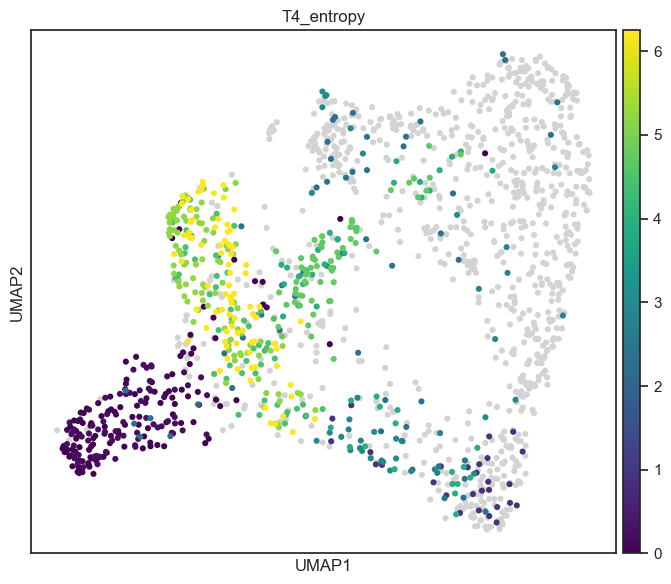

In [210]:
import matplotlib as mpl
with plt.rc_context({"figure.figsize": (7, 6)}):
    sc.pl.umap(adata[ adata.obs["leiden_1.0"].isin(clusterList)], 
               color=["T4_entropy"],
            show=False, color_map=mpl.cm.viridis)
    plt.tight_layout()
    plt.savefig("./SMART-seq/umap_trust4_entropy.pdf", format="pdf")

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/anndata/_core/anndata.py:1222: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/anndata/_core/anndata.py:1222: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


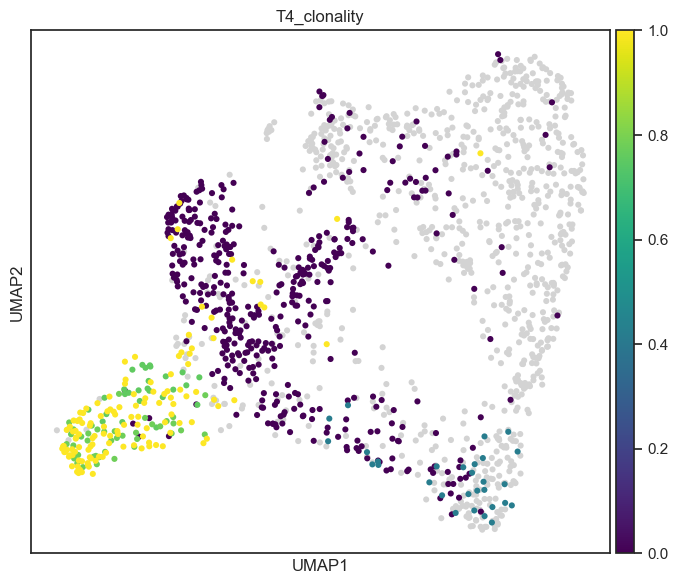

In [204]:
import matplotlib as mpl
with plt.rc_context({"figure.figsize": (7, 6)}):
    sc.pl.umap(adata[ adata.obs["leiden_1.0"].isin(clusterList)], color=["T4_clonality"],
            show=False, color_map=mpl.cm.viridis)
    plt.tight_layout()
    plt.savefig("./SMART-seq/umap_trust4_clonality.pdf", format="pdf")

In [373]:
adata.obs[ adata.obs["junction_aa"].isnull() == False ].groupby(
    ["patient", "timepoint", "leiden_1.0"])

In [380]:
adata.obs.groupby(
    ["patient", "timepoint", "leiden_1.0"])["n_genes_by_counts"].sum().value_counts()

n_genes_by_counts
0        1920
12124       2
11584       2
91184       1
26167       1
         ... 
71383       1
37838       1
82330       1
87259       1
10136       1
Name: count, Length: 263, dtype: int64

## scRNA-seq analysis excluding receptor-defined non-cancer cells

In [311]:
adata.obs

,batch,patient,timepoint,picking,cd19 expression,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden_1.0,raw_pateint,scSnpMarker_category,reduced_time,t4type
batch1_S1,batch1,HD1,normal,D,pos,9753,828690.973979,57756.243776,6.969576,0,PBMC13,NaN,normal,B
batch1_S10,batch1,HD1,normal,D,pos,10188,854050.840136,38392.017611,4.495285,0,PBMC13,NaN,normal,B
batch1_S100,batch1,MCL03,pre,S,pos,11248,827730.086682,53239.283250,6.431962,7,753528,NaN,pre,NA
batch1_S101,batch1,MCL03,pre,D,pos,9026,908373.480852,41163.609974,4.531573,5,753528,NaN,pre,NA
batch1_S102,batch1,MCL03,pre,D,pos,4738,889274.342253,34622.911165,3.893389,5,753528,NaN,pre,NA
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
batch4_S95,batch4,MCL08,M1,D,pos,5706,828051.723576,153651.310291,18.555762,2,693381,NaN,M1-3,NA
batch4_S96,batch4,MCL08,M1,S,pos,6341,755590.221229,143769.890304,19.027495,4,693381,NaN,M1-3,NA
batch4_S97,batch4,MCL08,M1,D,pos,9039,796180.808463,60950.068853,7.655305,4,693381,NaN,M1-3,NA
batch4_S98,batch4,MCL08,M1,D,neg,7781,791343.784788,122691.448853,15.504191,2,693381,NaN,M1-3,NA


In [471]:
metaInfo = pd.read_excel("merged_metadata.xlsx")
metaInfo["patient"] = metaInfo["patient"].astype(str)

metaInfo = metaInfo.merge(trust4Airr[trust4Airr["v_call"].str.contains("IGHV")][["junction","cell"]], 
               left_on="sample", right_on="cell", how="left")

In [591]:
cellIncluded = {}
for patient in metaInfo["patient"].unique():
    subMetaDf = metaInfo[ metaInfo["patient"] == patient ]
    if ("PBMC" in patient):
        subMetaDf = subMetaDf.set_index("sample")
        for cell, row in subMetaDf.iterrows():
            cellIncluded[cell] = 1
        continue
    preMetaDf = subMetaDf[ subMetaDf["timepoint"] == "pre"]
    
    vc = preMetaDf["junction"].value_counts()
    dominant = ""
    if (len(vc) > 0 and vc[0] > 1):
        dominant = vc.index[0]
    
    subMetaDf = subMetaDf.set_index("sample")
    for cell, row in subMetaDf.iterrows():
        if (cell not in cellType): # No TCR/BCR information
            cellIncluded[cell] = 1
        elif (cellType[cell] == "B"): # Only consider BCR with dominant clonotypes
            if (dominant != "" and subMetaDf.loc[cell]["junction"] == dominant):
                cellIncluded[cell] = 1
                

In [593]:
combinedTPM = pd.DataFrame()
for batch in range(1, 5):
    batchTPM = pd.read_csv("TPM/batch%d_tximport-tpm.csv"%batch) 
    batchTPM = batchTPM.set_index("gene")
    print(batch, len(batchTPM))
    # rename the header to cell id
    batchTPM = batchTPM.add_prefix("batch%d_"%batch)
    # The key command to filter cells.
    batchTPM = batchTPM[ batchTPM.columns[ batchTPM.columns.isin(cellIncluded)]]
    if (batch == 1):
        combinedTPM = batchTPM
    else:
        combinedTPM = combinedTPM.merge(batchTPM, left_index=True, right_index=True)
combinedTPM.index = batchTPM.index.map(geneIdConversion) # rename the gene id
combinedTPM = combinedTPM[ pd.notnull(combinedTPM.index) ]
#combinedTPM = combinedTPM.groupby("gene").sum()

1 58735
2 58735
3 58735
4 58735


In [599]:
# Load in meta data
cancerAdata = sc.AnnData(combinedTPM.transpose()) # 
cancerAdata.var_names_make_unique()

# Add metadata
cancerAdata.obs = cancerAdata.obs.merge(metaInfo[["sample", "batch", "patient", "timepoint",
                                     "picking", "cd19 expression"]], 
                left_index=True, right_on="sample").set_index("sample")
cancerAdata.obs.index.name = None

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/anndata/_core/anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [600]:
cancerAdata.var['mt'] = cancerAdata.var_names.str.startswith('MT-')  
sc.pp.calculate_qc_metrics(cancerAdata, qc_vars=['mt'], 
                               percent_top=None, log1p=False, inplace=True)

In [601]:
print(len(cancerAdata.var), len(cancerAdata))
sc.pp.filter_genes(cancerAdata, min_cells=10)
print(len(cancerAdata.var))

# Filter by MT number
cancerAdata = RemoveMTCell(cancerAdata, 30) 
print(len(cancerAdata))

# Filter immune repertoire genes
cancerAdata.var['imrep'] = (cancerAdata.var_names.str.startswith('IGH') | cancerAdata.var_names.str.startswith('IGK') | \
    cancerAdata.var_names.str.startswith('IGL') | cancerAdata.var_names.str.startswith('TRB') | \
    cancerAdata.var_names.str.startswith('TRA') | cancerAdata.var_names.str.startswith('TRG') | \
    cancerAdata.var_names.str.startswith('TRD'))
cancerAdata = cancerAdata[:, ~cancerAdata.var['imrep']]
print(len(cancerAdata))

# Filter by the cells express too few or too much genes
geneCntRange = (2000, 25000)
cancerAdata = cancerAdata[(cancerAdata.obs.n_genes_by_counts >= geneCntRange[0])
             & (cancerAdata.obs.n_genes_by_counts <= geneCntRange[1]), :]
print(len(cancerAdata))

34615 1435
26883
1333
1333
1309


/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_12209/1710128074.py:10: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  cancerAdata.var['imrep'] = (cancerAdata.var_names.str.startswith('IGH') | cancerAdata.var_names.str.startswith('IGK') | \


In [602]:
sc.pp.normalize_total(cancerAdata, target_sum=1e6)
sc.pp.highly_variable_genes(cancerAdata, flavor="seurat_v3", n_top_genes=2000)
sc.pp.log1p(cancerAdata)

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/preprocessing/_highly_variable_genes.py:62: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


In [603]:
cancerAdata.raw = cancerAdata
cancerAdata = cancerAdata[:, cancerAdata.var.highly_variable]

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


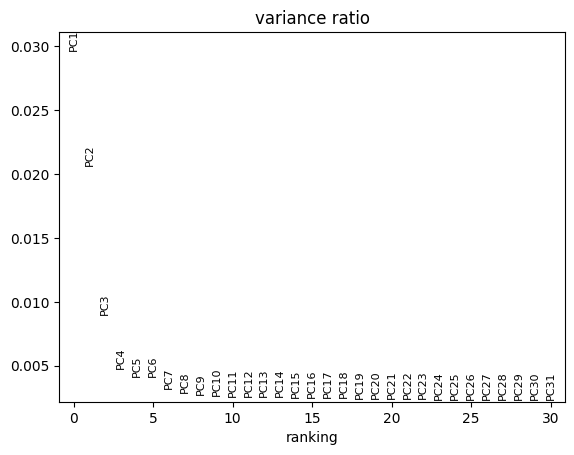

In [604]:
sc.pp.scale(cancerAdata)
sc.tl.pca(cancerAdata, svd_solver='arpack', n_comps=50, use_highly_variable=True)
sc.pl.pca_variance_ratio(cancerAdata, log=False)

In [605]:
sc.external.pp.harmony_integrate(cancerAdata, key = "batch", plot_convergence=True,
                                max_iter_harmony=20)

2024-04-08 16:20:03,335 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-04-08 16:20:03,870 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-04-08 16:20:03,879 - harmonypy - INFO - Iteration 1 of 20
2024-04-08 16:20:04,031 - harmonypy - INFO - Iteration 2 of 20
2024-04-08 16:20:04,190 - harmonypy - INFO - Iteration 3 of 20
2024-04-08 16:20:04,336 - harmonypy - INFO - Iteration 4 of 20
2024-04-08 16:20:04,430 - harmonypy - INFO - Iteration 5 of 20
2024-04-08 16:20:04,533 - harmonypy - INFO - Iteration 6 of 20
2024-04-08 16:20:04,666 - harmonypy - INFO - Iteration 7 of 20
2024-04-08 16:20:04,855 - harmonypy - INFO - Iteration 8 of 20
2024-04-08 16:20:04,928 - harmonypy - INFO - Iteration 9 of 20
2024-04-08 16:20:04,989 - harmonypy - INFO - Iteration 10 of 20
2024-04-08 16:20:05,088 - harmonypy - INFO - Iteration 11 of 20
2024-04-08 16:20:05,292 - harmonypy - INFO - Iteration 12 of 20
2024-04-08 16:20:05,387 - harmonypy - INFO - Iteration 13 of

In [612]:
reducer = umap.umap_.UMAP(random_state=17)
embedding = reducer.fit_transform( cancerAdata.obsm["X_pca_harmony"])
cancerAdata.obsm["X_umap"] = embedding

In [613]:
sc.pp.neighbors(cancerAdata, n_neighbors=15, use_rep="X_pca_harmony")
sc.tl.leiden(cancerAdata, key_added = "leiden_1.0", resolution = 1.0)

In [611]:
cancerAdata.obs

,batch,patient,timepoint,picking,cd19 expression,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden_1.0
batch1_S1,batch1,PBMC13,normal,D,pos,9751,828621.628444,57756.243776,6.970159,1
batch1_S10,batch1,PBMC13,normal,D,pos,10183,853920.374501,38392.017611,4.495972,1
batch1_S100,batch1,753528,pre,S,pos,11238,825591.389754,53239.283250,6.448624,2
batch1_S101,batch1,753528,pre,D,pos,9017,907760.100511,41163.609974,4.534635,2
batch1_S102,batch1,753528,pre,D,pos,4734,888991.859083,34622.911165,3.894626,2
...,...,...,...,...,...,...,...,...,...,...
batch4_S95,batch4,693381,d28,D,pos,5704,827336.876151,153651.310291,18.571795,0
batch4_S96,batch4,693381,d28,S,pos,6338,755349.673644,143769.890304,19.033554,4
batch4_S97,batch4,693381,d28,D,pos,9037,796112.846913,60950.068853,7.655958,4
batch4_S98,batch4,693381,d28,D,neg,7775,789424.385657,122691.448853,15.541887,0


In [616]:
cancerAdata.obs["leiden_1.0"].value_counts()

leiden_1.0
0    251
1    194
2    182
3    175
4    159
5    136
6    113
7     90
8      9
Name: count, dtype: int64

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


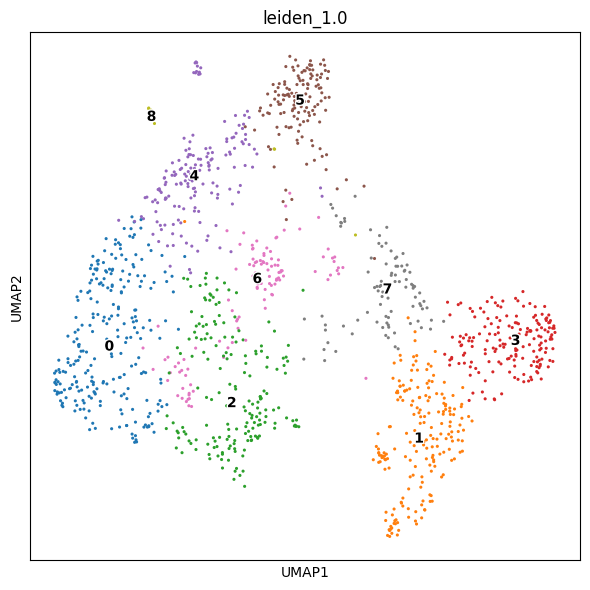

In [614]:
with plt.rc_context({"figure.figsize": (6, 6)}):
    ax = sc.pl.umap(cancerAdata, color=['leiden_1.0'],
          legend_loc='on data', legend_fontoutline=2, show=False, ncols=1,
           size=20)
    plt.tight_layout()
    plt.savefig("./SMART-seq/NormalExclude/umap_clusterId.pdf", format="pdf")

In [621]:
clusterCnt = 8
cancerInclusion = []
for i in range(clusterCnt):
    cancerInclusion.append(str(i))

0 0
1 1
2 2
3 3
4 4
5 5
6 6
7 7


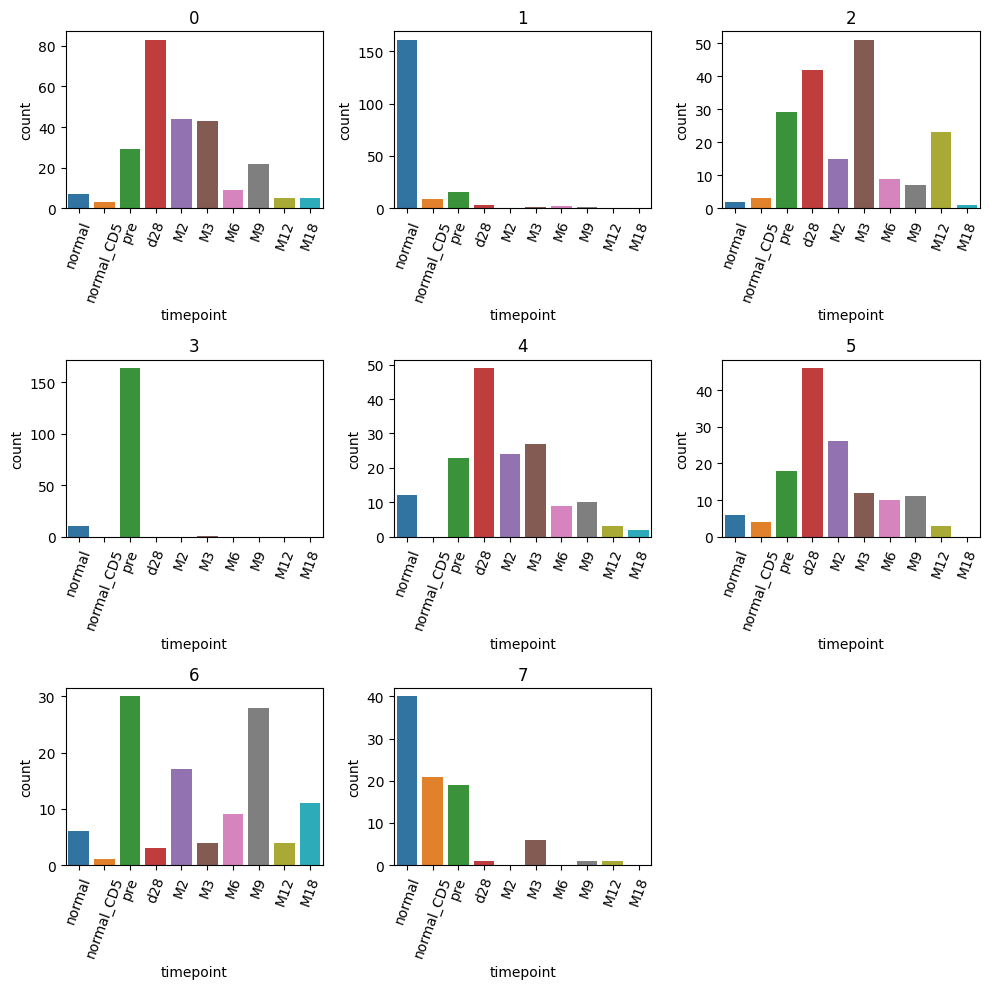

In [622]:
fig, ax = plt.subplots(nrows=int(np.ceil(len(cancerInclusion)/3)), ncols=3, figsize=(10, 10))
for i, c in enumerate(cancerInclusion):
    print(i, c)
    subdf = cancerAdata.obs.loc[ cancerAdata.obs["leiden_1.0"] == c]
    snsFig = sns.countplot(x='timepoint', data=subdf, order=timepoints,
                           ax=ax[i//3][i%3])
    snsFig.set(title=c)
    #snsFig.set_xticklabels(snsFig.get_xticks(), rotation = 45)
    for tick in snsFig.get_xticklabels():
        tick.set_rotation(70)
    
if (len(cancerInclusion) % 3 != 0):
    for i in range(len(cancerInclusion)%3, 3):
        j = i + (len(cancerInclusion)//3) * 3
        ax[j//3][j%3].axis('off')
    
plt.tight_layout()
plt.savefig("SMART-seq/NormalExclude/composition_cluster_timepoint.pdf", format="pdf")

In [680]:
# DGE
cancerAdata.uns["log1p"]["base"] = None
sc.tl.rank_genes_groups(cancerAdata, groupby="leiden_1.0", 
                        method='wilcoxon',
                        groups=cancerInclusion)

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/tools/_dendrogram.py:161: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = dat


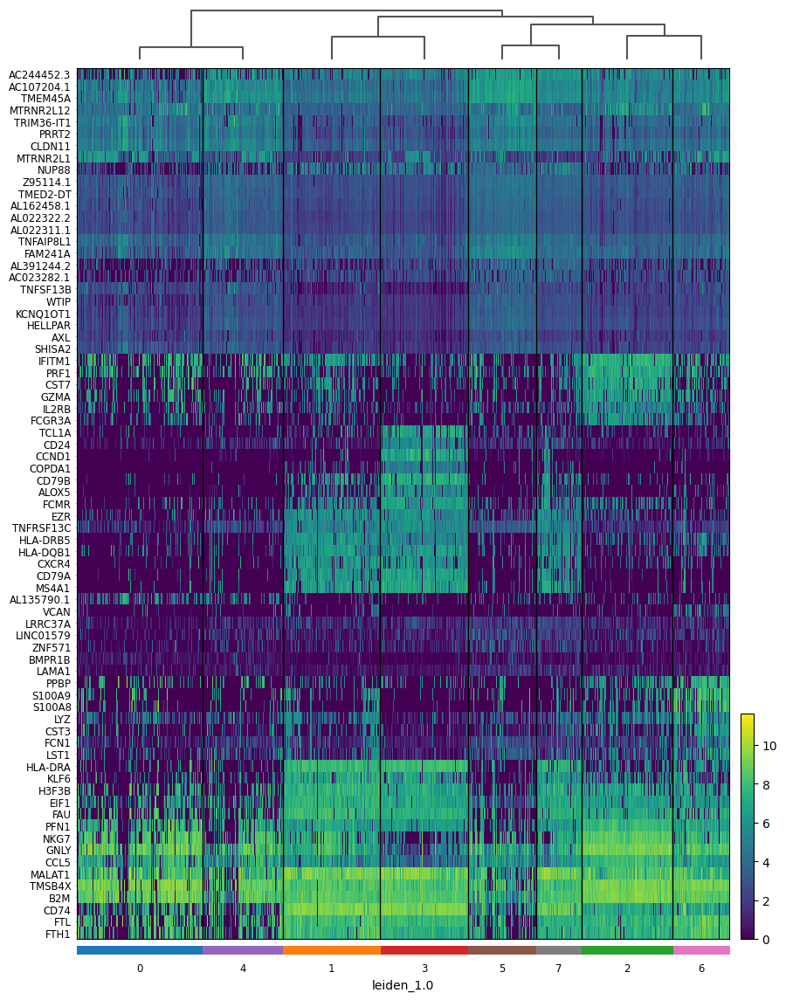

In [684]:
n = 10 # number of markers from each cluster
key = "rank_genes_groups"
clusterList = cancerAdata.uns[key]["pvals_adj"].dtype.names
markerSet = set({})
markers = []
logfoldchange = 1
for cluster in clusterList:
    cnt = 0
    for j, g in enumerate(cancerAdata.uns[key]["names"][cluster]):
        #print(i, j, g, data.uns["rank_genes_groups"]["pvals_adj"][i][j])
        if (cancerAdata.uns[key]["pvals_adj"][cluster][j] >= 0.05):
            continue
        if (g.startswith("RP") or g.startswith("MT-")):
            continue
        if (g not in markerSet):
            markers.append(g)
            markerSet.add(g)
        cnt += 1
        if (cnt >= n):
            break

markerAdata = cancerAdata.raw.to_adata()[:, markers]  
markerX = markerAdata.X.toarray().T

Z = sp.cluster.hierarchy.linkage(markerX, 'complete')
markersReorder = [markers[int(i)] for i in sp.cluster.hierarchy.leaves_list(Z)]
            
            
sc.pl.rank_genes_groups_heatmap(cancerAdata[cancerAdata.obs["leiden_1.0"].isin(clusterList)], 
                       show_gene_labels=True, 
                       key=key, var_names=list(markersReorder),
                       swap_axes=True, show=False)

plt.savefig("SMART-seq/NormalExclude/rank_genes_group_heatmap.pdf", 
                format="pdf")

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_12209/625600556.py:12: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


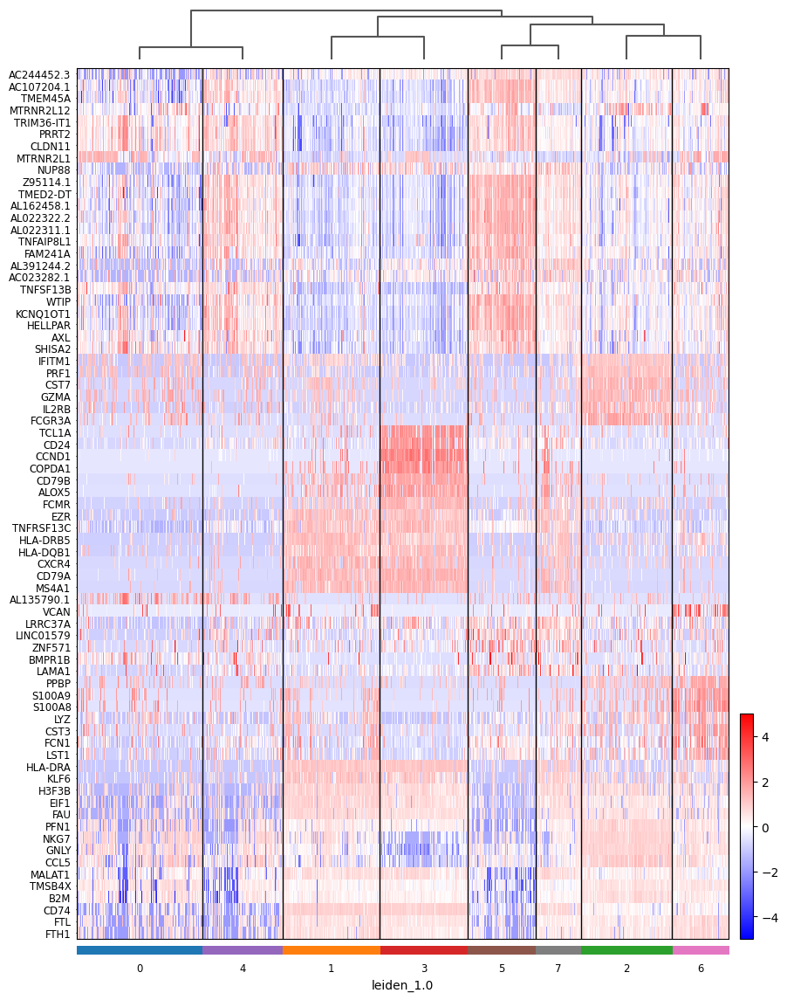

In [685]:
zscoreVisDf = cancerAdata.raw.to_adata()[ 
            cancerAdata.obs["leiden_1.0"].isin(clusterList)].copy()
zscoreVisDf = zscoreVisDf[:, markers]
sc.pp.scale(zscoreVisDf)

sc.pl.rank_genes_groups_heatmap(zscoreVisDf, 
                               show_gene_labels=True,
                               key=key, var_names=list(markersReorder),
                               swap_axes=True, cmap="bwr",
                               vmin=-5, vmax=5, show=False)
if (True):
    plt.tight_layout()
    plt.savefig("SMART-seq/NormalExclude/rank_genes_group_heatmap_z.pdf",
                format="pdf")

In [722]:
# DGE
cancerAdata.uns["log1p"]["base"] = None
sc.tl.rank_genes_groups(cancerAdata, groupby="cd19 expression", 
                        method='wilcoxon',
                        groups=["pos", "neg", "Unknown"])

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_12209/1293157164.py:48: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


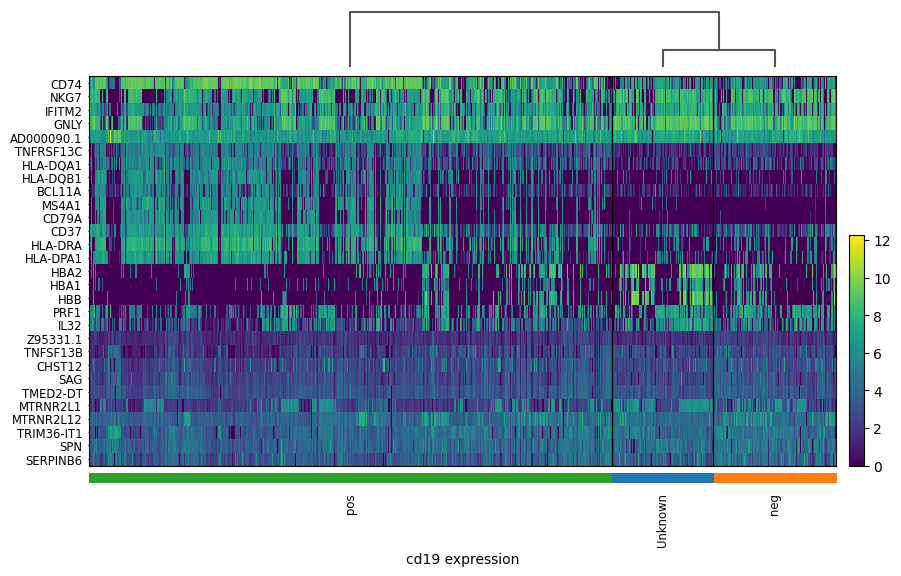

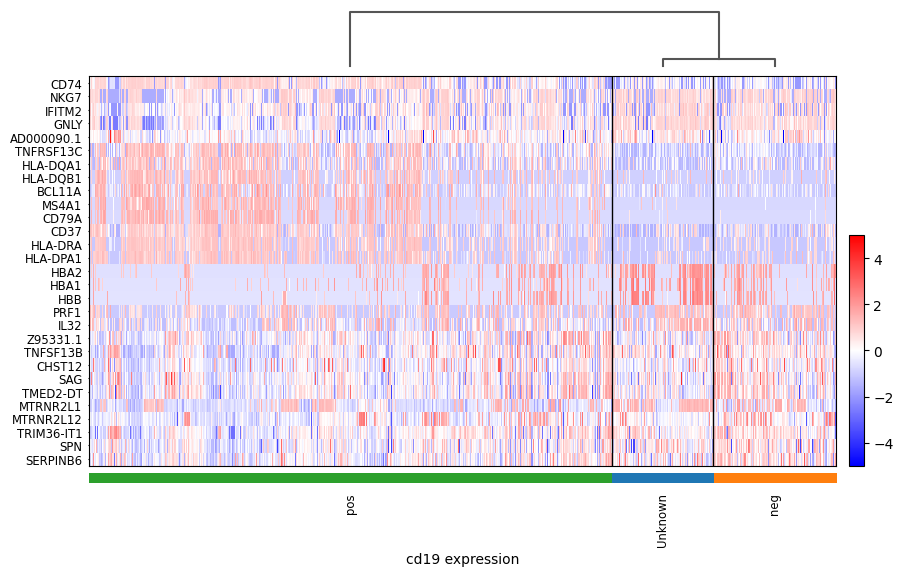

In [725]:
n = 10 # number of markers from each cluster
key = "rank_genes_groups"
clusterList = cancerAdata.uns[key]["pvals_adj"].dtype.names
markerSet = set({})
markers = []
logfoldchange = 1
for cluster in clusterList:
    cnt = 0
    for j, g in enumerate(cancerAdata.uns[key]["names"][cluster]):
        #print(i, j, g, data.uns["rank_genes_groups"]["pvals_adj"][i][j])
        if (cancerAdata.uns[key]["pvals_adj"][cluster][j] >= 0.05):
            continue
        if (g.startswith("RP") or g.startswith("MT-")):
            continue
        if (g not in markerSet):
            markers.append(g)
            markerSet.add(g)
        cnt += 1
        if (cnt >= n):
            break

markerAdata = cancerAdata.raw.to_adata()[:, markers]  
markerX = markerAdata.X.toarray().T

Z = sp.cluster.hierarchy.linkage(markerX, 'complete')
markersReorder = [markers[int(i)] for i in sp.cluster.hierarchy.leaves_list(Z)]
            
            
sc.pl.rank_genes_groups_heatmap(cancerAdata[cancerAdata.obs["cd19 expression"].isin(clusterList)], 
                       show_gene_labels=True, 
                       key=key, var_names=list(markersReorder),
                       swap_axes=True, show=False)

plt.savefig("SMART-seq/NormalExclude/rank_genes_group_cd19_heatmap.pdf", 
                format="pdf")

zscoreVisDf = cancerAdata.raw.to_adata()[ 
            cancerAdata.obs["cd19 expression"].isin(clusterList)].copy()
zscoreVisDf = zscoreVisDf[:, markers]
sc.pp.scale(zscoreVisDf)

sc.pl.rank_genes_groups_heatmap(zscoreVisDf, 
                               show_gene_labels=True,
                               key=key, var_names=list(markersReorder),
                               swap_axes=True, cmap="bwr",
                               vmin=-5, vmax=5, show=False)
if (True):
    plt.tight_layout()
    plt.savefig("SMART-seq/NormalExclude/rank_genes_group_cd19_heatmap_z.pdf",
                format="pdf")

In [724]:
clusterList

('pos', 'neg', 'Unknown')

In [720]:
cancerAdata.obs["cd19 expression"].value_counts()

cd19 expression
pos        915
neg        215
Unknown    178
low          1
Name: count, dtype: int64

In [716]:
np.where(adata.obs["cd19 expression"].cat.categories.values == "low")[0][0]

1

## Explore scSnpMarker

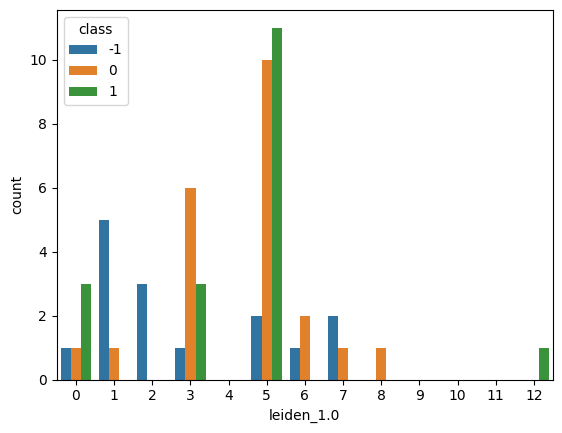

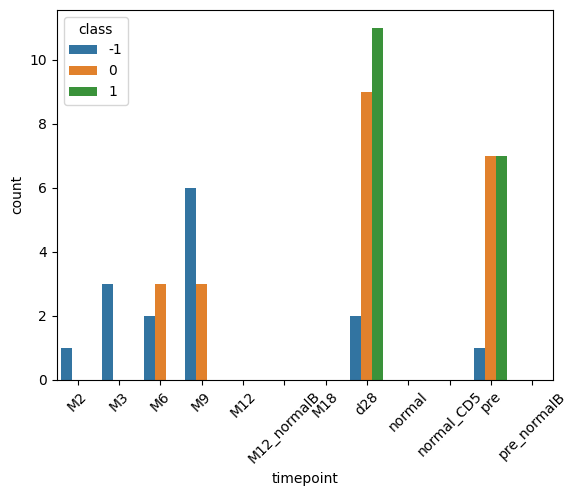

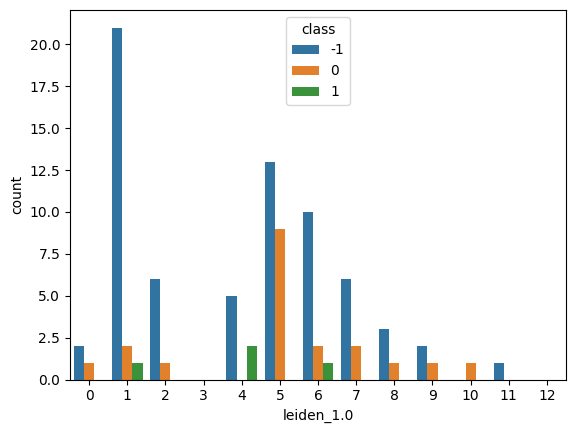

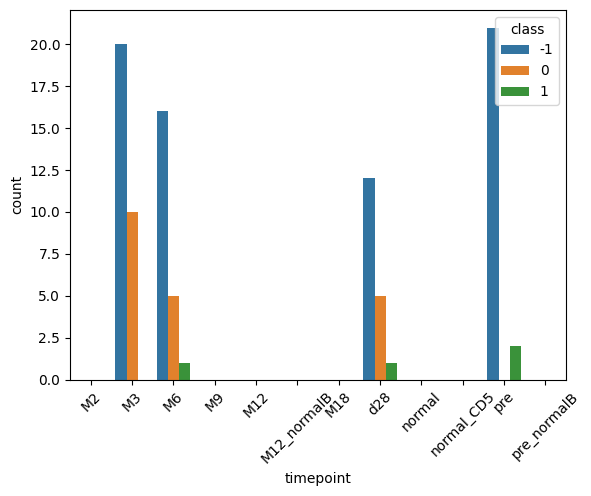

In [102]:
# NOT USED
for patientId in ["895557", "670730"]:
    df = pd.read_csv("scSnpMarker/%s_classify_result_wsampleid.out"%patientId, sep="\t", 
                     header=None)
    df.columns = ["file_prefix", "class", "normal", "cancer", "neither", "noinfo", 
                  "cellid", "sampleid"]
    df = df.merge( adata.obs, left_on="cellid", right_index=True)

    cases = [(df["normal"] + df["cancer"]<4),
        (df["normal"] > df["cancer"]),
        (df["cancer"] > df["normal"])]
    df["class"] = np.select(cases, [-1, 0, 1], default=-1)
    
    sns.countplot(x="leiden_1.0", data=df, hue="class")
    plt.show() 
    
    ax = sns.countplot(x="timepoint", data=df, hue="class")
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45)
    plt.show()

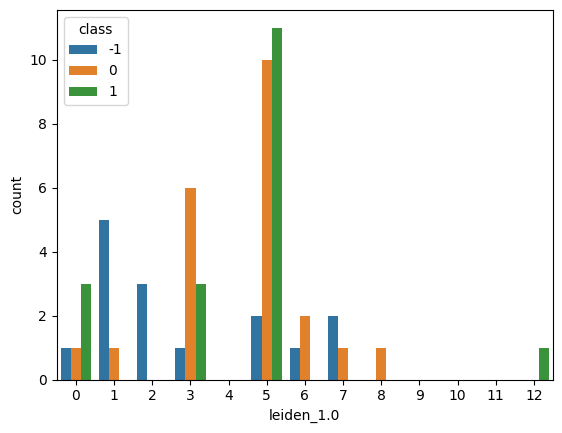

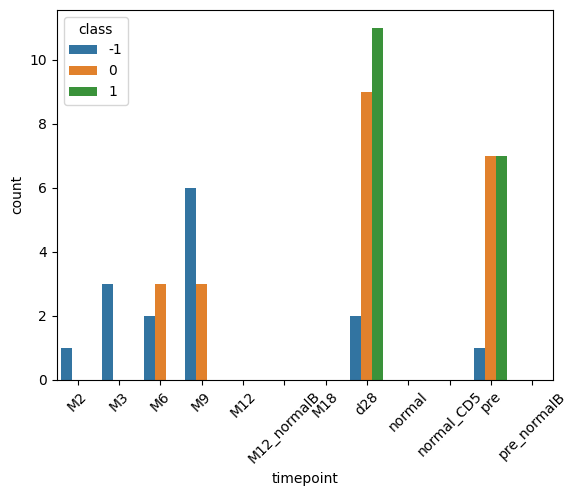

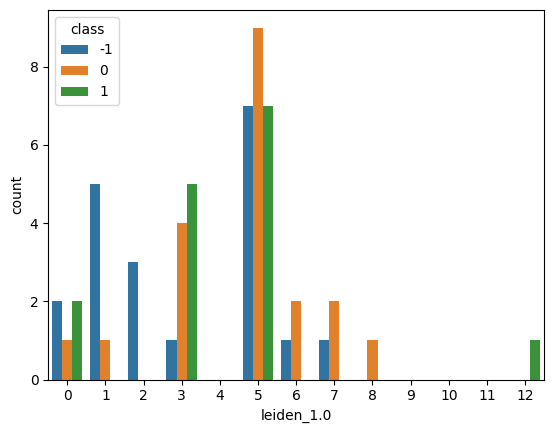

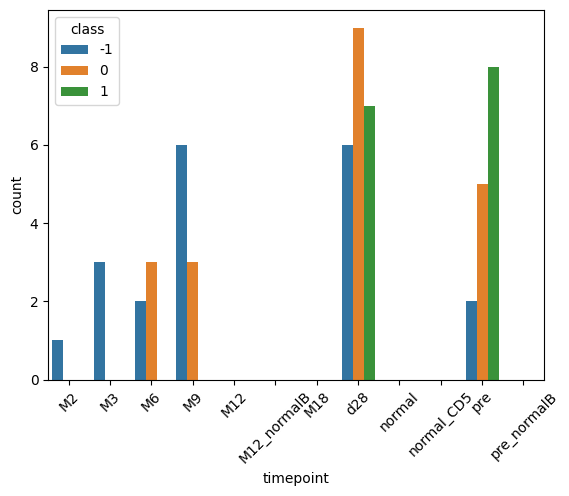

In [94]:
# NOT used
#patientId = "895557"
for q in ["", "_q30"]:#, "670730"]:
    df = pd.read_csv("scSnpMarker/%s_classify_result_wsampleid%s.out"%(patientId,q), sep="\t", 
                     header=None)
    df.columns = ["file_prefix", "class", "normal", "cancer", "neither", "noinfo", 
                  "cellid", "sampleid"]
    df = df.merge( adata.obs, left_on="cellid", right_index=True)

    cases = [(df["normal"] + df["cancer"]<4),
        (df["normal"] > df["cancer"]),
        (df["cancer"] > df["normal"])]
    df["class"] = np.select(cases, [-1, 0, 1], default=-1)
    
    sns.countplot(x="leiden_1.0", data=df, hue="class")
    plt.show() 
    
    ax = sns.countplot(x="timepoint", data=df, hue="class")
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45)
    plt.show()

In [60]:
scSnpMarkerDf = pd.DataFrame()
for patientId in ["895557", "1039747", "670730"]:
    df = pd.read_csv("scSnpMarker/%s_classify_result_wsampleid_q30.out"%(patientId), sep="\t", 
                     header=None)
    df.columns = ["file_prefix", "class", "pred", "normal", "cancer", "neither", "noinfo", 
                  "cellid", "sampleid"]
    df = df.merge( adata.obs, left_on="cellid", right_index=True)
    scSnpMarkerDf = pd.concat([scSnpMarkerDf, df], ignore_index=True)
    
cases = [(scSnpMarkerDf["normal"] + scSnpMarkerDf["cancer"]<4),
    (scSnpMarkerDf["normal"] > scSnpMarkerDf["cancer"]),
    (scSnpMarkerDf["cancer"] > scSnpMarkerDf["normal"])]
scSnpMarkerDf["pred"] = np.select(cases, [-1, 0, 1], default=-1)

In [47]:
scSnpMarkerDf

,file_prefix,class,pred,normal,cancer,neither,noinfo,cellid,sampleid,batch,...,cd19 expression,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden_1.0,raw_pateint,reduced_time,scSnpMarker_category,mypred
0,batch4_895557_pre_H05_RX11153_S281,1,1,5,11,0,80,batch4_S281,895557_pre,batch4,...,pos,11584,806934.837246,111495.902769,13.817213,5,895557,pre,NaN,1
1,batch4_895557_pre_H09_RX11153_S285,1,1,6,9,0,81,batch4_S285,895557_pre,batch4,...,pos,10097,859616.822704,59449.413058,6.915804,0,895557,pre,NaN,1
2,batch4_895557_pre_F07_RX11153_S259,1,1,11,15,0,70,batch4_S259,895557_pre,batch4,...,pos,9234,862158.254954,79910.144526,9.268617,3,895557,pre,NaN,1
3,batch4_895557_pre_A10_RX11153_S298,1,1,6,20,0,70,batch4_S298,895557_pre,batch4,...,pos,13199,831306.320830,37958.657939,4.566146,3,895557,pre,NaN,1
4,batch4_895557_pre_A12_RX11153_S300,1,1,0,7,0,89,batch4_S300,895557_pre,batch4,...,pos,11785,766424.999630,93994.035796,12.263957,1,895557,pre,NaN,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
523,batch3_670730_M6_G03_RX11003_S171,-1,1,0,3,0,31,batch3_S171,670730_M6,batch3,...,Unknown,9665,856484.950226,41139.043221,4.803242,5,670730,M4-,NaN,-1
524,batch3_670730_M3_D05_RX11003_S137,-1,1,1,2,0,31,batch3_S137,670730_M3,batch3,...,Unknown,10438,802583.782493,45697.654849,5.693817,5,670730,M1-3,NaN,-1
525,batch3_670730_M3_D08_RX11003_S140,-1,0,2,0,0,32,batch3_S140,670730_M3,batch3,...,Unknown,9574,785944.541576,96169.212533,12.236132,0,670730,M1-3,NaN,-1
526,batch3_670730_M3_D09_RX11003_S141,-1,1,0,2,0,32,batch3_S141,670730_M3,batch3,...,Unknown,9950,842586.034272,50866.246487,6.036920,8,670730,M1-3,NaN,-1


In [497]:
scSnpMarkerDf.to_csv("scSnpMarkerDf.csv")

In [548]:
#1039747-MCL07
#895557-MCL11

{'966723': 'MCL01',
 '923252': 'MCL02',
 '753528': 'MCL03',
 '687648': 'MCL04',
 '767639': 'MCL05',
 '670730': 'MCL06',
 '1039747': 'MCL07',
 '693381': 'MCL08',
 '1046105': 'MCL09',
 '957884': 'MCL10',
 '895557': 'MCL11',
 'PBMC13': 'HD1',
 'PBMC16': 'HD2',
 'PBMC17': 'HD3'}

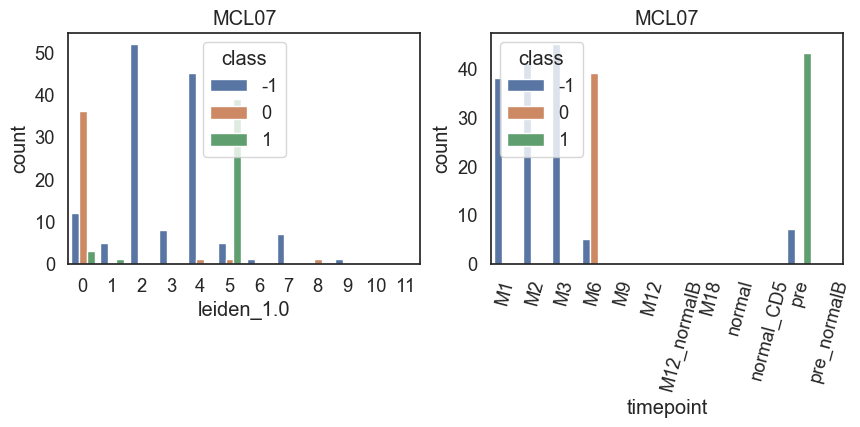

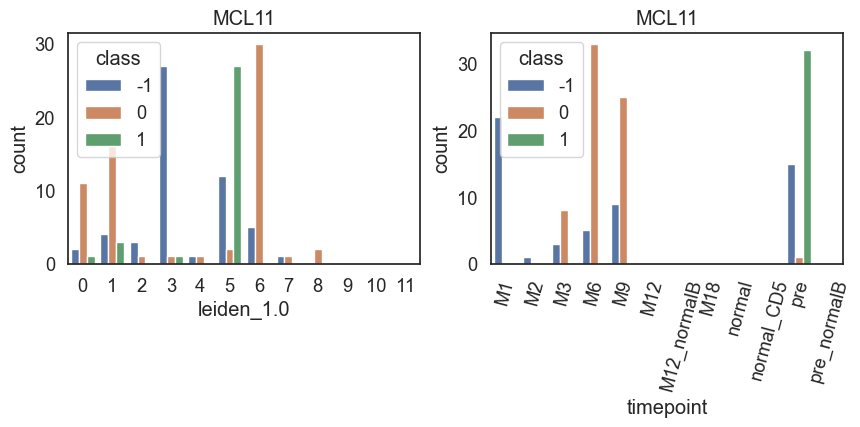

In [111]:
# Use raw labeling 
#for patientId in ["895557", "1039747", "670730"]:
for patientId in ["MCL07", "MCL11"]:
    df = scSnpMarkerDf.loc[ scSnpMarkerDf["patient"] == patientId]
    
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10,3))
    
    #df = df[ df["class"] == -1]
    #df["pred"] = np.select(cases, [-1, 0, 1], default=-1)
    
    ax = sns.countplot(x="leiden_1.0", data=df, hue="class", ax=axes[0])
    ax.set(title=patientId)
    
    ax = sns.countplot(x="timepoint", data=df, hue="class", ax=axes[1])
    ax.set(title=patientId)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=75)
    plt.show()
    

In [552]:
df.columns

Index(['file_prefix', 'class', 'pred', 'normal', 'cancer', 'neither', 'noinfo',
       'cellid', 'sampleid', 'batch', 'patient', 'timepoint', 'picking',
       'cd19 expression', 'n_genes_by_counts', 'total_counts',
       'total_counts_mt', 'pct_counts_mt', 'leiden_1.0', 'raw_pateint',
       'reduced_time', 'index_backup', 'junction', 'T4_entropy',
       'T4_clonality'],
      dtype='object')

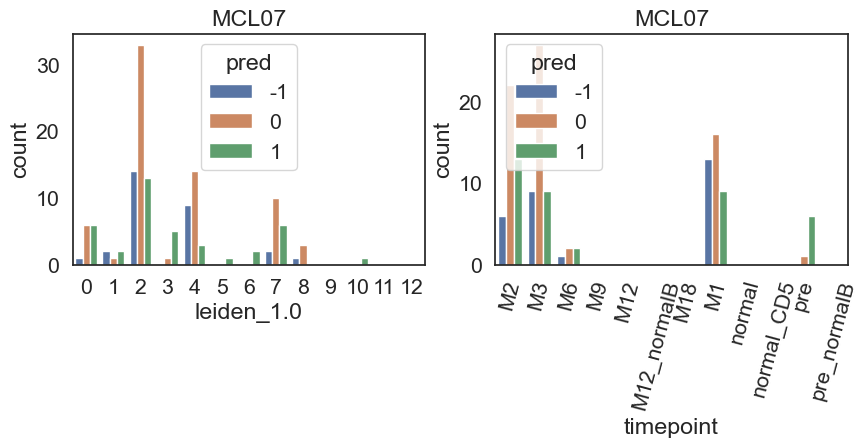

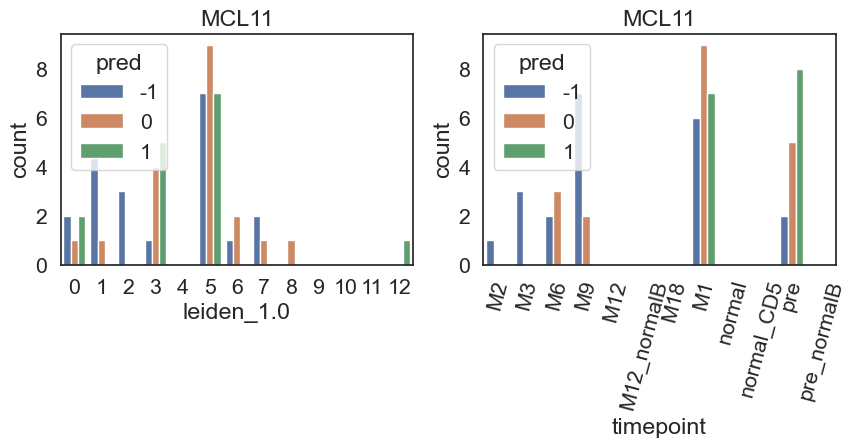

In [554]:
# Just the predicted label
#for patientId in ["895557", "1039747", "670730"]:
for patientId in ["MCL07", "MCL11"]:
    df = scSnpMarkerDf.loc[ scSnpMarkerDf["patient"] == patientId]
    
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10,3))
    
    df = df[ df["class"] == -1]
    #cases = [(df["normal"] + df["cancer"]<3),
    #    (df["normal"] > df["cancer"]),
    #    (df["cancer"] > df["normal"])]
    #df["pred"] = np.select(cases, [-1, 0, 1], default=-1)
    
    ax = sns.countplot(x="leiden_1.0", data=df, hue="pred", ax=axes[0])
    ax.set(title=patientId)
    
    ax = sns.countplot(x="timepoint", data=df, hue="pred", ax=axes[1])
    ax.set(title=patientId)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=75)
    plt.show()

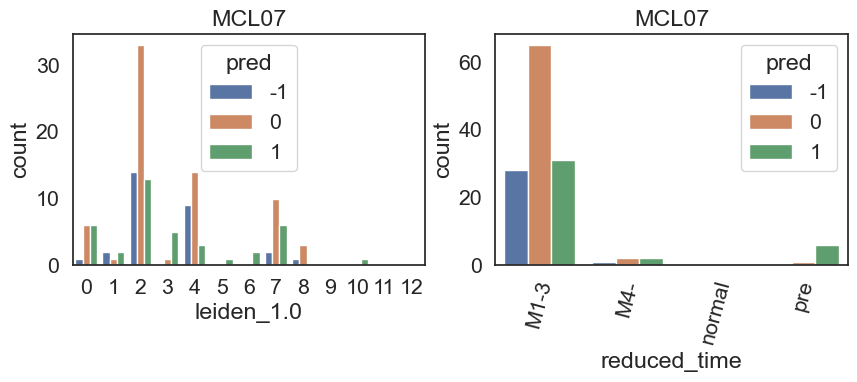

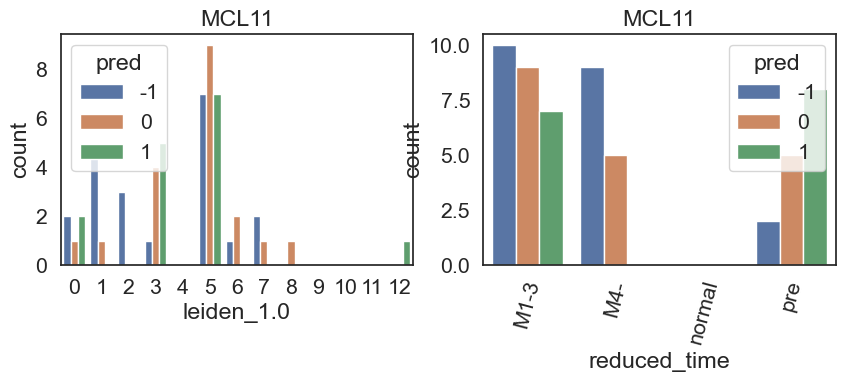

In [555]:
# Just the predicted label, with 
#for patientId in ["895557", "1039747", "670730"]:
for patientId in ["MCL07", "MCL11"]:
    df = scSnpMarkerDf.loc[ scSnpMarkerDf["patient"] == patientId]
    
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10,3))
    
    df = df[ df["class"] == -1]
    #cases = [(df["normal"] + df["cancer"]<3),
    #    (df["normal"] > df["cancer"]),
    #    (df["cancer"] > df["normal"])]
    #df["pred"] = np.select(cases, [-1, 0, 1], default=-1)
    
    ax = sns.countplot(x="leiden_1.0", data=df, hue="pred", ax=axes[0])
    ax.set(title=patientId)
    
    ax = sns.countplot(x="reduced_time", data=df, hue="pred", ax=axes[1])
    ax.set(title=patientId)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=75)
    plt.show()

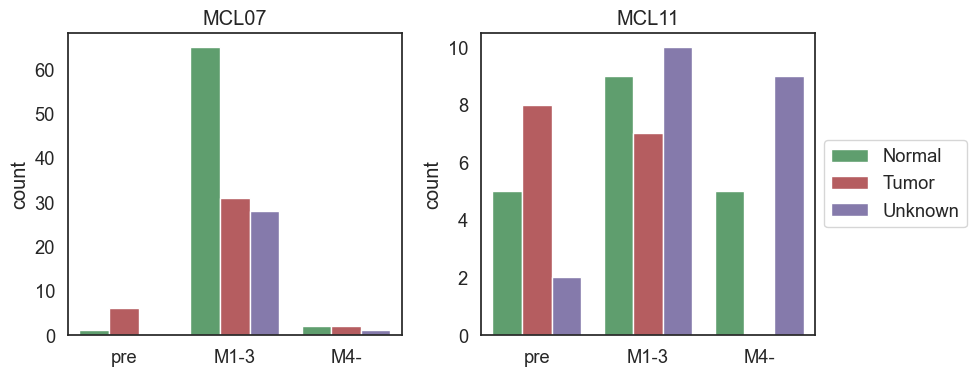

In [112]:
# Final Figure
selectedTime = ["pre", "M1-3", "M4-"]
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10,4))
    
#cases = [(df["normal"] + df["cancer"]<3),
#    (df["normal"] > df["cancer"]),
#    (df["cancer"] > df["normal"])]
#df["pred"] = np.select(cases, [-1, 0, 1], default=-1)
mypalette = sns.color_palette(None, 5)
mypalette[0:3] = mypalette[2:5]
hueOrder = [0, 1, -1]
for i,patientId in enumerate(["MCL07", "MCL11"]):
    df = scSnpMarkerDf.loc[ scSnpMarkerDf["patient"] == patientId]
    df = df[ df["class"] == -1]
    ax = sns.countplot(x="reduced_time", data=df, hue="pred", ax=axes[i],
                      order=selectedTime, palette=mypalette, hue_order = hueOrder)
    ax.set(title=patientId, xlabel="")
    ax.set_xticklabels(ax.get_xticklabels())
    if (i == 0):
        ax.get_legend().remove()
    else:
        ax.legend(labels = ["Normal", "Tumor", "Unknown"],
                            loc="center left", bbox_to_anchor=[1,0.5])
plt.tight_layout()
plt.savefig("scSnpMarker/scSnpMarker_reduced_timepoint_nobcronly.pdf", format="pdf",
           bbox_inches="tight")
plt.show()

/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_25964/4095242555.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['class+pred'] = np.where(df["class"] != -1, df['class'], df['pred'])
/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_25964/4095242555.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['class+pred'] = np.where(df["class"] != -1, df['class'], df['pred'])


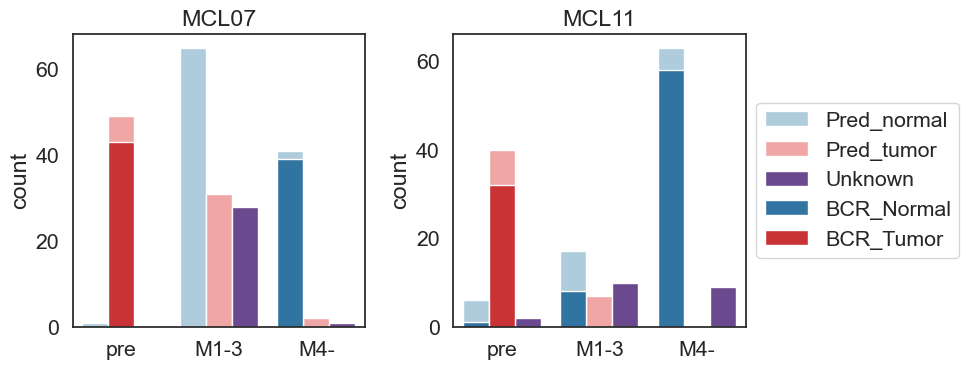

In [129]:
# Final Figure. With all BCR
selectedTime = ["pre", "M1-3", "M4-"]
sns.set(style="white", font_scale=1.4)
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10,4))
    
#cases = [(df["normal"] + df["cancer"]<3),
#    (df["normal"] > df["cancer"]),
#    (df["cancer"] > df["normal"])]
#df["pred"] = np.select(cases, [-1, 0, 1], default=-1)
#mypalette = sns.color_palette(None, 5)
#mypalette[0:3] = mypalette[2:5]
hueOrder = [0, 1, -1]
for i,patientId in enumerate(["MCL07", "MCL11"]):
    df = scSnpMarkerDf.loc[ scSnpMarkerDf["patient"] == patientId]
    #df = df[ df["class"] == -1]
    df['class+pred'] = np.where(df["class"] != -1, df['class'], df['pred'])
    pairedPalette = sns.color_palette("Paired", 10)
    
    mypalette = [pairedPalette[x] for x in [0,4,9]]
    ax = sns.countplot(x="reduced_time", data=df, hue="class+pred", ax=axes[i],
                      order=selectedTime, palette=mypalette, hue_order = hueOrder,
                      edgecolor="w")
    
    subdf = df[ df['class'] != -1]
    mypalette = [pairedPalette[x] for x in [1,5,9]]
    ax = sns.countplot(x="reduced_time", data=subdf, hue="class", ax=ax,
                      order=selectedTime, palette=mypalette, hue_order = hueOrder,
                      edgecolor="w")
    
    ax.set(title=patientId, xlabel="")
    ax.set_xticklabels(ax.get_xticklabels())
    if (i == 0):
        ax.get_legend().remove()
    else:
        ax.legend(labels = ["Pred_normal", "Pred_tumor", "Unknown",
                           "BCR_Normal", "BCR_Tumor"],
                            loc="center left", bbox_to_anchor=[1,0.5])
plt.tight_layout()
plt.savefig("scSnpMarker/scSnpMarker_reduced_timepoint_allstack.pdf", format="pdf",
           bbox_inches="tight")
plt.show()

In [89]:
subdf[(subdf["class"] == 0) & (subdf["reduced_time"]=="M1-3")]["timepoint"]

36    M3
44    M3
52    M3
54    M3
58    M3
62    M3
75    M3
87    M3
Name: timepoint, dtype: category
Categories (12, object): ['M1', 'M2', 'M3', 'M6', ..., 'normal', 'normal_CD5', 'pre', 'pre_normalB']

In [90]:
subdf

,file_prefix,class,pred,normal,cancer,neither,noinfo,cellid,sampleid,batch,...,picking,cd19 expression,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden_1.0,raw_pateint,reduced_time,class+pred
0,batch4_895557_pre_H05_RX11153_S281,1,1,5,11,0,80,batch4_S281,895557_pre,batch4,...,D,pos,11584,806934.837246,111495.902769,13.817213,3,895557,pre,1
1,batch4_895557_pre_H09_RX11153_S285,1,1,6,9,0,81,batch4_S285,895557_pre,batch4,...,D,pos,10097,859616.822704,59449.413058,6.915804,5,895557,pre,1
2,batch4_895557_pre_F07_RX11153_S259,1,1,11,15,0,70,batch4_S259,895557_pre,batch4,...,D,pos,9234,862158.254954,79910.144526,9.268617,5,895557,pre,1
3,batch4_895557_pre_A10_RX11153_S298,1,1,6,20,0,70,batch4_S298,895557_pre,batch4,...,D,pos,13199,831306.320830,37958.657939,4.566146,5,895557,pre,1
4,batch4_895557_pre_A12_RX11153_S300,1,1,0,7,0,89,batch4_S300,895557_pre,batch4,...,D,pos,11785,766424.999630,93994.035796,12.263957,1,895557,pre,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94,batch4_895557_M9_H12_RX11153_S480,0,0,11,0,0,85,batch4_S480,895557_M9,batch4,...,D,pos,12809,802603.587021,29426.552011,3.666387,1,895557,M4-,0
95,batch4_895557_M6_H07_RX11153_S379,0,0,3,1,0,92,batch4_S379,895557_M6,batch4,...,D,pos,8911,827682.847347,52197.833878,6.306502,6,895557,M4-,0
96,batch4_895557_M9_G02_RX11153_S458,0,0,4,0,1,91,batch4_S458,895557_M9,batch4,...,D,pos,13295,746779.510499,30348.163468,4.063872,1,895557,M4-,0
97,batch4_895557_M6_H08_RX11153_S380,0,0,13,0,0,83,batch4_S380,895557_M6,batch4,...,D,pos,10031,826762.985247,62644.164848,7.577040,6,895557,M4-,0


In [ ]:
# Just the predicted label, with 
#for patientId in ["895557", "1039747", "670730"]:
for patientId in ["MCL07", "MCL11"]:
    df = scSnpMarkerDf.loc[ scSnpMarkerDf["patient"] == patientId]
    
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10,3))
    
    df = df[ df["class"] == -1]
    #cases = [(df["normal"] + df["cancer"]<3),
    #    (df["normal"] > df["cancer"]),
    #    (df["cancer"] > df["normal"])]
    #df["pred"] = np.select(cases, [-1, 0, 1], default=-1)
    
    ax = sns.countplot(x="leiden_1.0", data=df, hue="pred", ax=axes[0])
    ax.set(title=patientId)
    
    ax = sns.countplot(x="reduced_time", data=df, hue="pred", ax=axes[1])
    ax.set(title=patientId)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=75)
    plt.show()

/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_12209/1933897623.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["pred0"] = np.select(cases, [-1, 0, 1], default=-1)
/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_12209/1933897623.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["pred"] = np.where(df["class"] != -1, df["class"], df["pred0"])


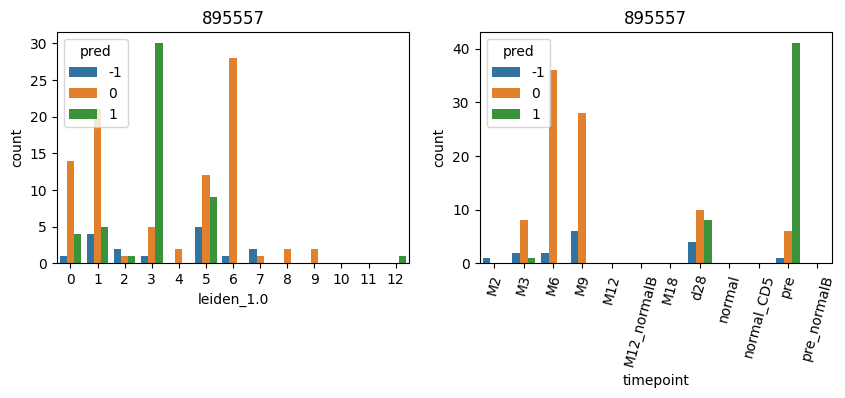

/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_12209/1933897623.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["pred0"] = np.select(cases, [-1, 0, 1], default=-1)
/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_12209/1933897623.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["pred"] = np.where(df["class"] != -1, df["class"], df["pred0"])


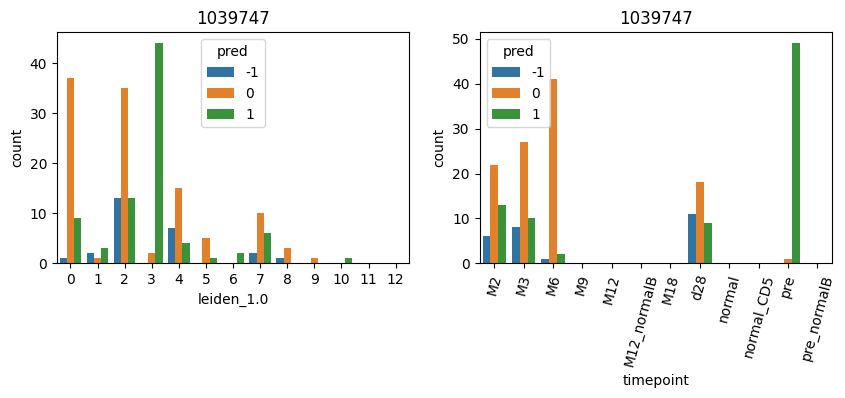

/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_12209/1933897623.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["pred0"] = np.select(cases, [-1, 0, 1], default=-1)
/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_12209/1933897623.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["pred"] = np.where(df["class"] != -1, df["class"], df["pred0"])


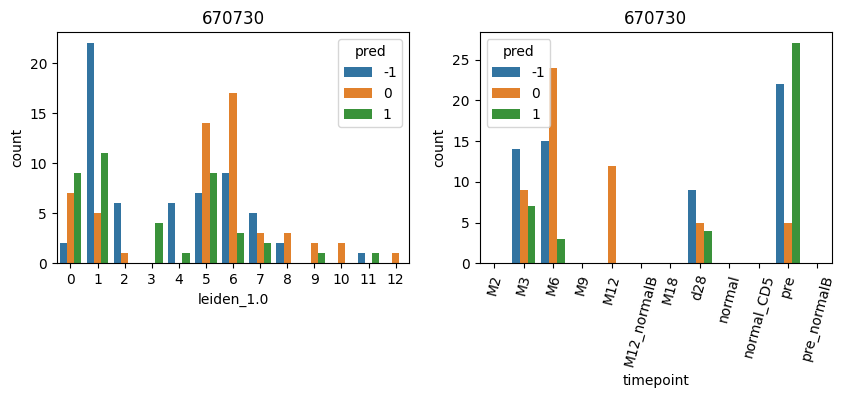

In [190]:
# include the raw labeling 
for patientId in ["895557", "1039747", "670730"]:
    df = scSnpMarkerDf.loc[ scSnpMarkerDf["patient"] == patientId]
    
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10,3))
    
    #df = df[ df["class"] == -1]
    cases = [(df["normal"] + df["cancer"]<4),
        (df["normal"] > df["cancer"]),
        (df["cancer"] > df["normal"])]
    df["pred0"] = np.select(cases, [-1, 0, 1], default=-1)
    df["pred"] = np.where(df["class"] != -1, df["class"], df["pred0"])
    
    ax = sns.countplot(x="leiden_1.0", data=df, hue="pred", ax=axes[0])
    ax.set(title=patientId)
    
    ax = sns.countplot(x="timepoint", data=df, hue="pred", ax=axes[1])
    ax.set(title=patientId)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=75)
    plt.show()

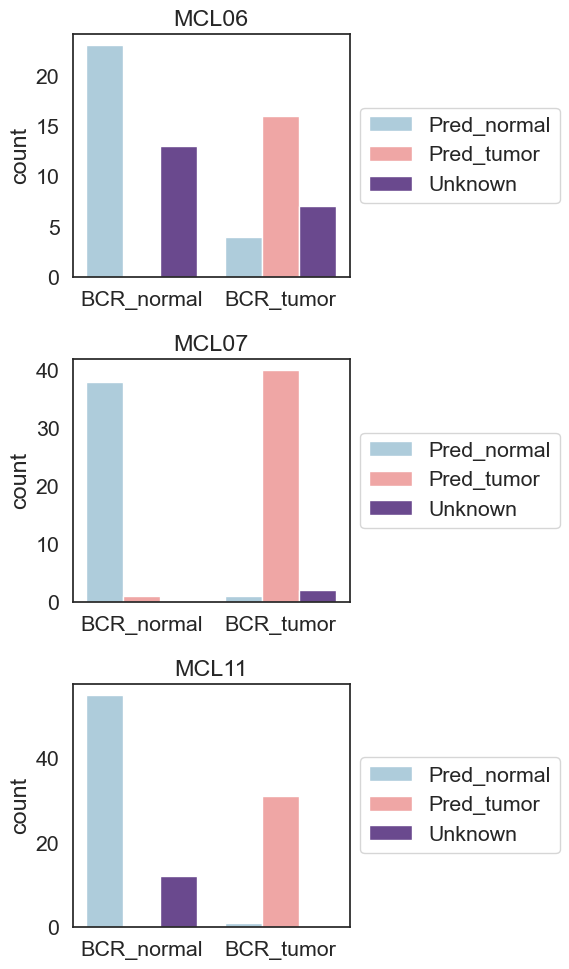

In [130]:
# Final figure: Use BCR-labels to validate accuracy
fig, axes = plt.subplots(nrows=3, ncols=1, figsize=(6,10))
for i, patientId in enumerate(["MCL06", "MCL07", "MCL11"]):#, "670730"]:
    df = scSnpMarkerDf.loc[ scSnpMarkerDf["patient"] == patientId]
    df = df[ df["class"] != -1]
    mypalette = [sns.color_palette("Paired", 10)[x] for x in [0,4,9]]
    ax = sns.countplot(x="class", data=df, hue="pred", hue_order=[0, 1, -1],
                      palette = mypalette, ax=axes[i])
    ax.set(title=patientId)
    ax.set_xticklabels(["BCR_normal", "BCR_tumor"])
    ax.set(xlabel="")
    ax.legend(labels = ["Pred_normal", "Pred_tumor", "Unknown"],
                        loc="center left", bbox_to_anchor=[1,0.5])
plt.tight_layout()
plt.savefig("scSnpMarker/scSnpMarker_bcrcell_validation.pdf", format="pdf",
           bbox_inches="tight")
plt.show()
    

In [114]:
tmpDf = scSnpMarkerDf[["cellid", "class", "pred"]]
predDescOrder = ["BCR_normal", "BCR_tumor", "Pred_normal", "Pred_tumor", "Unknown"]
cases = [(tmpDf["class"]==0),
         tmpDf["class"] == 1,
    (tmpDf["class"] == -1) & (tmpDf["pred"] == 0),
    (tmpDf["class"] == -1) & (tmpDf["pred"] == 1),
    (tmpDf["class"] == -1) & (tmpDf["pred"] == -1)]
tmpDf["pred_desc"] = np.select(cases, predDescOrder, default="unknown")

/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_25964/2530158369.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tmpDf["pred_desc"] = np.select(cases, predDescOrder, default="unknown")


In [580]:
adata

AnnData object with n_obs × n_vars = 1683 × 2000
    obs: 'batch', 'patient', 'timepoint', 'picking', 'cd19 expression', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden_1.0', 'raw_pateint', 'reduced_time', 'index_backup', 'junction', 'T4_entropy', 'T4_clonality'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'imrep', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'log1p', 'neighbors', 'pca'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [115]:
subAdata = adata[ adata.obs["patient"].isin(["MCL07", "MCL11"]) ]
subAdata.obs = subAdata.obs.merge(tmpDf, left_index=True, right_on="cellid").set_index("cellid")

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/anndata/_core/anndata.py:1222: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/anndata/_core/anndata.py:1222: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/anndata/_core/anndata.py:1222: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


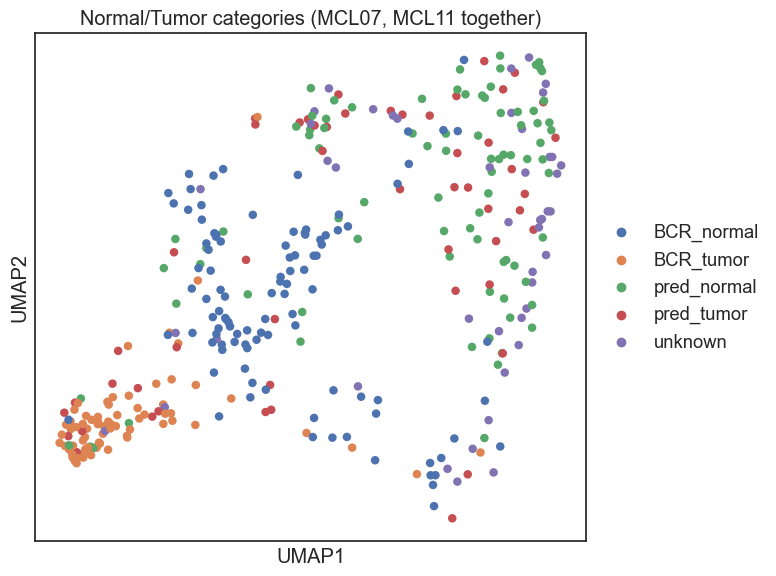

In [116]:
# UMAP to show the different prediction categories
with plt.rc_context({"figure.figsize": (8, 6)}):
    mypalette = sns.color_palette(None, 5)
    #mypalette[1], mypalette[2] = mypalette[2], mypalette[1]
    ax = sc.pl.umap(subAdata[ subAdata.obs["leiden_1.0"].isin(clusterList)], 
                color=["pred_desc"], palette=mypalette,
                show=False, ncols=1,
               size=150)
    ax.set(title="Normal/Tumor categories (MCL07, MCL11 together)")
plt.tight_layout()
plt.savefig("scSnpMarker/umap_scSnpMarker_all.pdf", format="pdf")

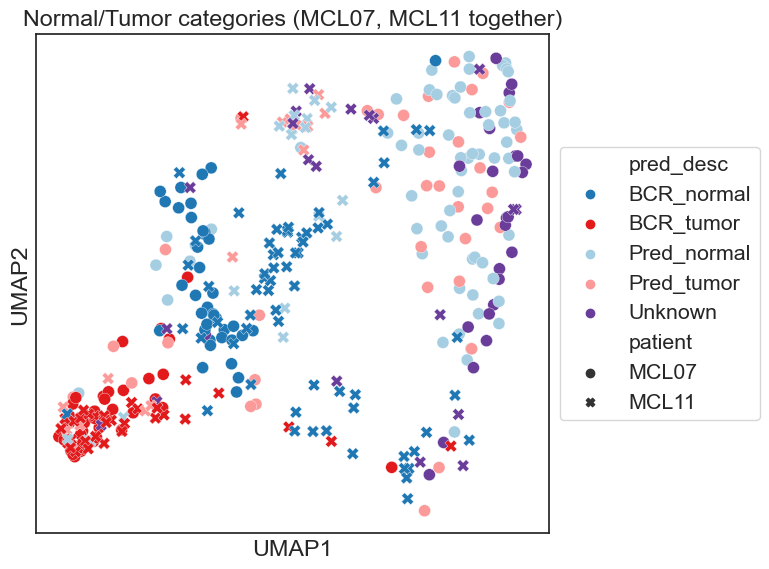

In [131]:
tmpDf = subAdata.obs.copy()
tmpDf["UMAP1"] = subAdata.obsm["X_umap"][:,0]
tmpDf["UMAP2"] = subAdata.obsm["X_umap"][:,1]
mypalette = [sns.color_palette("Paired", 10)[x] for x in [1, 5, 0, 4, 9]]

with plt.rc_context({"figure.figsize": (8, 6)}):
    ax = sns.scatterplot(x="UMAP1", y="UMAP2", data=tmpDf[ tmpDf["leiden_1.0"].isin(clusterList)], 
                   hue="pred_desc", palette=mypalette,
                    style="patient", s=75, linewidth=0.25,
                    hue_order = predDescOrder)
    ax.legend(loc="center left", bbox_to_anchor=[1,0.5])
    
    ax.set(title="Normal/Tumor categories (MCL07, MCL11 together)")
    ax.get_xaxis().set_ticks([])
    ax.get_yaxis().set_ticks([])
    plt.tight_layout()
plt.savefig("scSnpMarker/umap_scSnpMarker_all.pdf", format="pdf",
           bbox_inches="tight")
plt.show()

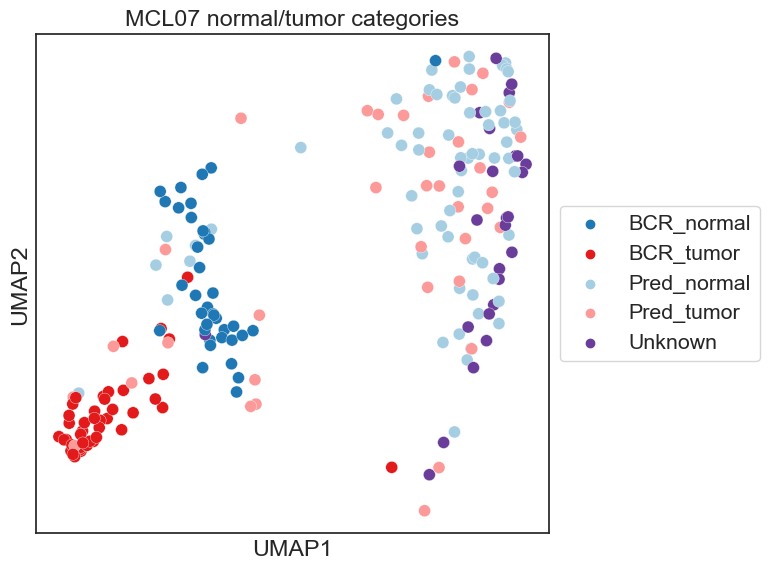

In [132]:
tmpDf = subAdata.obs.copy()
tmpDf["UMAP1"] = subAdata.obsm["X_umap"][:,0]
tmpDf["UMAP2"] = subAdata.obsm["X_umap"][:,1]
mypalette = [sns.color_palette("Paired", 10)[x] for x in [1, 5, 0, 4, 9]]
with plt.rc_context({"figure.figsize": (8, 6)}):
    ax = sns.scatterplot(x="UMAP1", y="UMAP2", 
                         data=tmpDf[ (tmpDf["leiden_1.0"].isin(clusterList)) 
                                    & (tmpDf["patient"] == "MCL07")], 
                   hue="pred_desc", palette=mypalette, s=75, linewidth=0.25,
                    hue_order = predDescOrder)
    ax.legend(loc="center left", bbox_to_anchor=[1,0.5])
    
    ax.set(title="MCL07 normal/tumor categories")
    ax.get_xaxis().set_ticks([])
    ax.get_yaxis().set_ticks([])
    plt.tight_layout()
plt.savefig("scSnpMarker/umap_scSnpMarker_mcl07.pdf", format="pdf",
           bbox_inches="tight")
plt.show()

In [118]:
predDescOrder

['BCR_normal', 'BCR_tumor', 'Pred_normal', 'Pred_tumor', 'Unknown']

In [128]:
# DEG analysis between post vs pre cancer cells
patientId = "MCL11"
df = scSnpMarkerDf.loc[ scSnpMarkerDf["patient"] == patientId]
cases = [(df["normal"] + df["cancer"]<4),
    (df["normal"] > df["cancer"]),
    (df["cancer"] > df["normal"])]
df["pred0"] = np.select(cases, [-1, 0, 1], default=-1)
df["pred"] = np.where(df["class"] != -1, df["class"], df["pred0"])

cases = [((df["timepoint"] == "pre") & (df["pred"]==1)),
        ((df["timepoint"] != "pre") & (df["pred"]==1))]
df["pre_cancer"] = np.select(cases, ["1", "0"], default="-1")

simpleDf = df[ ["cellid", "pre_cancer"] ]
simpleDf = simpleDf.set_index("cellid")

if ("pre_cancer" in adata.obs.columns):
    adata.obs = adata.obs.drop("pre_cancer", axis=1)
adata.obs = adata.obs.join(simpleDf)
adata.obs["pre_cancer"] = adata.obs["pre_cancer"].astype("category")

/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_66954/1027537981.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["pred0"] = np.select(cases, [-1, 0, 1], default=-1)
/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_66954/1027537981.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["pred"] = np.where(df["class"] != -1, df["class"], df["pred0"])
/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_66954/1027537981.py:12: SettingWithCopyWarning: 
A value is trying to be se

In [61]:
simpleDf

,pre_cancer
cellid,
batch3_S241,1
batch3_S254,1
batch3_S220,1
batch3_S225,1
batch3_S246,1
...,...
batch3_S265,-1
batch3_S284,-1
batch3_S223,1


In [ ]:
# Do DGE on predicted normal, predicted cancer, BCR normal, and BCR cancer

In [120]:
adata.obs["pre_cancer"].value_counts()

pre_cancer
-1    136
1      49
0      33
Name: count, dtype: int64

In [129]:
adata.uns["log1p"]["base"] = None
sc.tl.rank_genes_groups(adata, groupby="pre_cancer", 
                        method='wilcoxon',
                        groups=[0, 1])

In [130]:
n = 15 # number of markers from each cluster
key = "rank_genes_groups"
clusterList = adata.uns[key]["pvals_adj"].dtype.names
markerSet = set({})
markers = []
logfoldchange = 1
pvalCutoff = 0.05
if (patientId == "MCL11"):
    pvalCutoff = 0.4
for cluster in ["0", "1"]:
    cnt = 0
    for j, g in enumerate(adata.uns[key]["names"][cluster]):
        #print(i, j, g, data.uns["rank_genes_groups"]["pvals_adj"][i][j])
        if (adata.uns[key]["pvals_adj"][cluster][j] >= pvalCutoff
           or adata.uns[key]["logfoldchanges"][cluster][j] < 1):
            continue
        if (g.startswith("RP") or g.startswith("MT-")):
            continue
        if (g not in markerSet):
            markers.append(g)
            markerSet.add(g)
        cnt += 1
        if (cnt >= n):
            break
    print(cnt)
#sc.pl.rank_genes_groups_heatmap(adata[adata.obs["pre_cancer"].isin([0.0, 1.0])], 
#                       show_gene_labels=True, 
#                       key=key, var_names=list(markers),
#                       swap_axes=True, show=False)

15
15


In [83]:
for i, x in enumerate(adata.uns["rank_genes_groups"]["names"]):
    if (x[0] == "IFITM2"):
        print(i, adata.uns["rank_genes_groups"]["pvals_adj"][i],
             adata.uns["rank_genes_groups"]["logfoldchanges"][i])

5 (0.35782829, 9.32018081e-17) (3.6017551, 7.057636)


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list


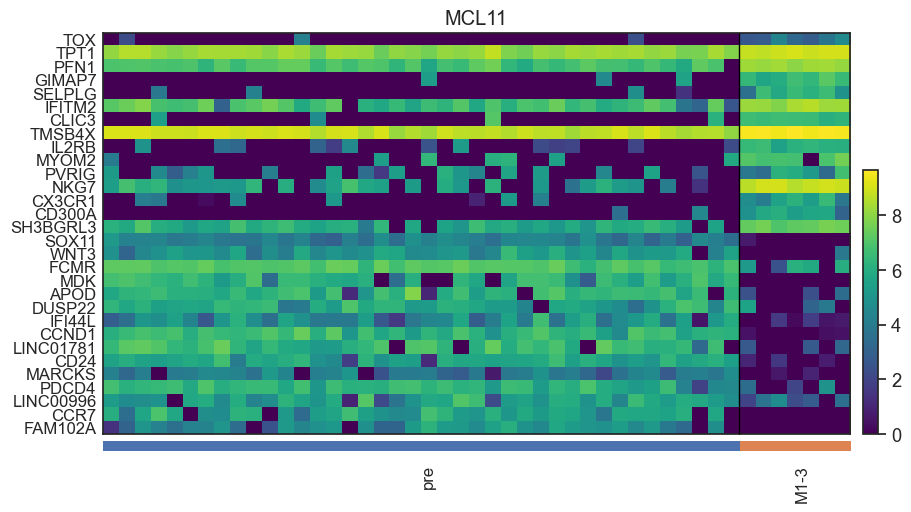

In [131]:
adata.obs["reduced_time"] = adata.obs["reduced_time"].cat.reorder_categories(["normal", "pre", "M1-3", "M4-"])
ax = sc.pl.heatmap(adata[adata.obs["pre_cancer"].isin(["0", "1"])], 
                       groupby="reduced_time", 
                       show_gene_labels=True, 
                       var_names=list(markers),
                       swap_axes=True, show=False, cmap="viridis")
ax["heatmap_ax"].set(title=patientId)
ax["groupby_ax"].set(xlabel="")

plt.savefig(f"scSnpMarker/heatmap_scSnpMarker_prepost_cancer_{patientId}.pdf", format="pdf",
           bbox_inches="tight")

In [93]:
ax["heatmap_ax"]

<Axes: >

In [72]:
adata.obs["reduced_time"].value_counts()

reduced_time
M1-3      527
pre       426
M4-       407
normal    245
Name: count, dtype: int64

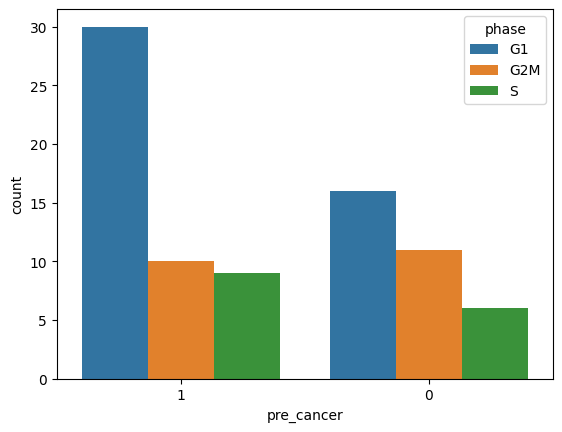

In [381]:
# cell cycle for this patient
tmpDf = adata.obs[adata.obs["pre_cancer"].isin(["0", "1"])]
ax = sns.countplot(x="pre_cancer", hue="phase", data=tmpDf, order=["1", "0"])

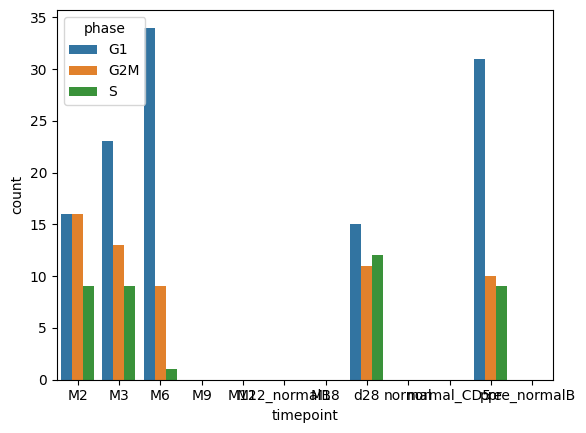

In [384]:
# cell cycle for this patient
tmpDf = adata.obs[adata.obs["patient"]==patientId]
ax = sns.countplot(x="timepoint", hue="phase", data=tmpDf)

In [136]:
adata.obs

,batch,patient,timepoint,picking,cd19 expression,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden_1.0,raw_pateint,scSnpMarker_category
batch1_S1,batch1,HD1,normal,D,pos,9753,828690.973979,57756.243776,6.969576,0,PBMC13,NaN
batch1_S10,batch1,HD1,normal,D,pos,10188,854050.840136,38392.017611,4.495285,0,PBMC13,NaN
batch1_S100,batch1,MCL03,pre,S,pos,11248,827730.086682,53239.283250,6.431962,7,753528,NaN
batch1_S101,batch1,MCL03,pre,D,pos,9026,908373.480852,41163.609974,4.531573,5,753528,NaN
batch1_S102,batch1,MCL03,pre,D,pos,4738,889274.342253,34622.911165,3.893389,5,753528,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
batch4_S95,batch4,MCL08,M1,D,pos,5706,828051.723576,153651.310291,18.555762,2,693381,NaN
batch4_S96,batch4,MCL08,M1,S,pos,6341,755590.221229,143769.890304,19.027495,4,693381,NaN
batch4_S97,batch4,MCL08,M1,D,pos,9039,796180.808463,60950.068853,7.655305,4,693381,NaN
batch4_S98,batch4,MCL08,M1,D,neg,7781,791343.784788,122691.448853,15.504191,2,693381,NaN


#### DEG among predicted normal, predicted cancer, BCR normal, and BCR cancer

In [30]:
patientId = "MCL07"
df = scSnpMarkerDf.loc[ scSnpMarkerDf["patient"] == patientId]
#cases = [(df["normal"] + df["cancer"]<4),
#    (df["normal"] > df["cancer"]),
#    (df["cancer"] > df["normal"])]
#df["pred"] = np.select(cases, [-1, 0, 1], default=-1)
#df["pred"] = np.where(df["class"] != -1, -1, df["pred0"])

categoryList = ["bcr_normal", "bcr_cancer", "pred_normal", "pred_cancer"]
cases = [df["class"] == 0,
        df["class"]==1,
        df["pred"] == 0,
        df["pred"] == 1]
df["scSnpMarker_category"] = np.select(cases, categoryList, default="-1")

simpleDf = df[ ["cellid", "scSnpMarker_category"] ]
simpleDf = simpleDf.set_index("cellid")

if ("scSnpMarker_category" in adata.obs.columns):
    adata.obs = adata.obs.drop("scSnpMarker_category", axis=1)
adata.obs = adata.obs.join(simpleDf)
adata.obs["scSnpMarker_category"] = adata.obs["scSnpMarker_category"].astype("category")

/var/folders/c8/zsnj8w1x221_yh1cvqwq68n80000gn/T/ipykernel_40968/1389478025.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["scSnpMarker_category"] = np.select(cases, categoryList, default="-1")


In [26]:
scSnpMarkerDf

,file_prefix,class,pred,normal,cancer,neither,noinfo,cellid,sampleid,batch,...,timepoint,picking,cd19 expression,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden_1.0,raw_pateint,reduced_time
0,batch4_895557_pre_H05_RX11153_S281,1,1,5,11,0,80,batch4_S281,895557_pre,batch4,...,pre,D,pos,11584,806934.837246,111495.902769,13.817213,5,895557,pre
1,batch4_895557_pre_H09_RX11153_S285,1,1,6,9,0,81,batch4_S285,895557_pre,batch4,...,pre,D,pos,10097,859616.822704,59449.413058,6.915804,0,895557,pre
2,batch4_895557_pre_F07_RX11153_S259,1,1,11,15,0,70,batch4_S259,895557_pre,batch4,...,pre,D,pos,9234,862158.254954,79910.144526,9.268617,3,895557,pre
3,batch4_895557_pre_A10_RX11153_S298,1,1,6,20,0,70,batch4_S298,895557_pre,batch4,...,pre,D,pos,13199,831306.320830,37958.657939,4.566146,3,895557,pre
4,batch4_895557_pre_A12_RX11153_S300,1,1,0,7,0,89,batch4_S300,895557_pre,batch4,...,pre,D,pos,11785,766424.999630,93994.035796,12.263957,1,895557,pre
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
523,batch3_670730_M6_G03_RX11003_S171,-1,-1,0,3,0,31,batch3_S171,670730_M6,batch3,...,M6,D,Unknown,9665,856484.950226,41139.043221,4.803242,5,670730,M4-
524,batch3_670730_M3_D05_RX11003_S137,-1,-1,1,2,0,31,batch3_S137,670730_M3,batch3,...,M3,D,Unknown,10438,802583.782493,45697.654849,5.693817,5,670730,M1-3
525,batch3_670730_M3_D08_RX11003_S140,-1,-1,2,0,0,32,batch3_S140,670730_M3,batch3,...,M3,D,Unknown,9574,785944.541576,96169.212533,12.236132,0,670730,M1-3
526,batch3_670730_M3_D09_RX11003_S141,-1,-1,0,2,0,32,batch3_S141,670730_M3,batch3,...,M3,D,Unknown,9950,842586.034272,50866.246487,6.036920,8,670730,M1-3


In [18]:
adata.uns["log1p"]["base"] = None
sc.tl.rank_genes_groups(adata, groupby="scSnpMarker_category", 
                        method='wilcoxon',
                        groups=categoryList)

15
15
15
5


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list


{'heatmap_ax': <Axes: >,
 'groupby_ax': <Axes: xlabel='scSnpMarker_category'>,
 'dendrogram_ax': <Axes: >}

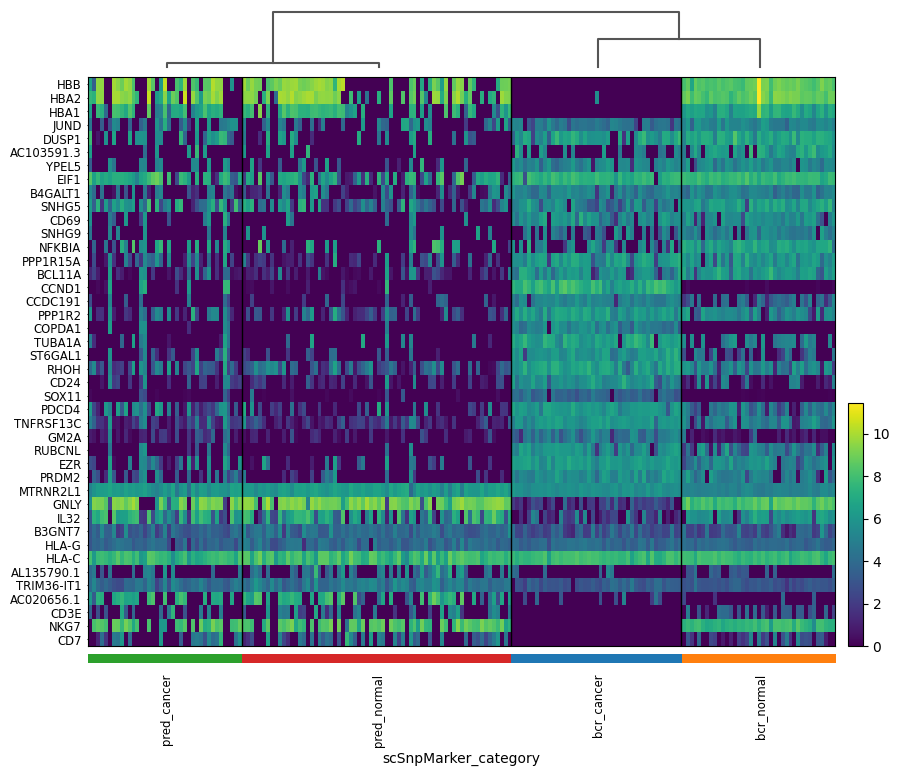

In [19]:
n = 15 # number of markers from each cluster
key = "rank_genes_groups"
clusterList = adata.uns[key]["pvals_adj"].dtype.names
markerSet = set({})
markers = []
logfoldchange = 1
for cluster in categoryList:
    cnt = 0
    for j, g in enumerate(adata.uns[key]["names"][cluster]):
        #print(i, j, g, data.uns["rank_genes_groups"]["pvals_adj"][i][j])
        if (adata.uns[key]["pvals_adj"][cluster][j] >= 0.05
           or adata.uns[key]["logfoldchanges"][cluster][j] < 1):
            continue
        if (g.startswith("RP") or g.startswith("MT-")):
            continue
        if (g not in markerSet):
            markers.append(g)
            markerSet.add(g)
        cnt += 1
        if (cnt >= n):
            break
    print(cnt)
sc.pl.rank_genes_groups_heatmap(adata[adata.obs["scSnpMarker_category"].isin(categoryList)], 
                       show_gene_labels=True, 
                       key=key, var_names=list(markers),
                       swap_axes=True, show=False)

In [31]:
adata.uns["log1p"]["base"] = None
sc.tl.rank_genes_groups(adata, groupby="scSnpMarker_category", 
                        method='wilcoxon',
                        groups=["pred_normal", "pred_cancer"])

23
6


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list


{'heatmap_ax': <Axes: >,
 'groupby_ax': <Axes: xlabel='scSnpMarker_category'>,
 'dendrogram_ax': <Axes: >}

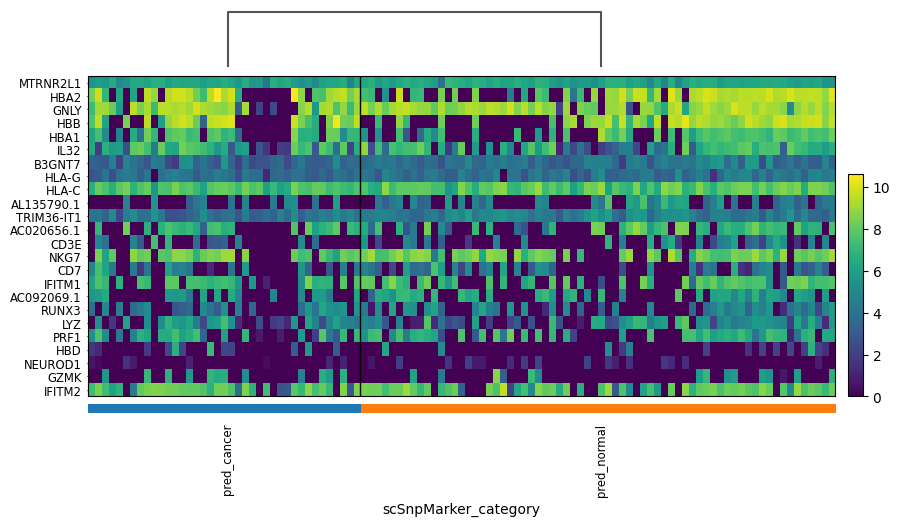

In [40]:
n = 40 # number of markers from each cluster
key = "rank_genes_groups"
clusterList = adata.uns[key]["pvals_adj"].dtype.names
markerSet = set({})
markers = []
logfoldchange = 1
for cluster in ["pred_normal", "pred_cancer"]:
    cnt = 0
    for j, g in enumerate(adata.uns[key]["names"][cluster]):
        #print(i, j, g, data.uns["rank_genes_groups"]["pvals_adj"][i][j])
        if (adata.uns[key]["pvals_adj"][cluster][j] >= 0.2
           or adata.uns[key]["logfoldchanges"][cluster][j] < 1):
            continue
        if (g.startswith("RP") or g.startswith("MT-")):
            continue
        if (g not in markerSet):
            markers.append(g)
            markerSet.add(g)
        cnt += 1
        if (cnt >= n):
            break
    print(cnt)
sc.pl.rank_genes_groups_heatmap(adata[adata.obs["scSnpMarker_category"].isin(["pred_normal", "pred_cancer"])], 
                       show_gene_labels=True, 
                       key=key, var_names=list(markers),
                       swap_axes=True, show=False)

In [41]:
for i, x in enumerate(adata.uns["rank_genes_groups"]["names"]):
    if (x[1] == "IFITM2"):
        print(i, adata.uns["rank_genes_groups"]["pvals_adj"][i],
             adata.uns["rank_genes_groups"]["logfoldchanges"][i])

16 (1.15964313e-07, 0.14366549) (4.623528, 1.0473233)


In [128]:
# DEG for post_cancer overlap with CD19 signal.
subAdata = adata[ adata.obs["scSnpMarker_category"] == "pred_cancer"]

In [150]:
subAdata = adata[ adata.obs["scSnpMarker_category"] == "pred_normal"]

In [152]:
adata.obs[ adata.obs["scSnpMarker_category"] == "pred_normal"]["cd19 expression"].value_counts()

cd19 expression
Unknown    65
pos         3
low         0
neg         0
Name: count, dtype: int64

In [148]:
adata.obs["pred"].value_counts()

KeyError: 'pred'

In [253]:
adata.uns["rank_genes_groups"]["logfoldchanges"][:15]

rec.array([(3.8859794 , 9.83441  ), (7.35766   , 7.055112 ),
           (6.084142  , 5.6417747), (4.26865   , 5.669417 ),
           (6.8660893 , 4.8518524), (1.3540757 , 5.744384 ),
           (1.0368394 , 5.697845 ), (1.110006  , 2.662324 ),
           (1.9171872 , 4.716849 ), (1.6912922 , 4.8782134),
           (1.0663112 , 6.5764985), (0.73539156, 5.7850137),
           (0.7427433 , 4.669214 ), (0.7100529 , 3.9575005),
           (0.72500867, 4.063157 )],
          dtype=[('0.0', '<f4'), ('1.0', '<f4')])

In [250]:
adata.uns["rank_genes_groups"]

{'params': {'groupby': 'pre_cancer',
  'reference': 'rest',
  'method': 'wilcoxon',
  'use_raw': True,
  'layer': None,
  'corr_method': 'benjamini-hochberg'},
 'names': rec.array([('MTRNR2L1', 'CCND1'), ('HBA2', 'COPDA1'), ('HBA1', 'CCDC191'),
            ..., ('HLA-DRA', 'NKG7'), ('CD37', 'CCL5'),
            ('HLA-DPB1', 'GNLY')],
           dtype=[('0.0', 'O'), ('1.0', 'O')]),
 'scores': rec.array([( 7.1504893,  11.108281), ( 6.3155465,  10.414368),
            ( 6.2631397,  10.208372), ..., (-5.2306914,  -9.377525),
            (-5.2670555,  -9.603808), (-5.3519044, -10.587697)],
           dtype=[('0.0', '<f4'), ('1.0', '<f4')]),
 'pvals': rec.array([(8.64690554e-13, 1.14338915e-28),
            (2.69208102e-10, 2.13208864e-25),
            (3.77301718e-10, 1.81891266e-24), ...,
            (1.68877079e-07, 6.75391412e-21),
            (1.38629369e-07, 7.70441404e-22),
            (8.70333682e-08, 3.39849380e-26)],
           dtype=[('0.0', '<f8'), ('1.0', '<f8')]),
 'pvals_adj':

## End

<Axes: xlabel='class', ylabel='count'>

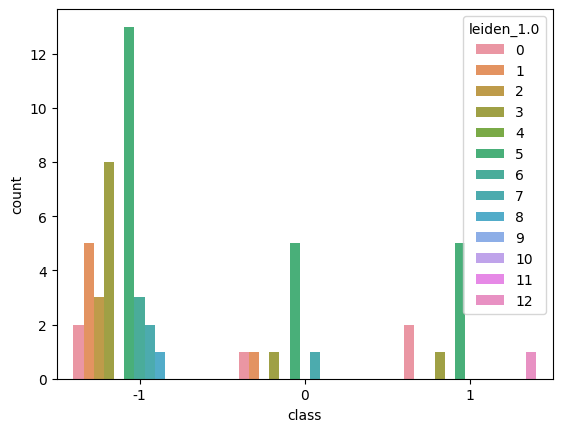

In [65]:
sns.countplot(x="class", data=df, hue="leiden_1.0")

<Axes: xlabel='leiden_1.0', ylabel='count'>

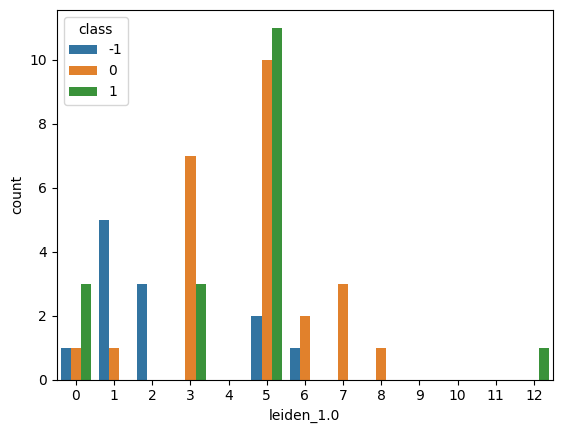

In [68]:
sns.countplot(x="leiden_1.0", data=df, hue="class")

[Text(0, 0, 'M2'),
 Text(1, 0, 'M3'),
 Text(2, 0, 'M6'),
 Text(3, 0, 'M9'),
 Text(4, 0, 'M12'),
 Text(5, 0, 'M12_normalB'),
 Text(6, 0, 'M18'),
 Text(7, 0, 'd28'),
 Text(8, 0, 'normal'),
 Text(9, 0, 'normal_CD5'),
 Text(10, 0, 'pre'),
 Text(11, 0, 'pre_normalB')]

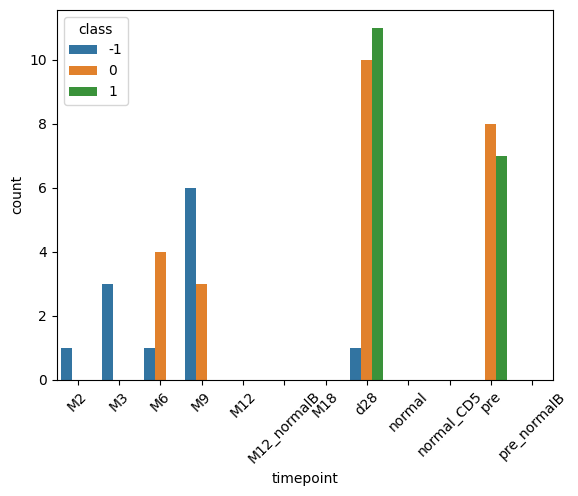

In [72]:
ax = sns.countplot(x="timepoint", data=df, hue="class")
ax.set_xticklabels(ax.get_xticklabels(), rotation=45)

[Text(0, 0, 'M2'),
 Text(1, 0, 'M3'),
 Text(2, 0, 'M6'),
 Text(3, 0, 'M9'),
 Text(4, 0, 'M12'),
 Text(5, 0, 'M12_normalB'),
 Text(6, 0, 'M18'),
 Text(7, 0, 'd28'),
 Text(8, 0, 'normal'),
 Text(9, 0, 'normal_CD5'),
 Text(10, 0, 'pre'),
 Text(11, 0, 'pre_normalB')]

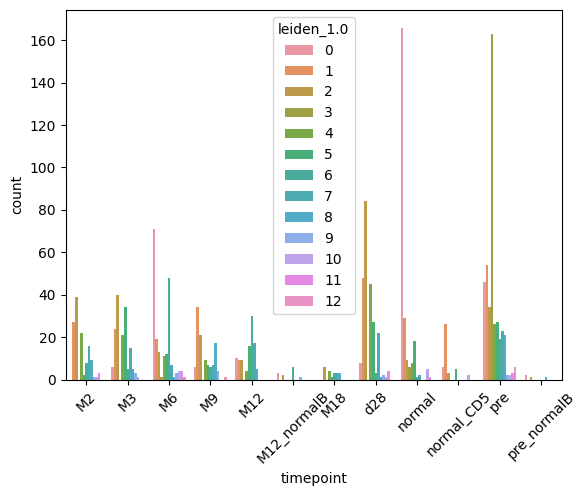

In [74]:
ax = sns.countplot(x="timepoint", data=adata.obs, hue="leiden_1.0")
ax.set_xticklabels(ax.get_xticklabels(), rotation=45)